<a href="https://colab.research.google.com/github/nizar20172016/My-Projects/blob/master/andOrGates.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from torch.nn.parameter import Parameter

In [162]:
def gen_data(num_samples, noise=0):
  points = []
  labels = []

  for i in range(num_samples):
    x = np.random.uniform()
    y = np.random.uniform()
    
    nx = np.random.uniform(low=-noise/100, high=noise/100)
    ny = np.random.uniform(low=-noise/100, high=noise/100)

    if(-0.3*x-y +0.4 > 0 or -0.3*x-y +0.9 < 0 ):
        if noise > 0:
            points.append([x+nx, y+ny, 0])
            labels.append(0)
        else:
            points.append([x, y, 0])
            labels.append(0)
    elif(7.7*x-2.0 > 0 and 7.7*x-3.5<0 and -0.3*x-y +0.5 < 0 and -0.3*x-y +0.8 > 0  ):
        if noise > 0:
            points.append([x+nx, y+ny, 0])
            labels.append(0)
        else:
            points.append([x, y, 0])
            labels.append(0)
    else:
        if noise > 0:
            points.append([x+nx, y+ny, 1])
            labels.append(1)
        else:
            points.append([x, y, 1])
            labels.append(1)

  return points, labels

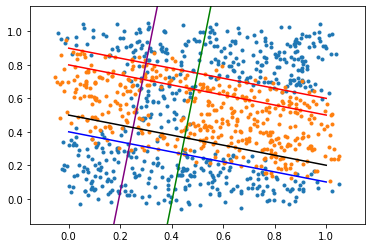

In [183]:
points, labels = gen_data(1000, 7)


plt.plot([i[0] for i in points if i[2] == 0], [i[1] for i in points if i[2] == 0], '.')
plt.plot([i[0] for i in points if i[2] == 1], [i[1] for i in points if i[2] == 1], '.')

# plot lines
x = torch.linspace(0,1)
plt.plot(x, (-0.3*x+0.4), 'blue')    # y = 0.9*x+0.1 => 0.9*x-y+0.1 < 0 
plt.plot(x, (-0.3*x+0.9), 'red')    # y = 0.9*x+0.1 => 0.9*x-y+0.1 < 0 
plt.plot(x, (7.7*x-3.1), 'green')    # y = 0.9*x+0.1 => 0.9*x-y+0.1 < 0 
plt.plot(x, (7.7*x-1.5), 'purple')    # y = 0.9*x+0.1 => 0.9*x-y+0.1 < 0 
plt.plot(x, (-0.3*x+0.5), 'black')    # y = 0.9*x+0.1 => 0.9*x-y+0.1 < 0 
plt.plot(x, (-0.3*x+0.8), 'red')    # y = 0.9*x+0.1 => 0.9*x-y+0.1 < 0 
plt.ylim(-0.15, 1.15)
plt.xlim(-0.15, 1.15)
plt.show()

In [164]:

class SquashingFunction(nn.Module):
    '''
    Shape:
        - Input: (N, *) where * means, any number of additional
          dimensions
        - Output: (N, *), same shape as the input
    Examples:
        m = squashing(beta=25)
        input = torch.randn(2)
        output = m(input)

        Input/Output have same shape:
        input.shape
        output.shape
    '''
    def __init__(self,learnable=True, beta=0.1):
        '''
        Init method.
        '''
        super(SquashingFunction, self).__init__()
        
        self.alpha = 0.5
        self.lam = 1.0
        
        if learnable:
            # initialize beta as learnable parameter
            self.beta = Parameter(torch.tensor(beta))
            self.beta.requiresGrad = True
        else:
            # static value
            self.beta = torch.tensor(beta)
            self.beta.requiresGrad = False
            
        self.beta.requiresGrad = True # set requiresGrad to true!

    def forward(self, x):
        '''
        Forward pass of the function.
        '''
        #print("Beta:", self.beta.data.item())
        # define beta global for pandas print
        global betas 
        betas = self.beta.data.item()
        return (1/(self.lam * self.beta)) * torch.log( (1+torch.exp(self.beta*(x-(self.alpha-(self.lam/2)))) ) / (1+torch.exp(self.beta*(x-(self.alpha+(self.lam/2))))) )

In [165]:
trainX = torch.Tensor([[i[0],i[1]] for i in points]).float()
trainY = torch.Tensor([[i[2]] for i in points]).float()

In [180]:
class SimpleNetwork(nn.Module):
    def __init__(self):
        super(SimpleNetwork, self).__init__()

        self.linear_layer_1 = nn.Linear(2, 1)
        self.linear_layer_2 = nn.Linear(2, 1)
        self.linear_layer_3 = nn.Linear(2, 1)
        self.linear_layer_4 = nn.Linear(2, 1)
        self.linear_layer_5 = nn.Linear(2, 1)
        self.linear_layer_6 = nn.Linear(2, 1)
        
        
        self.activation1 = SquashingFunction()


        #  Gates
       
        self.or_layer = nn.Linear(in_features=2, out_features=1)
        self.and_layer = nn.Linear(in_features=4, out_features=1)
        self.orOut_layer = nn.Linear(in_features=2, out_features=1)
        
        
        self.or_layer.weight.requires_grad = False
        self.or_layer.bias.requires_grad  = False

        self.and_layer.weight.requires_grad = False
        self.and_layer.bias.requires_grad  = False

        self.orOut_layer.weight.requires_grad = False
        self.orOut_layer.bias.requires_grad  = False
        
        with torch.no_grad():
            self.or_layer.weight.fill_(1.0)
            self.or_layer.bias.fill_(0.0)
            self.and_layer.bias.fill_(-3.0)
            self.and_layer.weight.fill_(1.0)
            self.orOut_layer.bias.fill_(0.0)
            self.orOut_layer.weight.fill_(1.0)
            
            
            



    def forward(self, X):
        self.z1 = self.linear_layer_1(X)
        self.z1 = self.activation1(self.z1)      # activation function

        self.z2 = self.linear_layer_2(X)
        self.z2 = self.activation1(self.z2)      # activation function
        
        self.z3 = self.linear_layer_3(X)
        self.z3 = self.activation1(self.z3)      # activation function

        self.z4 = self.linear_layer_4(X)
        self.z4 = self.activation1(self.z4)      # activation function
        
        self.z5 = self.linear_layer_5(X)
        self.z5 = self.activation1(self.z5)      # activation function

        self.z6 = self.linear_layer_6(X)
        self.z6 = self.activation1(self.z6)      # activation function
        global betaand
        global betagerade
        betagerade = betas
  
        
        
     

        self.or_ = self.or_layer(torch.cat((self.z1, self.z2), 1))
        self.or_ = self.activation1(self.or_)
        self.and_ = self.and_layer(torch.cat((self.z3,self.z4,self.z5,self.z6), 1))
        self.and_ = self.activation1(self.and_)
        self.or_out = self.orOut_layer(torch.cat((self.or_,self.and_), 1))
        self.or_out = self.activation1(self.or_out)
        betaand = betas

        
        return self.or_out


Beta-Gerade: 0.10000000149011612
Beta-AND: 0.10000000149011612


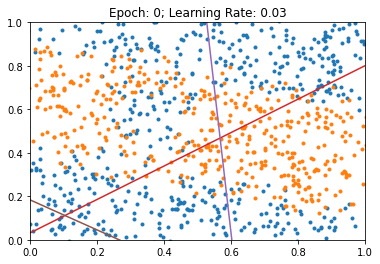

Beta-Gerade: 0.32899537682533264
Beta-AND: 0.32899537682533264


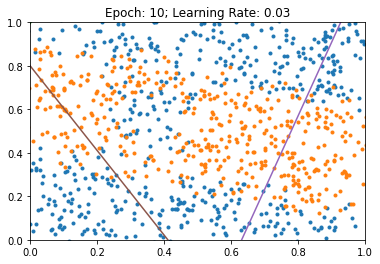

Beta-Gerade: 0.2614065706729889
Beta-AND: 0.2614065706729889


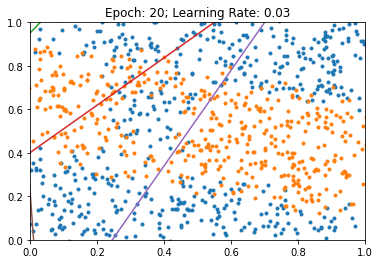

Beta-Gerade: 0.27031055092811584
Beta-AND: 0.27031055092811584


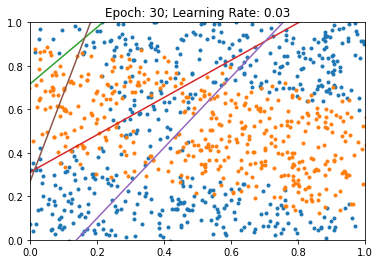

Beta-Gerade: 0.2988334894180298
Beta-AND: 0.2988334894180298


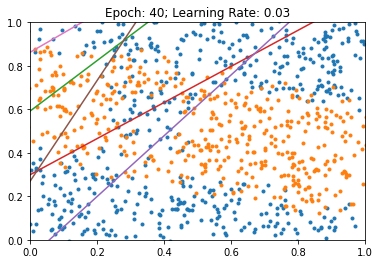

Beta-Gerade: 0.28265872597694397
Beta-AND: 0.28265872597694397


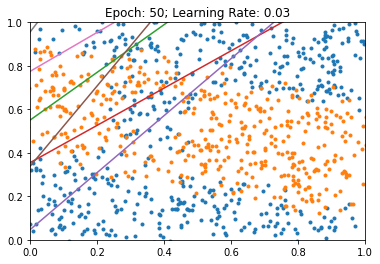

Beta-Gerade: 0.30311319231987
Beta-AND: 0.30311319231987


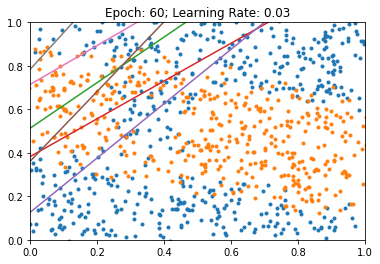

Beta-Gerade: 0.30703869462013245
Beta-AND: 0.30703869462013245


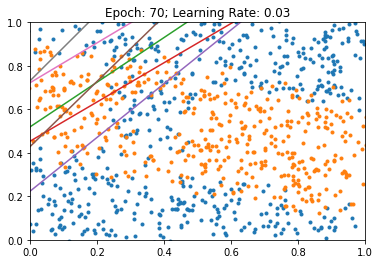

Beta-Gerade: 0.3207547664642334
Beta-AND: 0.3207547664642334


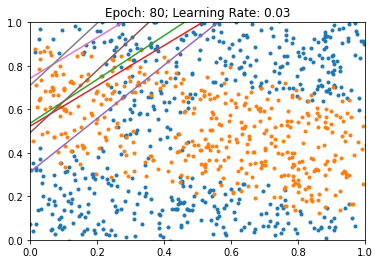

Beta-Gerade: 0.33922430872917175
Beta-AND: 0.33922430872917175


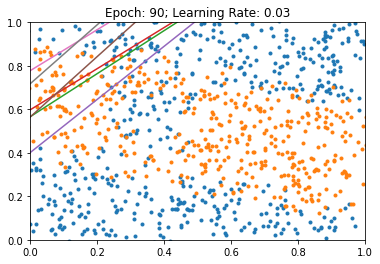

Beta-Gerade: 0.3608856201171875
Beta-AND: 0.3608856201171875


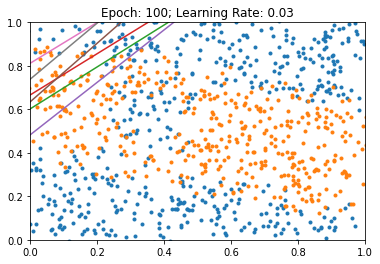

Beta-Gerade: 0.39273032546043396
Beta-AND: 0.39273032546043396


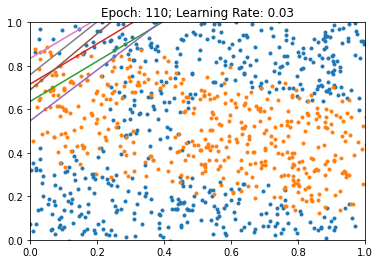

Beta-Gerade: 0.4323304295539856
Beta-AND: 0.4323304295539856


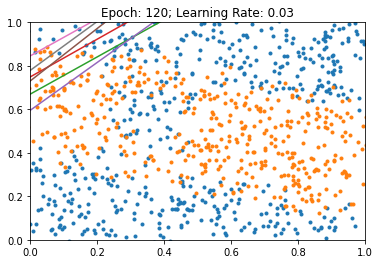

Beta-Gerade: 0.4856797456741333
Beta-AND: 0.4856797456741333


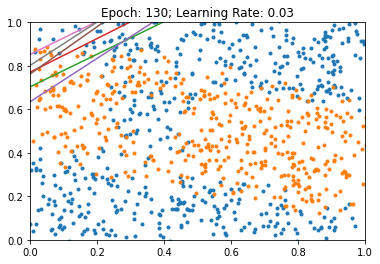

Beta-Gerade: 0.5894558429718018
Beta-AND: 0.5894558429718018


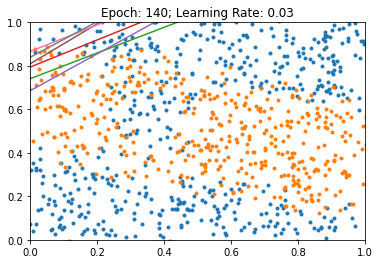

Beta-Gerade: 0.8961006999015808
Beta-AND: 0.8961006999015808


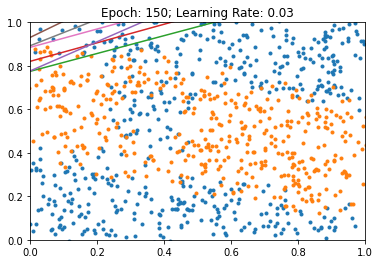

Beta-Gerade: 1.4964685440063477
Beta-AND: 1.4964685440063477


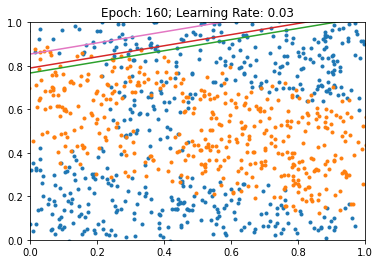

Beta-Gerade: 2.0333895683288574
Beta-AND: 2.0333895683288574


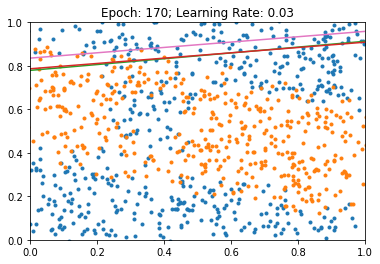

Beta-Gerade: 2.2511894702911377
Beta-AND: 2.2511894702911377


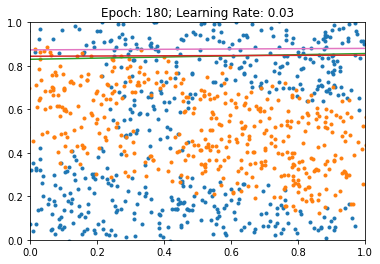

Beta-Gerade: 2.426124334335327
Beta-AND: 2.426124334335327


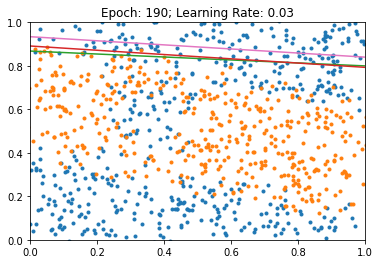

Beta-Gerade: 2.625788688659668
Beta-AND: 2.625788688659668


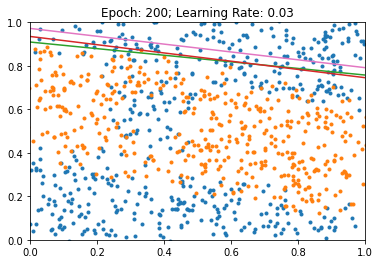

Beta-Gerade: 2.74780011177063
Beta-AND: 2.74780011177063


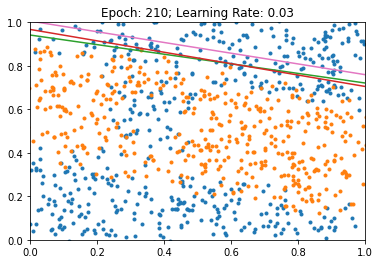

Beta-Gerade: 2.7747952938079834
Beta-AND: 2.7747952938079834


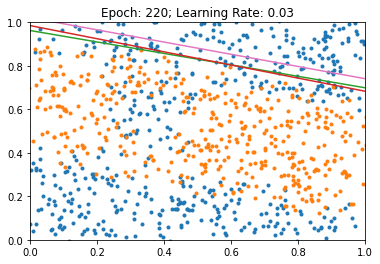

Beta-Gerade: 2.7505719661712646
Beta-AND: 2.7505719661712646


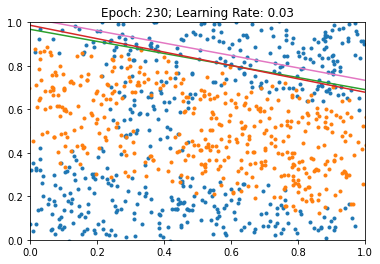

Beta-Gerade: 2.7318999767303467
Beta-AND: 2.7318999767303467


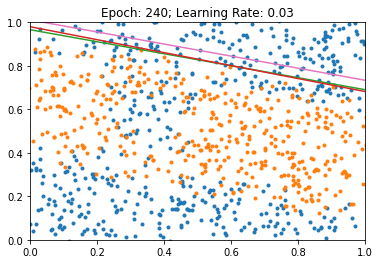

Beta-Gerade: 2.725128412246704
Beta-AND: 2.725128412246704


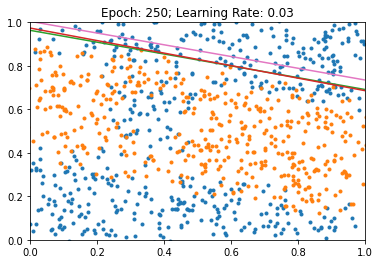

Beta-Gerade: 2.713859796524048
Beta-AND: 2.713859796524048


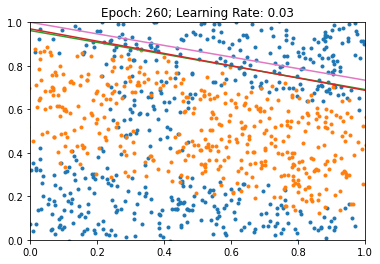

Beta-Gerade: 2.702641010284424
Beta-AND: 2.702641010284424


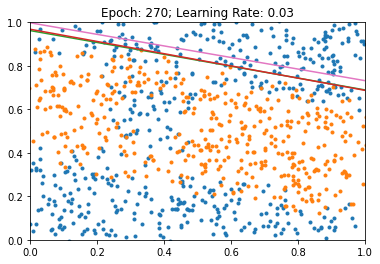

Beta-Gerade: 2.696535587310791
Beta-AND: 2.696535587310791


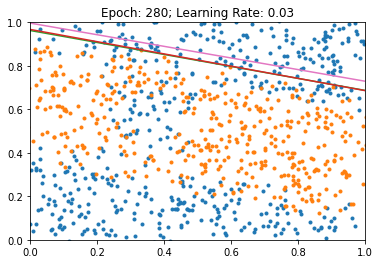

Beta-Gerade: 2.690742015838623
Beta-AND: 2.690742015838623


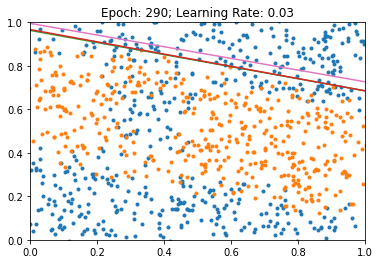

Beta-Gerade: 2.683901309967041
Beta-AND: 2.683901309967041


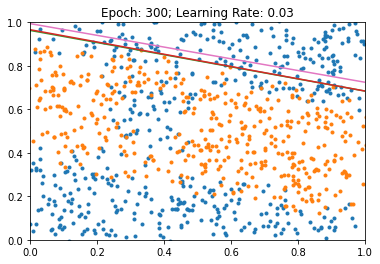

Beta-Gerade: 2.677809238433838
Beta-AND: 2.677809238433838


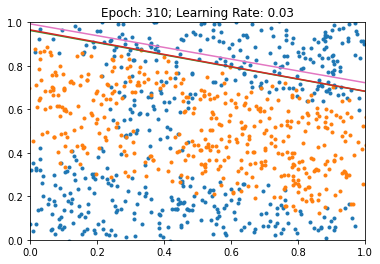

Beta-Gerade: 2.67215895652771
Beta-AND: 2.67215895652771


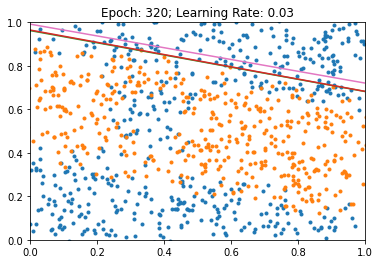

Beta-Gerade: 2.666513681411743
Beta-AND: 2.666513681411743


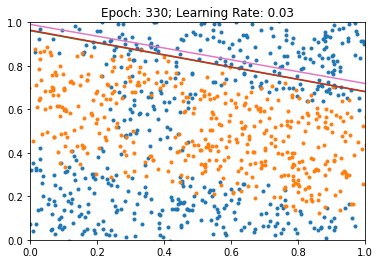

Beta-Gerade: 2.6612467765808105
Beta-AND: 2.6612467765808105


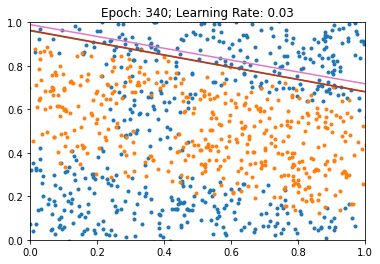

Beta-Gerade: 2.6563262939453125
Beta-AND: 2.6563262939453125


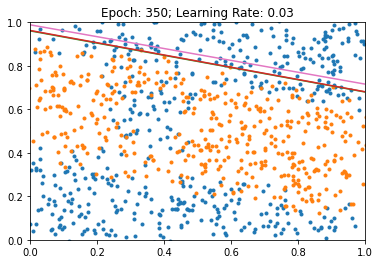

Beta-Gerade: 2.65159010887146
Beta-AND: 2.65159010887146


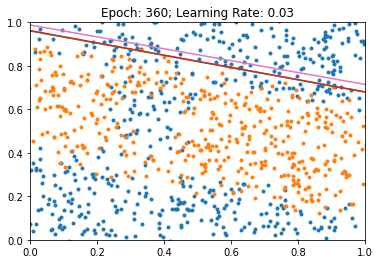

Beta-Gerade: 2.6470839977264404
Beta-AND: 2.6470839977264404


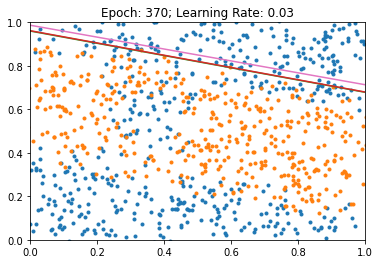

Beta-Gerade: 2.6427931785583496
Beta-AND: 2.6427931785583496


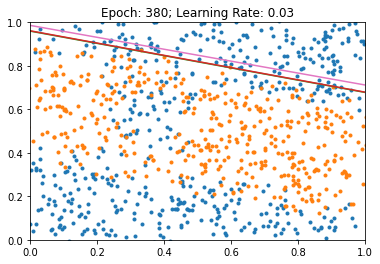

Beta-Gerade: 2.638669490814209
Beta-AND: 2.638669490814209


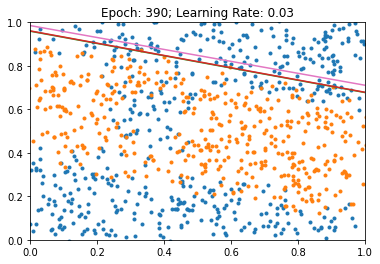

Beta-Gerade: 2.6347174644470215
Beta-AND: 2.6347174644470215


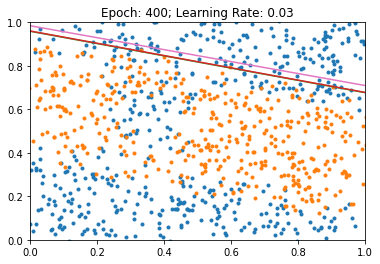

Beta-Gerade: 2.6309244632720947
Beta-AND: 2.6309244632720947


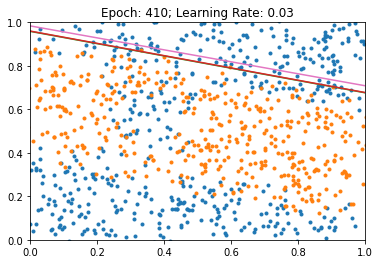

Beta-Gerade: 2.6272740364074707
Beta-AND: 2.6272740364074707


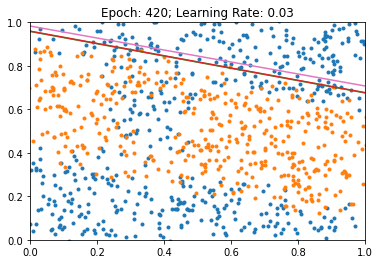

Beta-Gerade: 2.6237571239471436
Beta-AND: 2.6237571239471436


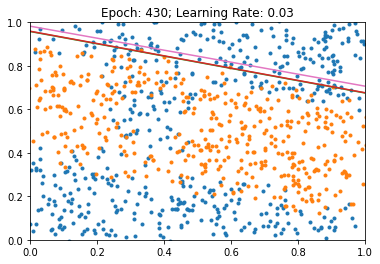

Beta-Gerade: 2.6203644275665283
Beta-AND: 2.6203644275665283


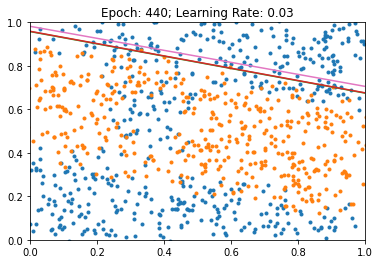

Beta-Gerade: 2.6170809268951416
Beta-AND: 2.6170809268951416


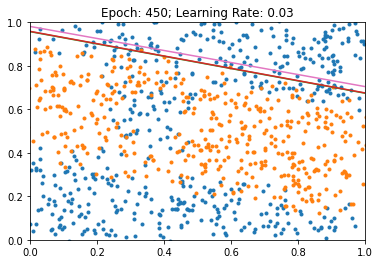

Beta-Gerade: 2.6138932704925537
Beta-AND: 2.6138932704925537


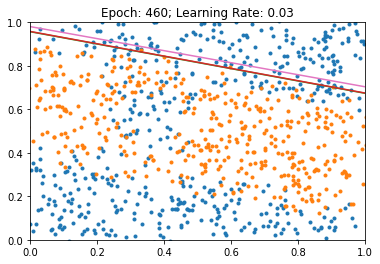

Beta-Gerade: 2.6107819080352783
Beta-AND: 2.6107819080352783


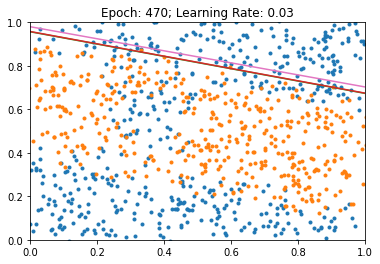

Beta-Gerade: 2.6077027320861816
Beta-AND: 2.6077027320861816


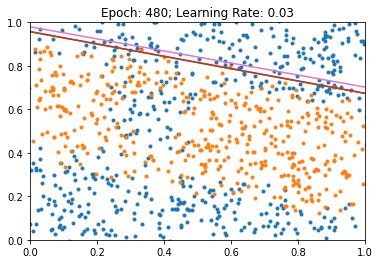

Beta-Gerade: 2.604555606842041
Beta-AND: 2.604555606842041


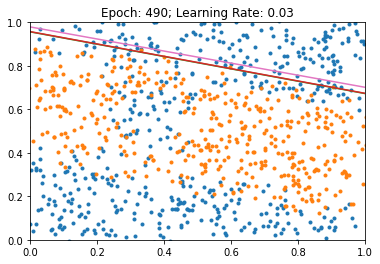

Beta-Gerade: 2.6009361743927
Beta-AND: 2.6009361743927


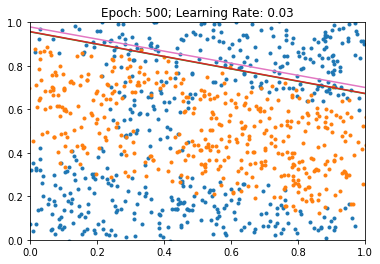

Beta-Gerade: 2.594264507293701
Beta-AND: 2.594264507293701


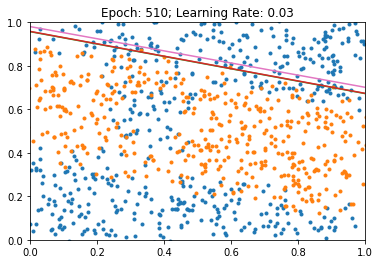

Beta-Gerade: 2.5764803886413574
Beta-AND: 2.5764803886413574


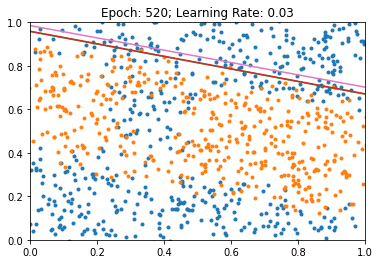

Beta-Gerade: 2.5753984451293945
Beta-AND: 2.5753984451293945


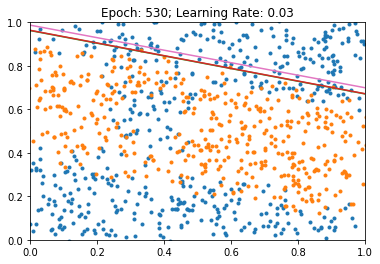

Beta-Gerade: 2.5562665462493896
Beta-AND: 2.5562665462493896


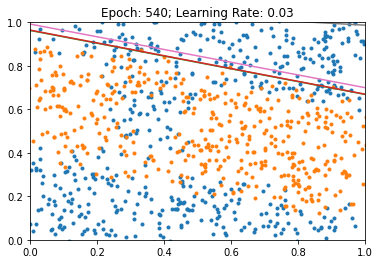

Beta-Gerade: 2.538423538208008
Beta-AND: 2.538423538208008


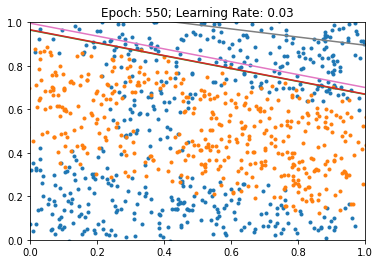

Beta-Gerade: 2.5306644439697266
Beta-AND: 2.5306644439697266


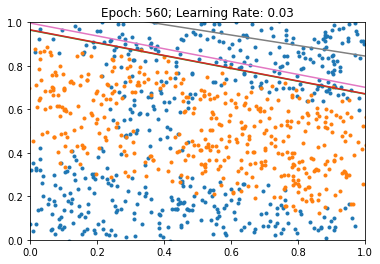

Beta-Gerade: 2.5222020149230957
Beta-AND: 2.5222020149230957


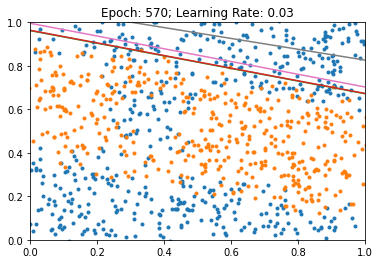

Beta-Gerade: 2.5146381855010986
Beta-AND: 2.5146381855010986


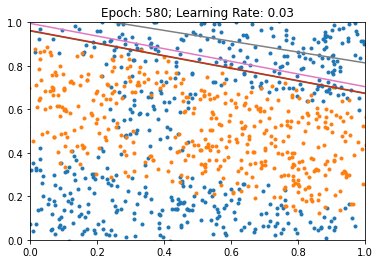

Beta-Gerade: 2.508418321609497
Beta-AND: 2.508418321609497


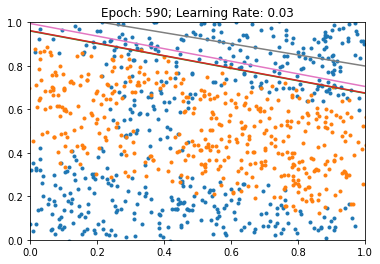

Beta-Gerade: 2.502737045288086
Beta-AND: 2.502737045288086


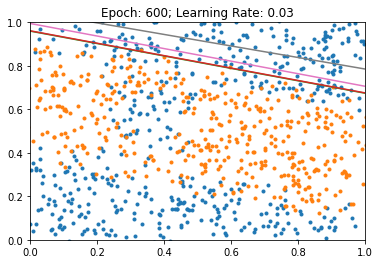

Beta-Gerade: 2.4978837966918945
Beta-AND: 2.4978837966918945


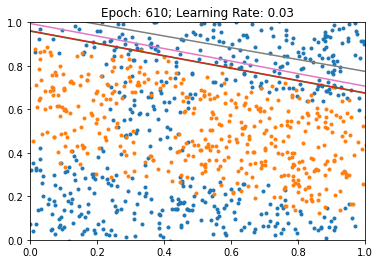

Beta-Gerade: 2.4933412075042725
Beta-AND: 2.4933412075042725


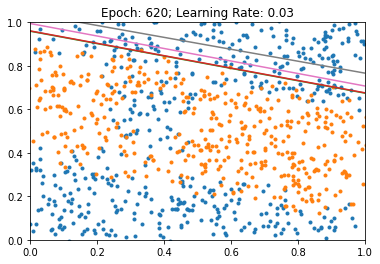

Beta-Gerade: 2.4890832901000977
Beta-AND: 2.4890832901000977


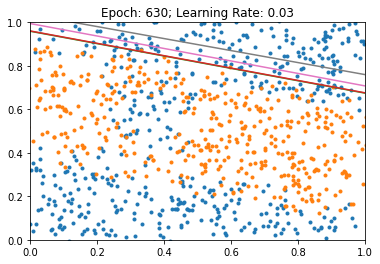

Beta-Gerade: 2.4852516651153564
Beta-AND: 2.4852516651153564


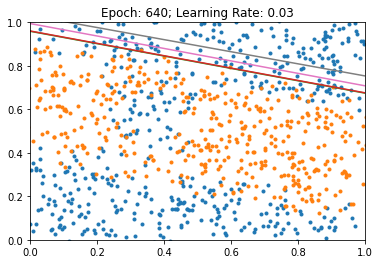

Beta-Gerade: 2.4816668033599854
Beta-AND: 2.4816668033599854


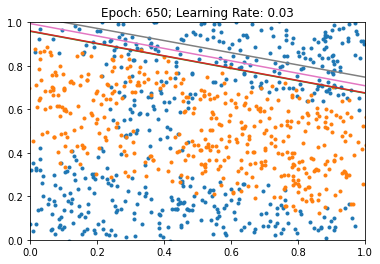

Beta-Gerade: 2.4783360958099365
Beta-AND: 2.4783360958099365


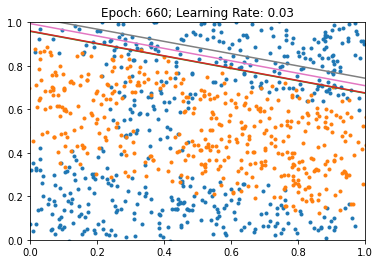

Beta-Gerade: 2.475192070007324
Beta-AND: 2.475192070007324


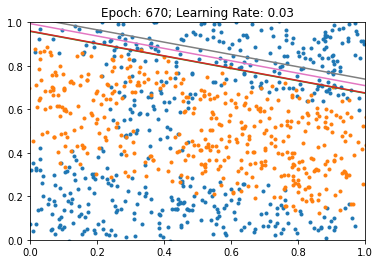

Beta-Gerade: 2.472222328186035
Beta-AND: 2.472222328186035


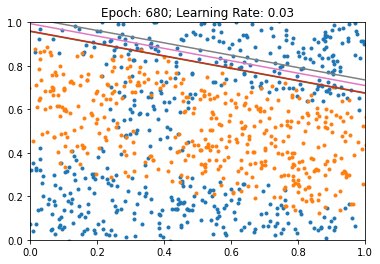

Beta-Gerade: 2.4694204330444336
Beta-AND: 2.4694204330444336


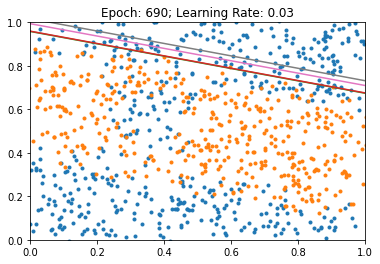

Beta-Gerade: 2.4667599201202393
Beta-AND: 2.4667599201202393


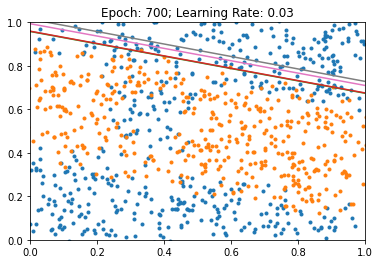

Beta-Gerade: 2.4642274379730225
Beta-AND: 2.4642274379730225


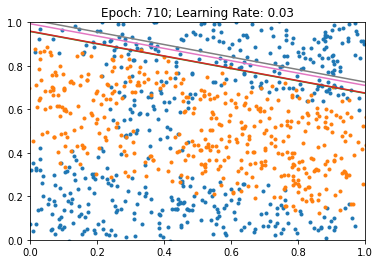

Beta-Gerade: 2.4618115425109863
Beta-AND: 2.4618115425109863


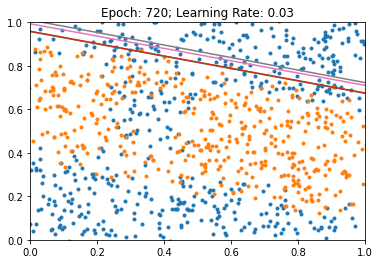

Beta-Gerade: 2.459498882293701
Beta-AND: 2.459498882293701


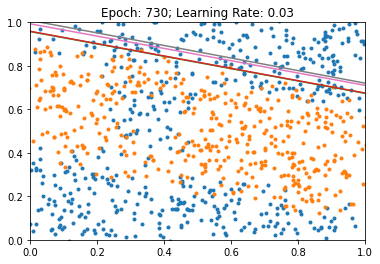

Beta-Gerade: 2.457282543182373
Beta-AND: 2.457282543182373


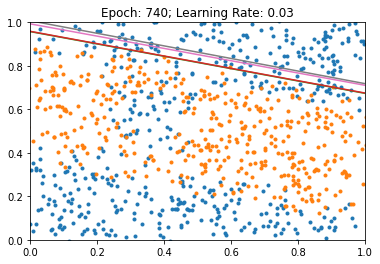

Beta-Gerade: 2.455155372619629
Beta-AND: 2.455155372619629


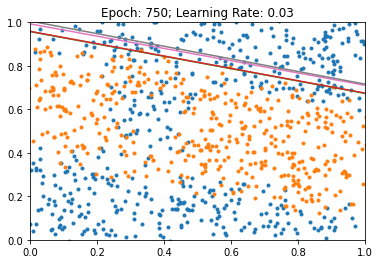

Beta-Gerade: 2.4531071186065674
Beta-AND: 2.4531071186065674


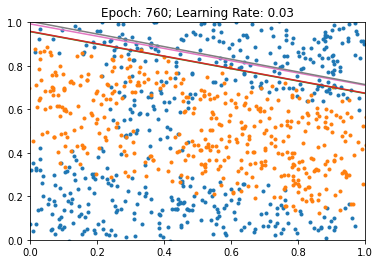

Beta-Gerade: 2.4511337280273438
Beta-AND: 2.4511337280273438


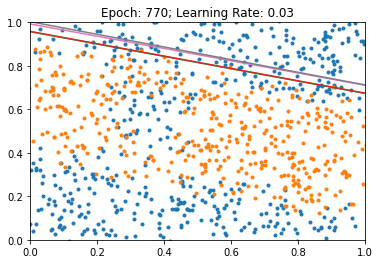

Beta-Gerade: 2.449228525161743
Beta-AND: 2.449228525161743


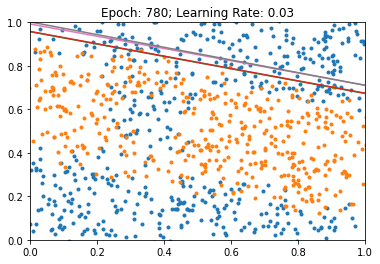

Beta-Gerade: 2.447389841079712
Beta-AND: 2.447389841079712


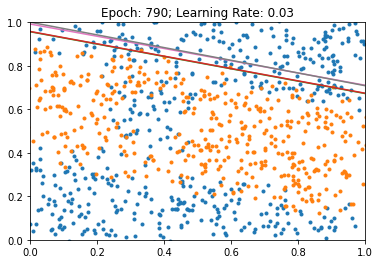

Beta-Gerade: 2.4456071853637695
Beta-AND: 2.4456071853637695


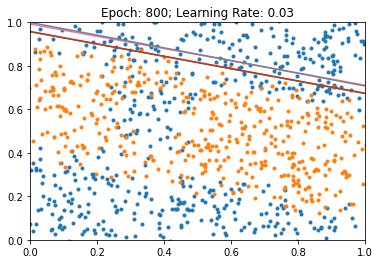

Beta-Gerade: 2.443882942199707
Beta-AND: 2.443882942199707


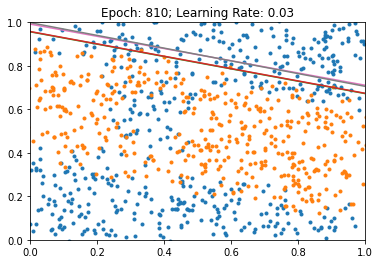

Beta-Gerade: 2.4422082901000977
Beta-AND: 2.4422082901000977


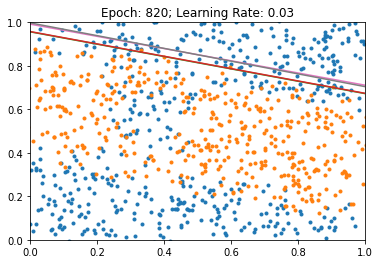

Beta-Gerade: 2.4405837059020996
Beta-AND: 2.4405837059020996


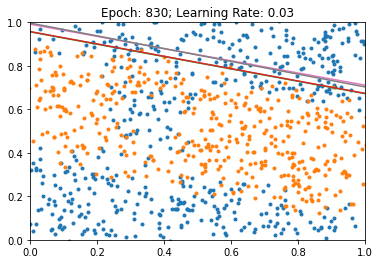

Beta-Gerade: 2.43900465965271
Beta-AND: 2.43900465965271


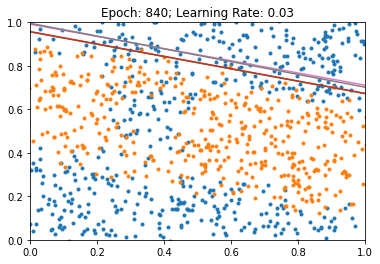

Beta-Gerade: 2.437469244003296
Beta-AND: 2.437469244003296


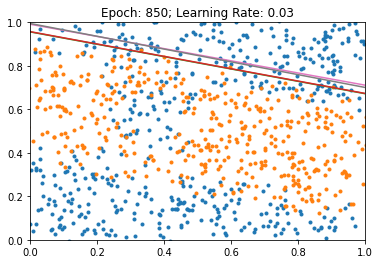

Beta-Gerade: 2.43597412109375
Beta-AND: 2.43597412109375


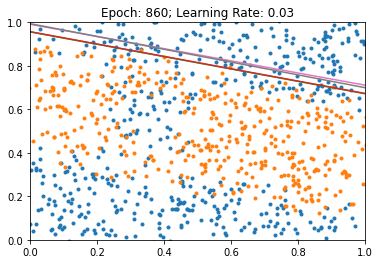

Beta-Gerade: 2.4345197677612305
Beta-AND: 2.4345197677612305


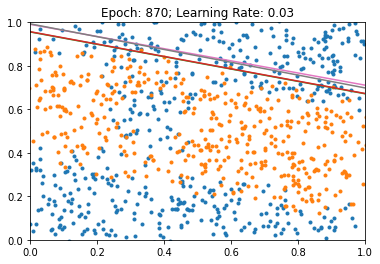

Beta-Gerade: 2.4330966472625732
Beta-AND: 2.4330966472625732


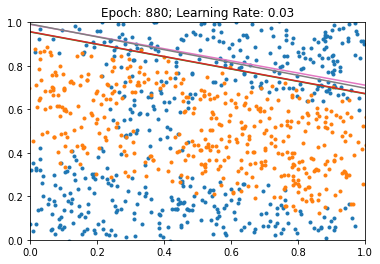

Beta-Gerade: 2.4317128658294678
Beta-AND: 2.4317128658294678


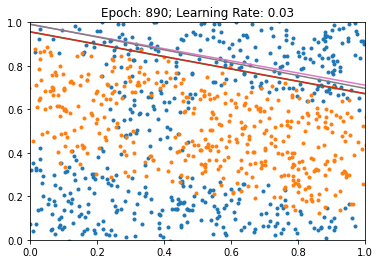

Beta-Gerade: 2.4303600788116455
Beta-AND: 2.4303600788116455


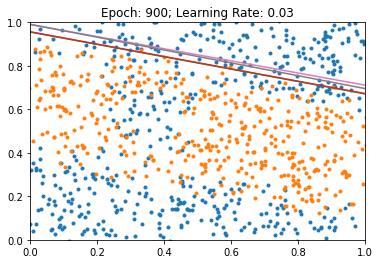

Beta-Gerade: 2.4290385246276855
Beta-AND: 2.4290385246276855


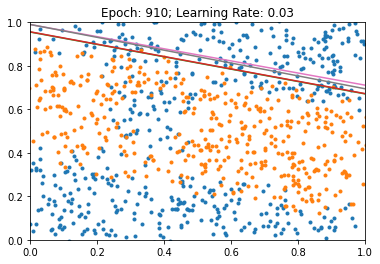

Beta-Gerade: 2.427746534347534
Beta-AND: 2.427746534347534


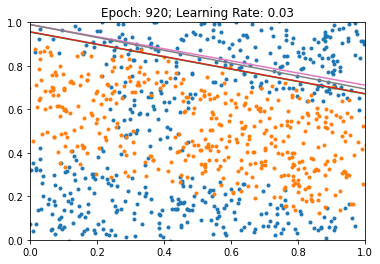

Beta-Gerade: 2.426485061645508
Beta-AND: 2.426485061645508


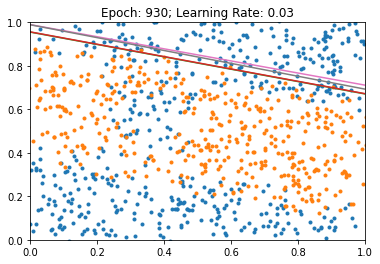

Beta-Gerade: 2.425246000289917
Beta-AND: 2.425246000289917


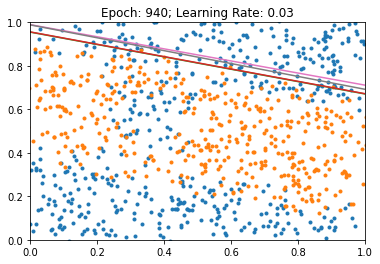

Beta-Gerade: 2.4240410327911377
Beta-AND: 2.4240410327911377


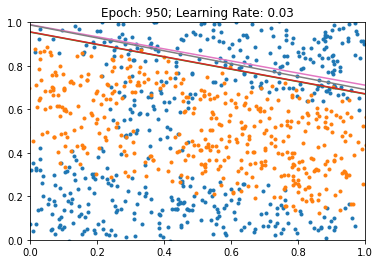

Beta-Gerade: 2.4228529930114746
Beta-AND: 2.4228529930114746


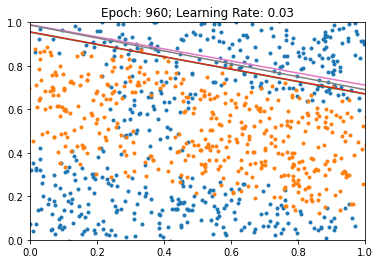

Beta-Gerade: 2.4216928482055664
Beta-AND: 2.4216928482055664


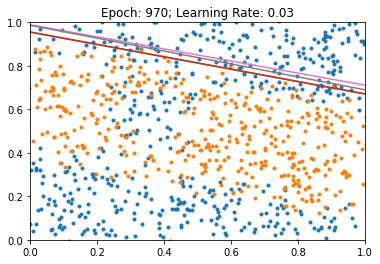

Beta-Gerade: 2.4205539226531982
Beta-AND: 2.4205539226531982


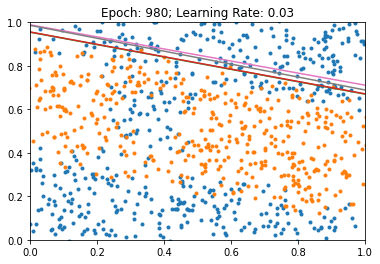

Beta-Gerade: 2.4194393157958984
Beta-AND: 2.4194393157958984


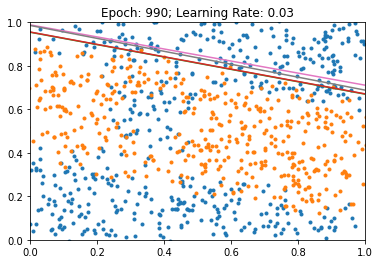

Beta-Gerade: 2.418341875076294
Beta-AND: 2.418341875076294


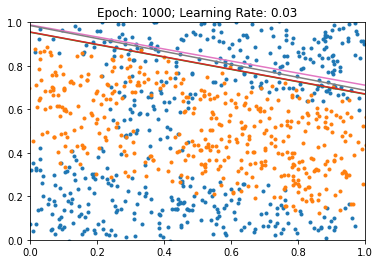

Beta-Gerade: 2.4172708988189697
Beta-AND: 2.4172708988189697


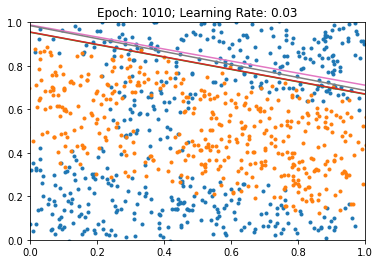

Beta-Gerade: 2.416212558746338
Beta-AND: 2.416212558746338


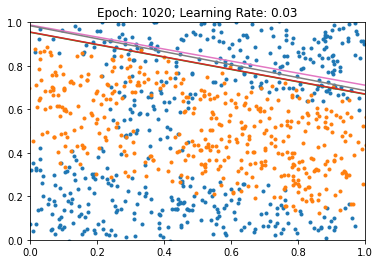

Beta-Gerade: 2.4151792526245117
Beta-AND: 2.4151792526245117


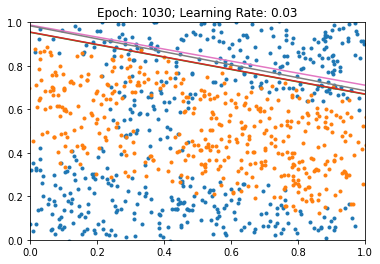

Beta-Gerade: 2.41416072845459
Beta-AND: 2.41416072845459


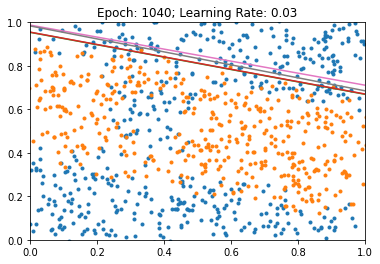

Beta-Gerade: 2.413161039352417
Beta-AND: 2.413161039352417


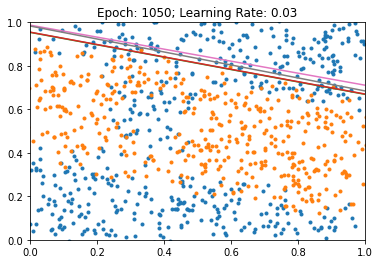

Beta-Gerade: 2.4121804237365723
Beta-AND: 2.4121804237365723


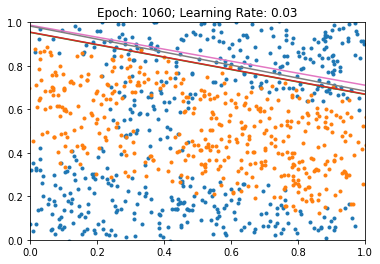

Beta-Gerade: 2.4112117290496826
Beta-AND: 2.4112117290496826


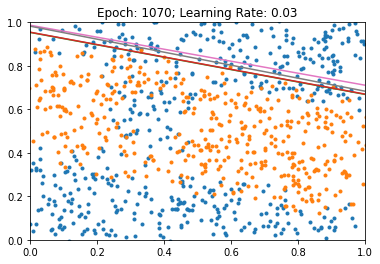

Beta-Gerade: 2.4102632999420166
Beta-AND: 2.4102632999420166


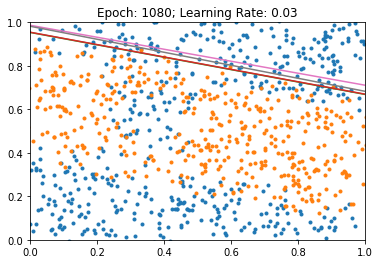

Beta-Gerade: 2.409327983856201
Beta-AND: 2.409327983856201


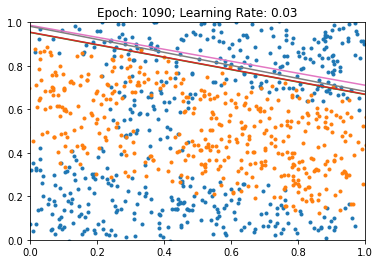

Beta-Gerade: 2.4084091186523438
Beta-AND: 2.4084091186523438


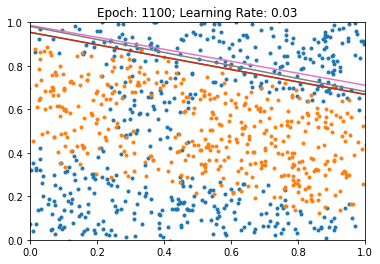

Beta-Gerade: 2.4075050354003906
Beta-AND: 2.4075050354003906


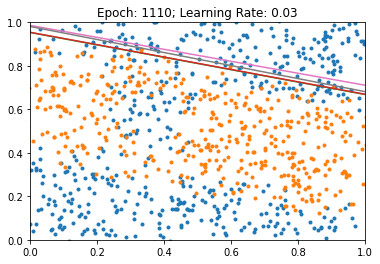

Beta-Gerade: 2.4066123962402344
Beta-AND: 2.4066123962402344


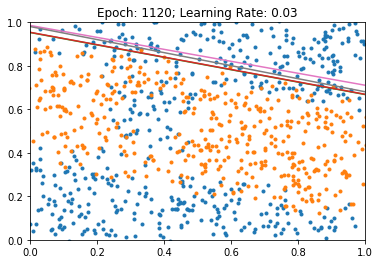

Beta-Gerade: 2.4057371616363525
Beta-AND: 2.4057371616363525


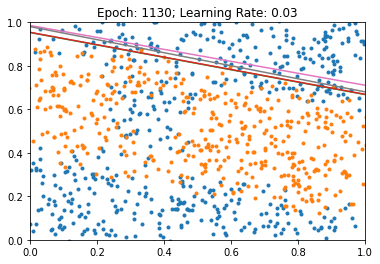

Beta-Gerade: 2.4048728942871094
Beta-AND: 2.4048728942871094


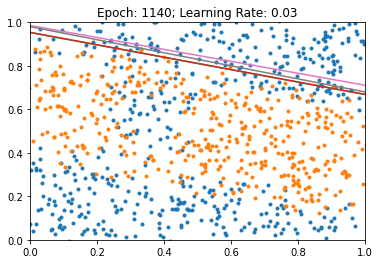

Beta-Gerade: 2.404022693634033
Beta-AND: 2.404022693634033


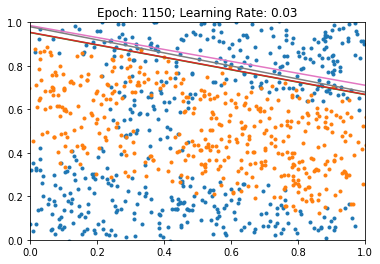

Beta-Gerade: 2.403186559677124
Beta-AND: 2.403186559677124


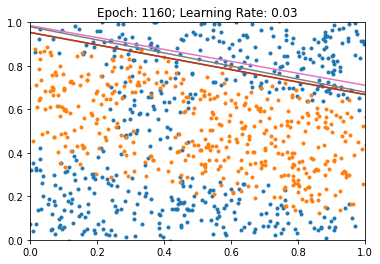

Beta-Gerade: 2.4023616313934326
Beta-AND: 2.4023616313934326


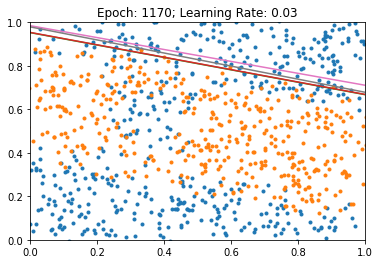

Beta-Gerade: 2.40154767036438
Beta-AND: 2.40154767036438


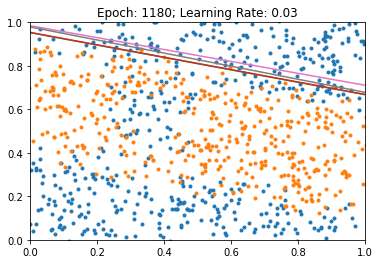

Beta-Gerade: 2.400745153427124
Beta-AND: 2.400745153427124


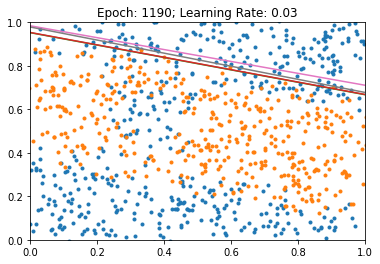

Beta-Gerade: 2.399956464767456
Beta-AND: 2.399956464767456


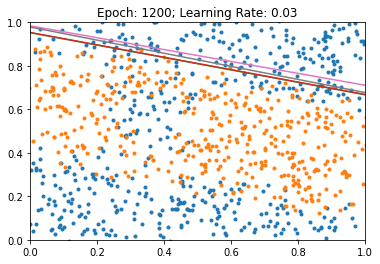

Beta-Gerade: 2.399176597595215
Beta-AND: 2.399176597595215


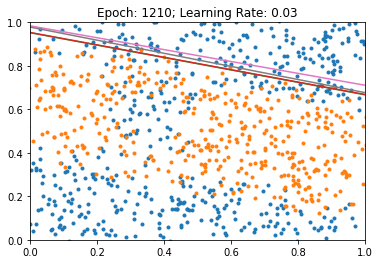

Beta-Gerade: 2.3984103202819824
Beta-AND: 2.3984103202819824


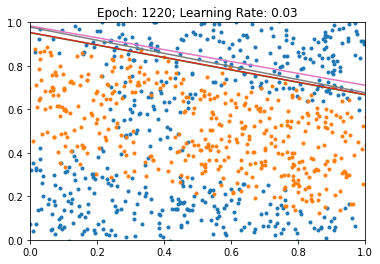

Beta-Gerade: 2.397653102874756
Beta-AND: 2.397653102874756


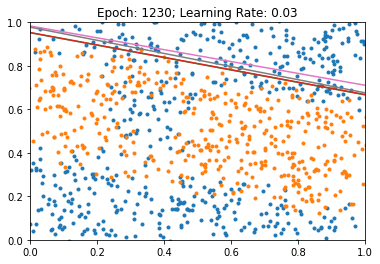

Beta-Gerade: 2.396904945373535
Beta-AND: 2.396904945373535


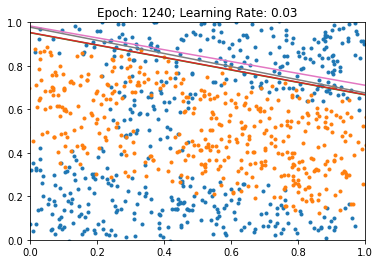

Beta-Gerade: 2.3961715698242188
Beta-AND: 2.3961715698242188


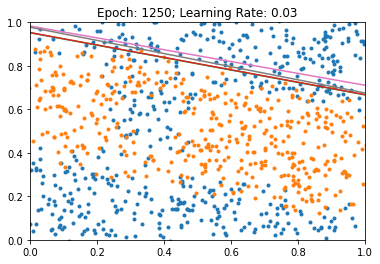

Beta-Gerade: 2.3954429626464844
Beta-AND: 2.3954429626464844


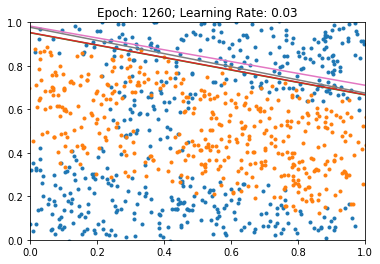

Beta-Gerade: 2.3947272300720215
Beta-AND: 2.3947272300720215


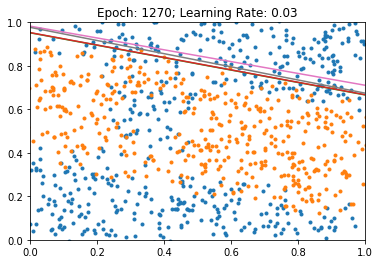

Beta-Gerade: 2.394019365310669
Beta-AND: 2.394019365310669


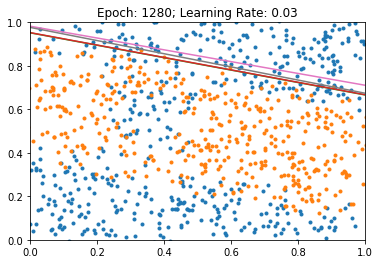

Beta-Gerade: 2.3933238983154297
Beta-AND: 2.3933238983154297


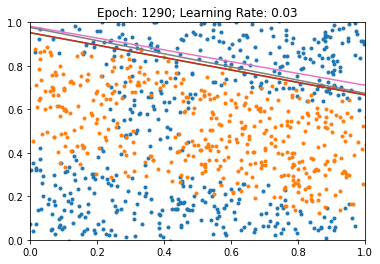

Beta-Gerade: 2.392634391784668
Beta-AND: 2.392634391784668


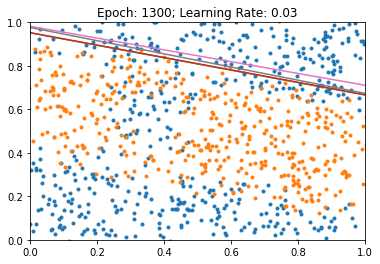

Beta-Gerade: 2.391956329345703
Beta-AND: 2.391956329345703


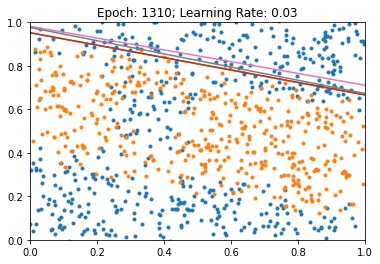

Beta-Gerade: 2.3912851810455322
Beta-AND: 2.3912851810455322


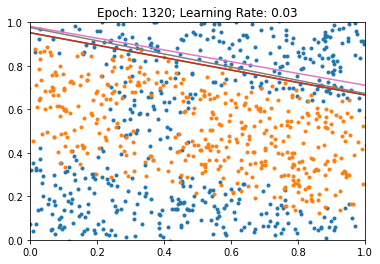

Beta-Gerade: 2.3906235694885254
Beta-AND: 2.3906235694885254


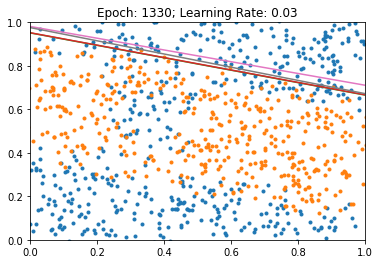

Beta-Gerade: 2.389972448348999
Beta-AND: 2.389972448348999


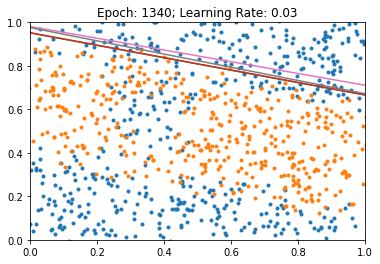

Beta-Gerade: 2.3893258571624756
Beta-AND: 2.3893258571624756


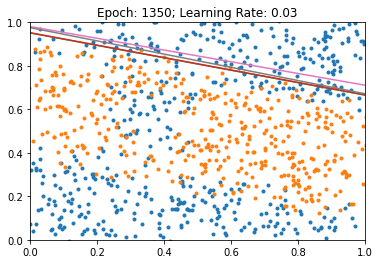

Beta-Gerade: 2.3886899948120117
Beta-AND: 2.3886899948120117


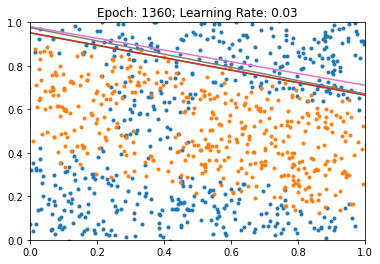

Beta-Gerade: 2.3880629539489746
Beta-AND: 2.3880629539489746


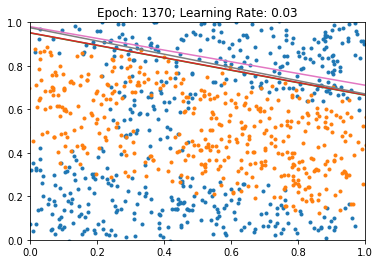

Beta-Gerade: 2.3874428272247314
Beta-AND: 2.3874428272247314


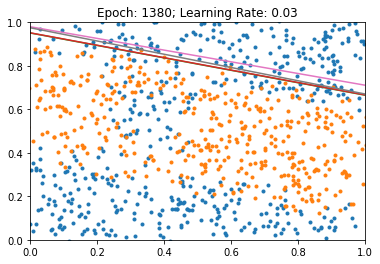

Beta-Gerade: 2.386831760406494
Beta-AND: 2.386831760406494


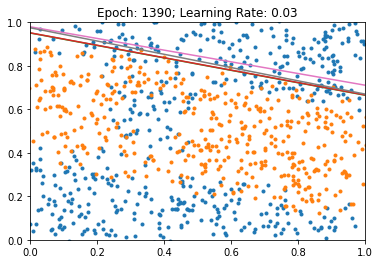

Beta-Gerade: 2.3862266540527344
Beta-AND: 2.3862266540527344


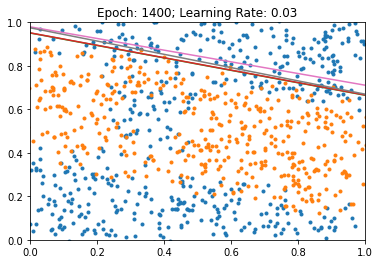

Beta-Gerade: 2.3856332302093506
Beta-AND: 2.3856332302093506


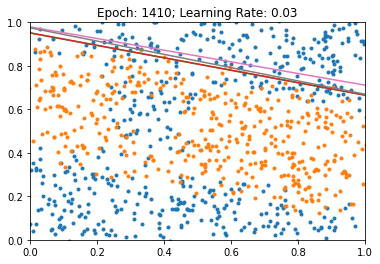

Beta-Gerade: 2.385040760040283
Beta-AND: 2.385040760040283


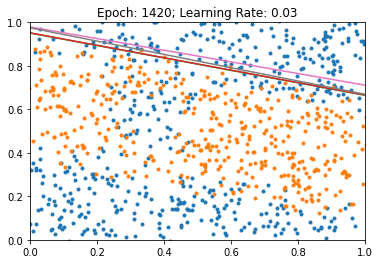

Beta-Gerade: 2.3844635486602783
Beta-AND: 2.3844635486602783


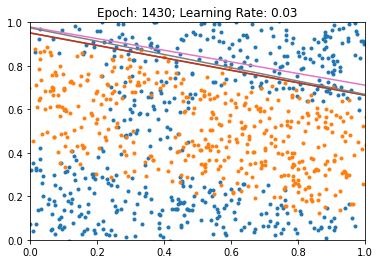

Beta-Gerade: 2.3838865756988525
Beta-AND: 2.3838865756988525


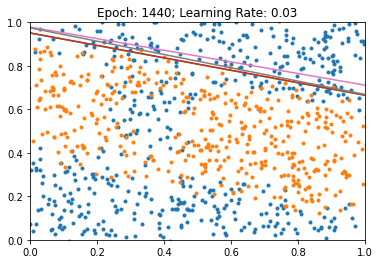

Beta-Gerade: 2.3833212852478027
Beta-AND: 2.3833212852478027


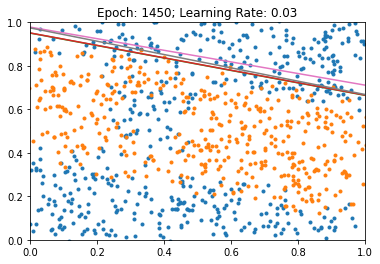

Beta-Gerade: 2.382763147354126
Beta-AND: 2.382763147354126


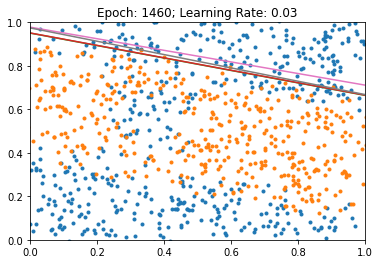

Beta-Gerade: 2.3822121620178223
Beta-AND: 2.3822121620178223


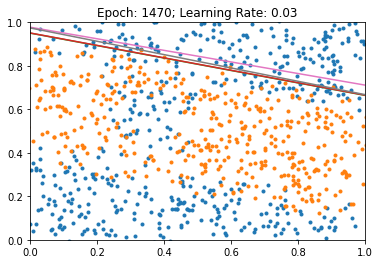

Beta-Gerade: 2.381666660308838
Beta-AND: 2.381666660308838


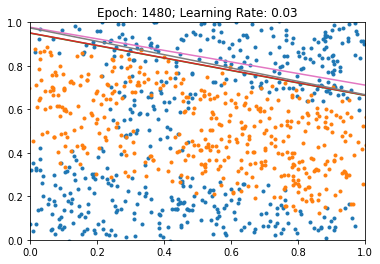

Beta-Gerade: 2.3811306953430176
Beta-AND: 2.3811306953430176


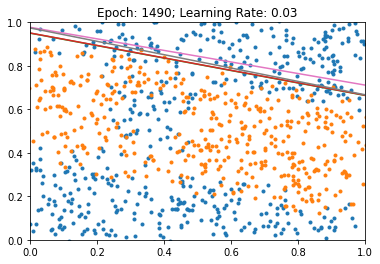

Beta-Gerade: 2.380601644515991
Beta-AND: 2.380601644515991


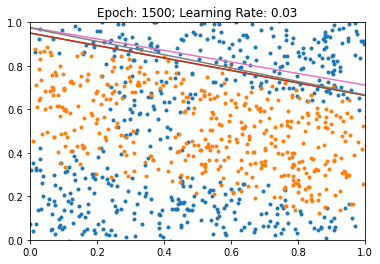

Beta-Gerade: 2.3800759315490723
Beta-AND: 2.3800759315490723


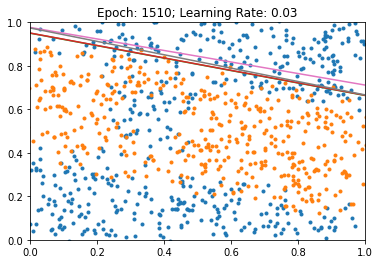

Beta-Gerade: 2.3795619010925293
Beta-AND: 2.3795619010925293


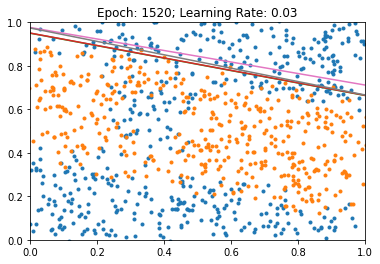

Beta-Gerade: 2.379051446914673
Beta-AND: 2.379051446914673


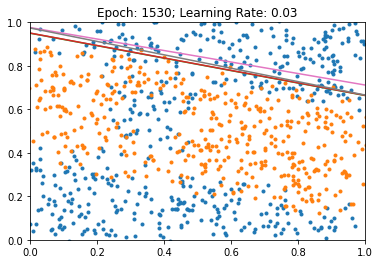

Beta-Gerade: 2.3785486221313477
Beta-AND: 2.3785486221313477


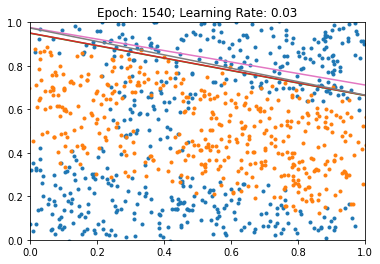

Beta-Gerade: 2.3780534267425537
Beta-AND: 2.3780534267425537


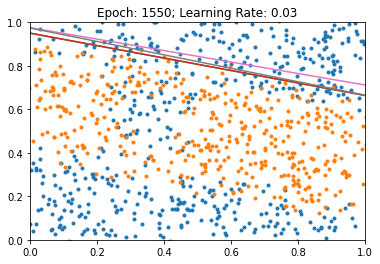

Beta-Gerade: 2.3775646686553955
Beta-AND: 2.3775646686553955


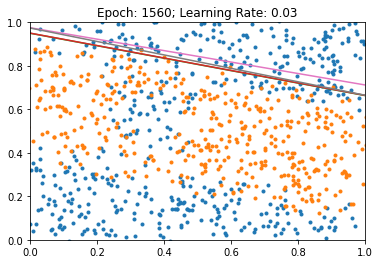

Beta-Gerade: 2.3770811557769775
Beta-AND: 2.3770811557769775


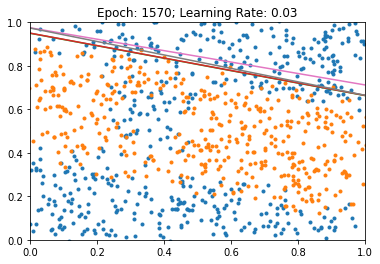

Beta-Gerade: 2.376607656478882
Beta-AND: 2.376607656478882


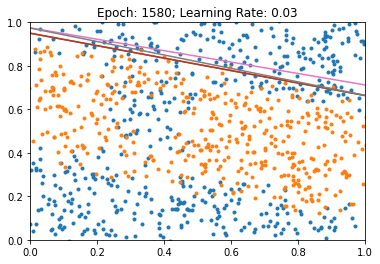

Beta-Gerade: 2.3761370182037354
Beta-AND: 2.3761370182037354


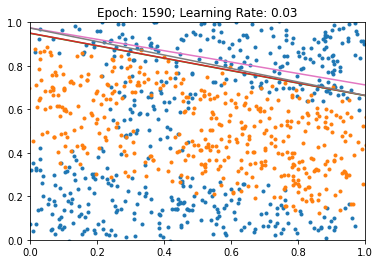

Beta-Gerade: 2.375674247741699
Beta-AND: 2.375674247741699


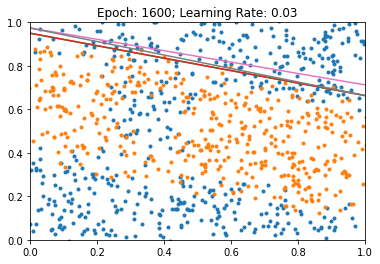

Beta-Gerade: 2.3752188682556152
Beta-AND: 2.3752188682556152


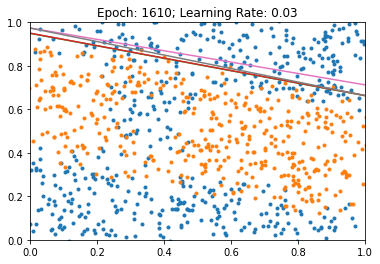

Beta-Gerade: 2.3747715950012207
Beta-AND: 2.3747715950012207


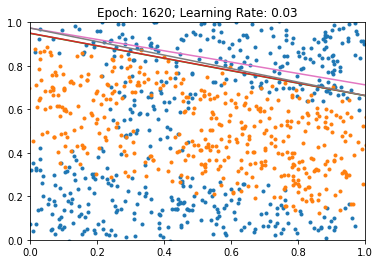

Beta-Gerade: 2.3743271827697754
Beta-AND: 2.3743271827697754


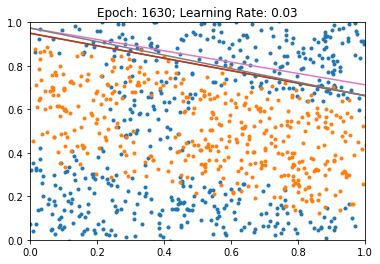

Beta-Gerade: 2.373891592025757
Beta-AND: 2.373891592025757


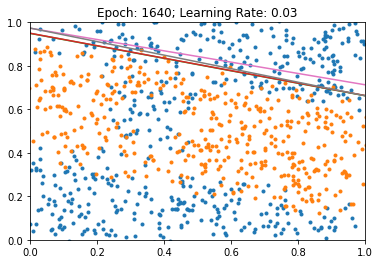

Beta-Gerade: 2.373464584350586
Beta-AND: 2.373464584350586


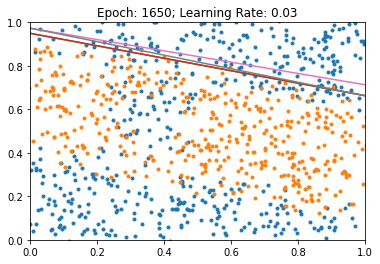

Beta-Gerade: 2.3730392456054688
Beta-AND: 2.3730392456054688


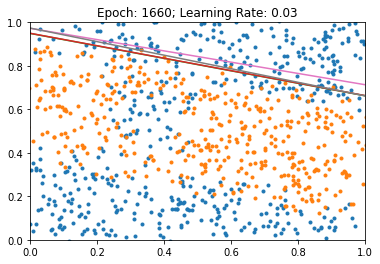

Beta-Gerade: 2.372622489929199
Beta-AND: 2.372622489929199


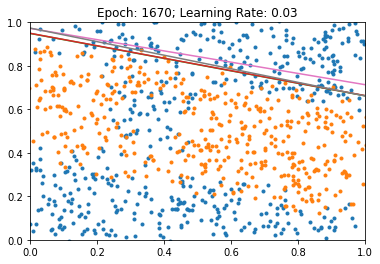

Beta-Gerade: 2.372218608856201
Beta-AND: 2.372218608856201


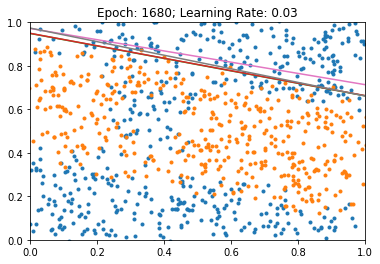

Beta-Gerade: 2.371811866760254
Beta-AND: 2.371811866760254


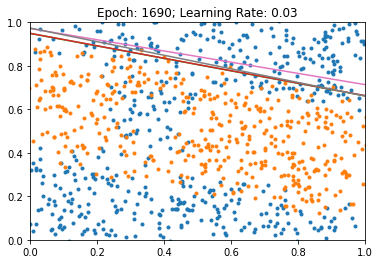

Beta-Gerade: 2.371417999267578
Beta-AND: 2.371417999267578


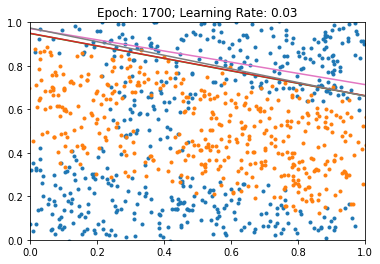

Beta-Gerade: 2.371030569076538
Beta-AND: 2.371030569076538


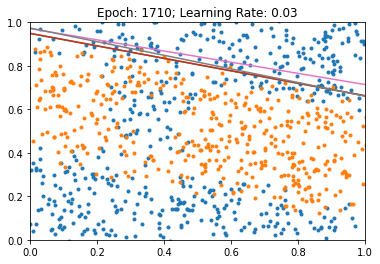

Beta-Gerade: 2.370643377304077
Beta-AND: 2.370643377304077


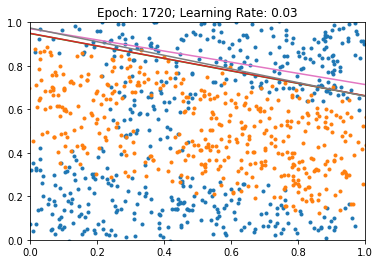

Beta-Gerade: 2.370269536972046
Beta-AND: 2.370269536972046


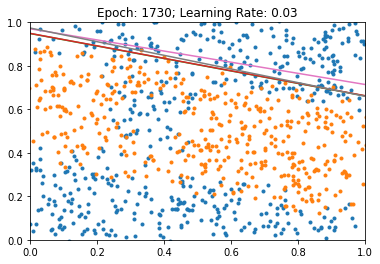

Beta-Gerade: 2.369900941848755
Beta-AND: 2.369900941848755


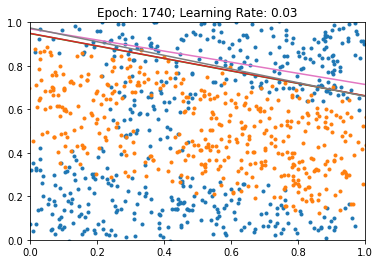

Beta-Gerade: 2.3695385456085205
Beta-AND: 2.3695385456085205


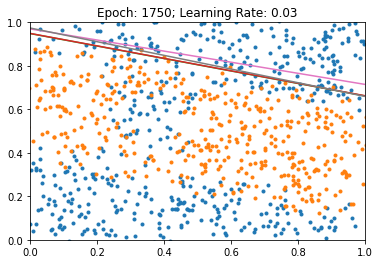

Beta-Gerade: 2.3691787719726562
Beta-AND: 2.3691787719726562


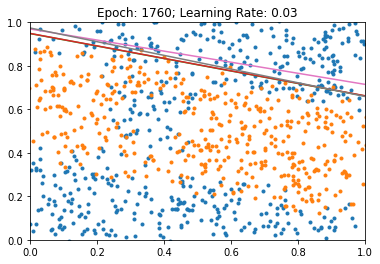

Beta-Gerade: 2.3688318729400635
Beta-AND: 2.3688318729400635


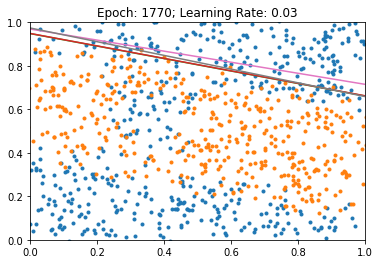

Beta-Gerade: 2.3684866428375244
Beta-AND: 2.3684866428375244


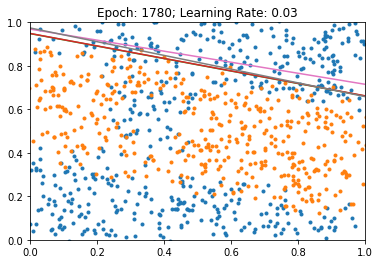

Beta-Gerade: 2.3681535720825195
Beta-AND: 2.3681535720825195


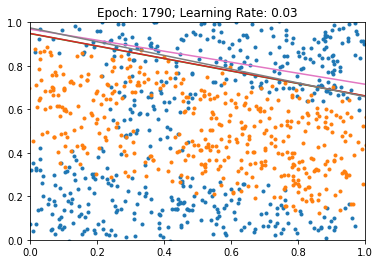

Beta-Gerade: 2.3678205013275146
Beta-AND: 2.3678205013275146


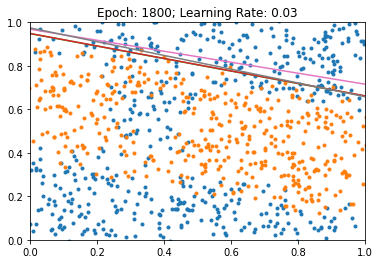

Beta-Gerade: 2.3675005435943604
Beta-AND: 2.3675005435943604


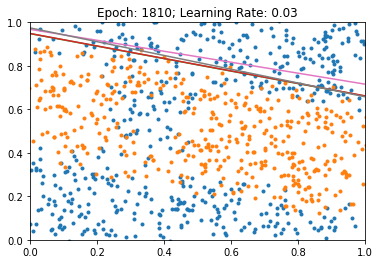

Beta-Gerade: 2.367182731628418
Beta-AND: 2.367182731628418


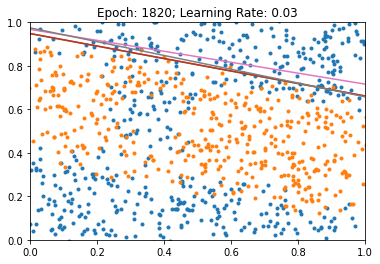

Beta-Gerade: 2.3668742179870605
Beta-AND: 2.3668742179870605


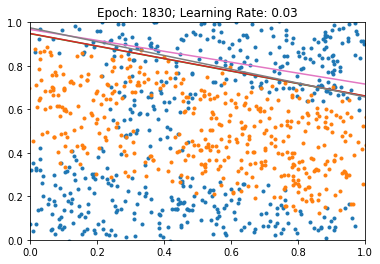

Beta-Gerade: 2.3665711879730225
Beta-AND: 2.3665711879730225


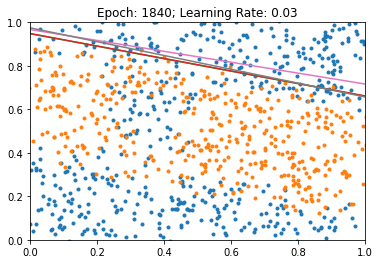

Beta-Gerade: 2.3662726879119873
Beta-AND: 2.3662726879119873


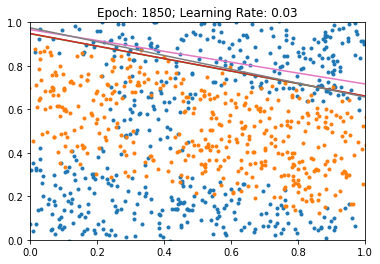

Beta-Gerade: 2.3659846782684326
Beta-AND: 2.3659846782684326


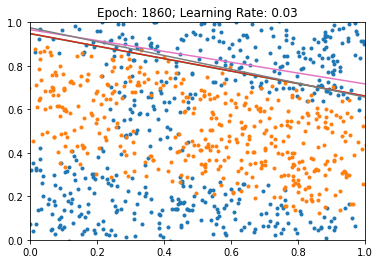

Beta-Gerade: 2.3656983375549316
Beta-AND: 2.3656983375549316


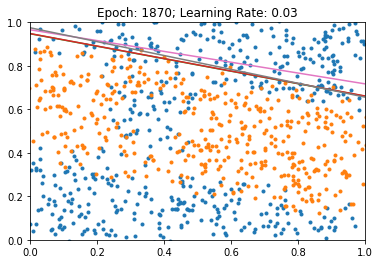

Beta-Gerade: 2.365419626235962
Beta-AND: 2.365419626235962


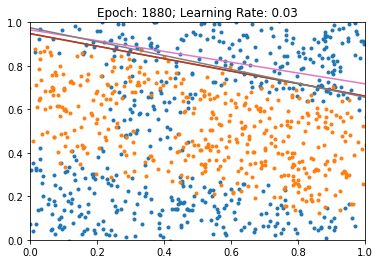

Beta-Gerade: 2.365151882171631
Beta-AND: 2.365151882171631


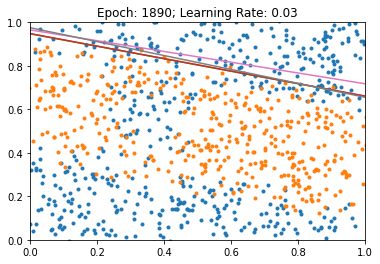

Beta-Gerade: 2.3648831844329834
Beta-AND: 2.3648831844329834


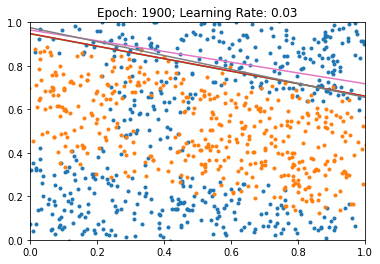

Beta-Gerade: 2.3646247386932373
Beta-AND: 2.3646247386932373


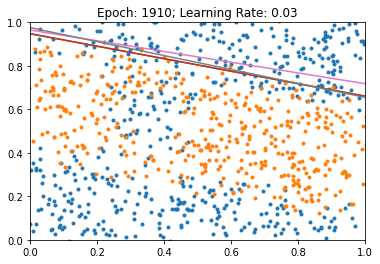

Beta-Gerade: 2.364372730255127
Beta-AND: 2.364372730255127


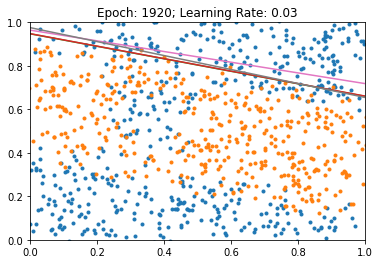

Beta-Gerade: 2.3641257286071777
Beta-AND: 2.3641257286071777


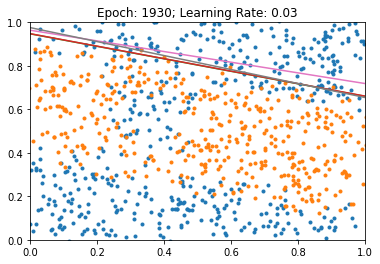

Beta-Gerade: 2.3638803958892822
Beta-AND: 2.3638803958892822


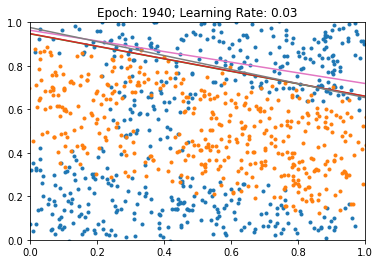

Beta-Gerade: 2.36364483833313
Beta-AND: 2.36364483833313


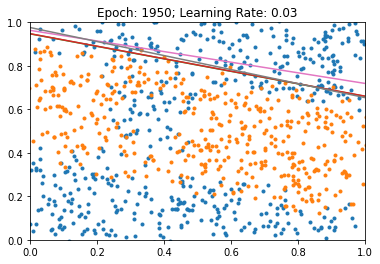

Beta-Gerade: 2.3634161949157715
Beta-AND: 2.3634161949157715


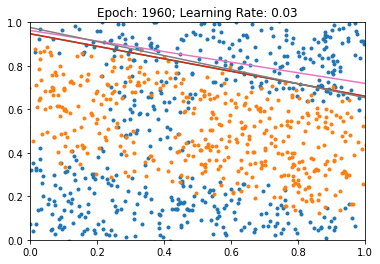

Beta-Gerade: 2.363186836242676
Beta-AND: 2.363186836242676


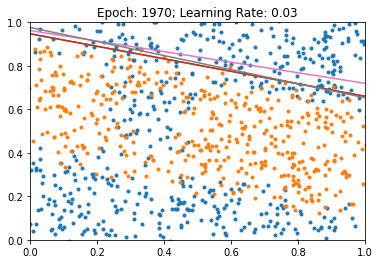

Beta-Gerade: 2.362969398498535
Beta-AND: 2.362969398498535


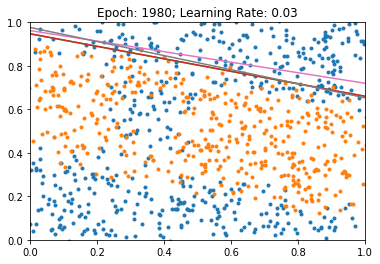

Beta-Gerade: 2.3627495765686035
Beta-AND: 2.3627495765686035


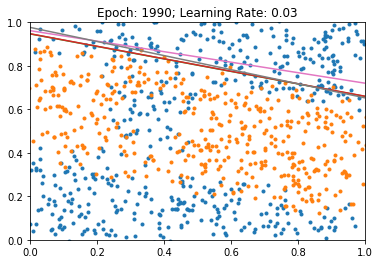

Beta-Gerade: 2.3625364303588867
Beta-AND: 2.3625364303588867


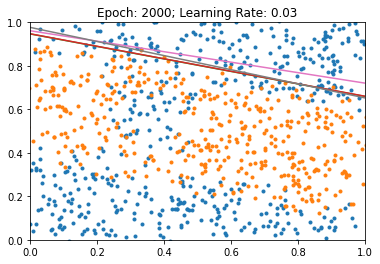

Beta-Gerade: 2.362330913543701
Beta-AND: 2.362330913543701


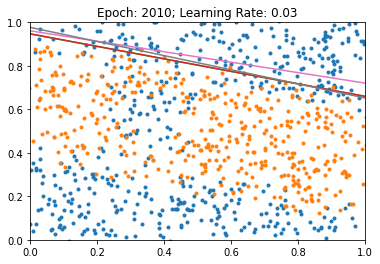

Beta-Gerade: 2.3621277809143066
Beta-AND: 2.3621277809143066


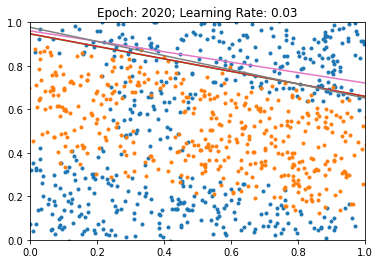

Beta-Gerade: 2.3619256019592285
Beta-AND: 2.3619256019592285


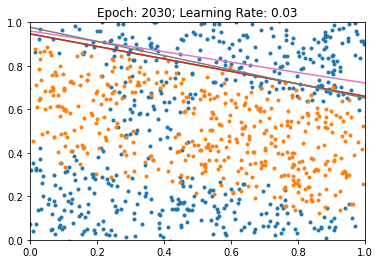

Beta-Gerade: 2.361729383468628
Beta-AND: 2.361729383468628


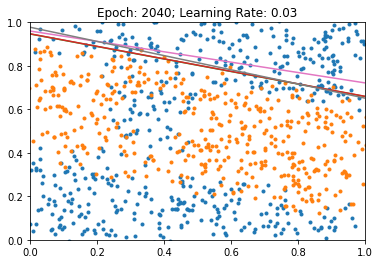

Beta-Gerade: 2.361536741256714
Beta-AND: 2.361536741256714


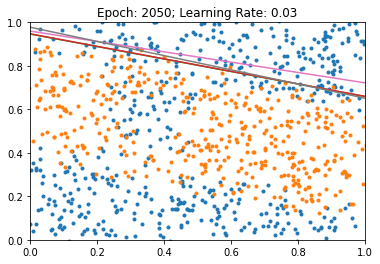

Beta-Gerade: 2.3613440990448
Beta-AND: 2.3613440990448


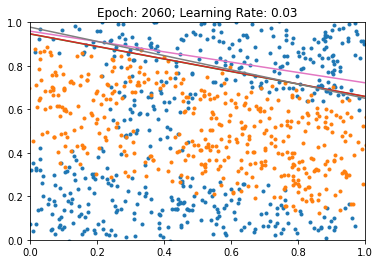

Beta-Gerade: 2.3611574172973633
Beta-AND: 2.3611574172973633


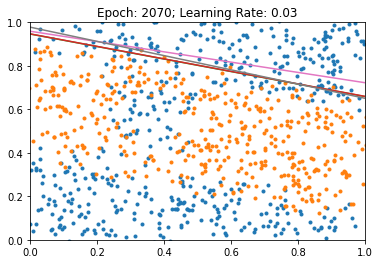

Beta-Gerade: 2.3609702587127686
Beta-AND: 2.3609702587127686


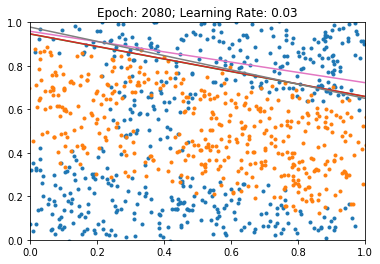

Beta-Gerade: 2.360788583755493
Beta-AND: 2.360788583755493


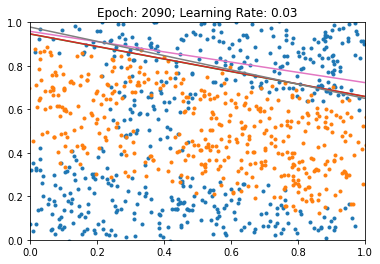

Beta-Gerade: 2.360607624053955
Beta-AND: 2.360607624053955


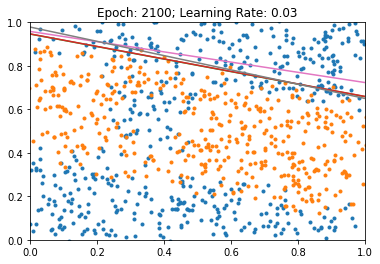

Beta-Gerade: 2.360426664352417
Beta-AND: 2.360426664352417


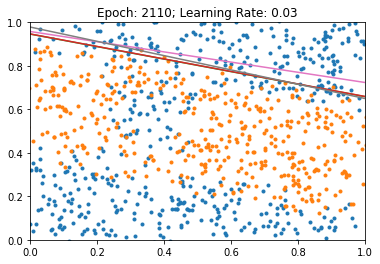

Beta-Gerade: 2.3602497577667236
Beta-AND: 2.3602497577667236


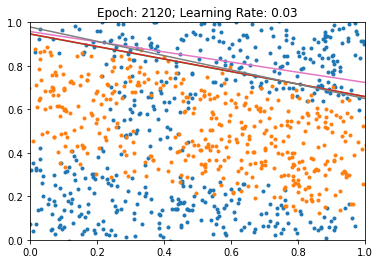

Beta-Gerade: 2.3600738048553467
Beta-AND: 2.3600738048553467


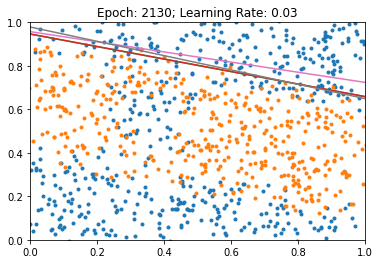

Beta-Gerade: 2.3598992824554443
Beta-AND: 2.3598992824554443


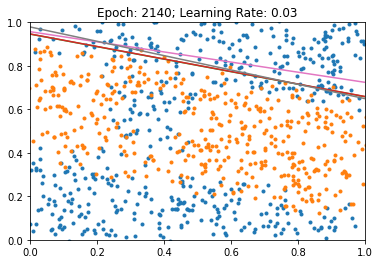

Beta-Gerade: 2.3597240447998047
Beta-AND: 2.3597240447998047


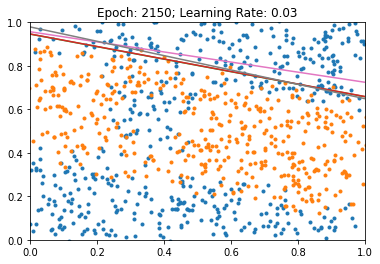

Beta-Gerade: 2.359548807144165
Beta-AND: 2.359548807144165


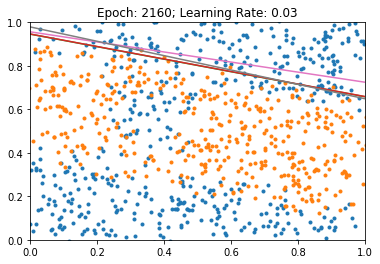

Beta-Gerade: 2.3593738079071045
Beta-AND: 2.3593738079071045


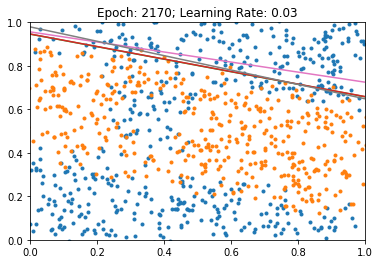

Beta-Gerade: 2.3592045307159424
Beta-AND: 2.3592045307159424


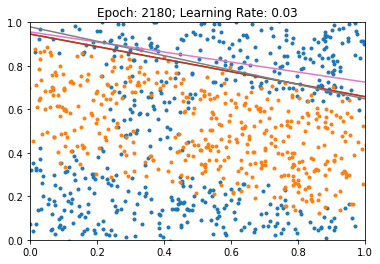

Beta-Gerade: 2.3590335845947266
Beta-AND: 2.3590335845947266


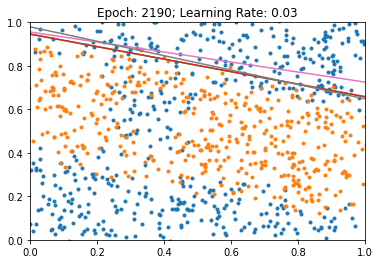

Beta-Gerade: 2.358858823776245
Beta-AND: 2.358858823776245


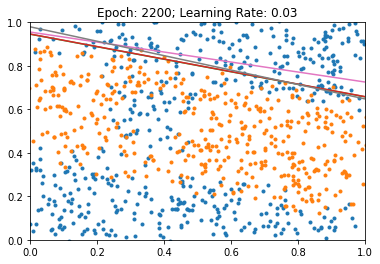

Beta-Gerade: 2.35868501663208
Beta-AND: 2.35868501663208


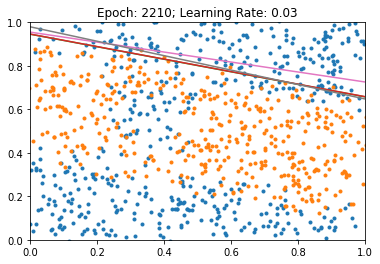

Beta-Gerade: 2.3585145473480225
Beta-AND: 2.3585145473480225


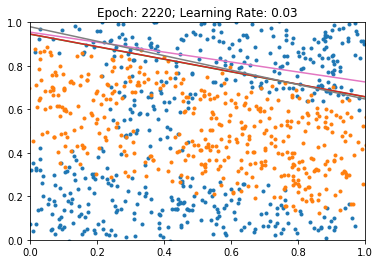

Beta-Gerade: 2.3583428859710693
Beta-AND: 2.3583428859710693


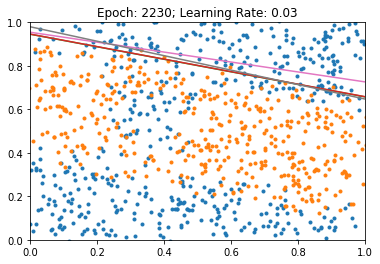

Beta-Gerade: 2.3581690788269043
Beta-AND: 2.3581690788269043


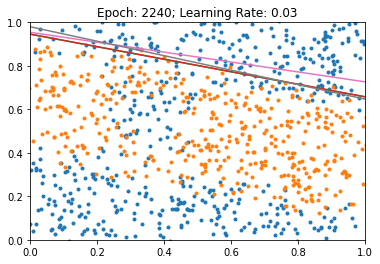

Beta-Gerade: 2.3579964637756348
Beta-AND: 2.3579964637756348


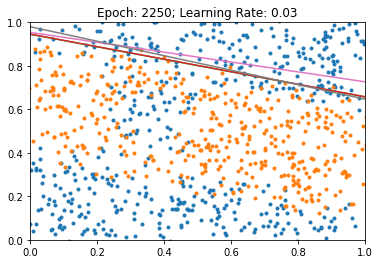

Beta-Gerade: 2.35782527923584
Beta-AND: 2.35782527923584


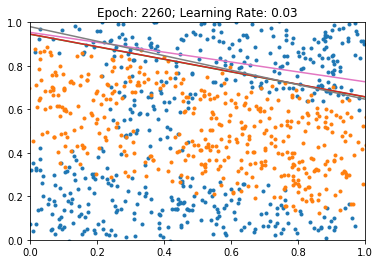

Beta-Gerade: 2.357649087905884
Beta-AND: 2.357649087905884


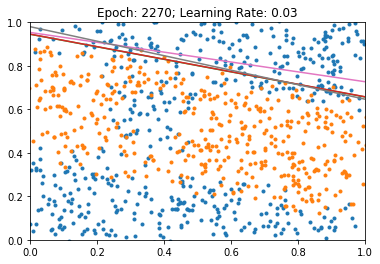

Beta-Gerade: 2.357478141784668
Beta-AND: 2.357478141784668


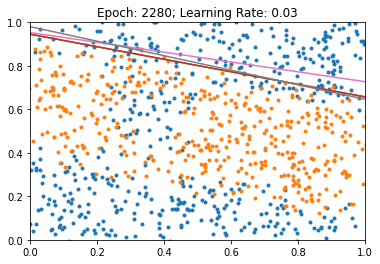

Beta-Gerade: 2.3572990894317627
Beta-AND: 2.3572990894317627


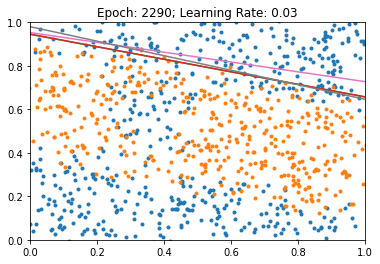

Beta-Gerade: 2.3571255207061768
Beta-AND: 2.3571255207061768


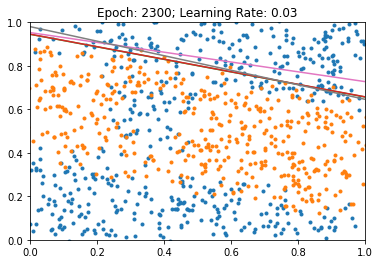

Beta-Gerade: 2.3569531440734863
Beta-AND: 2.3569531440734863


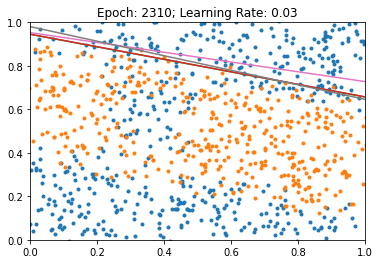

Beta-Gerade: 2.3567798137664795
Beta-AND: 2.3567798137664795


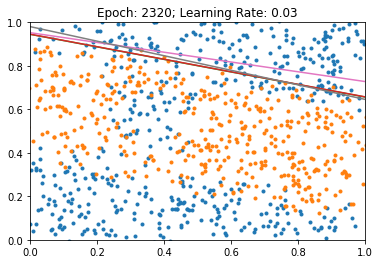

Beta-Gerade: 2.356602430343628
Beta-AND: 2.356602430343628


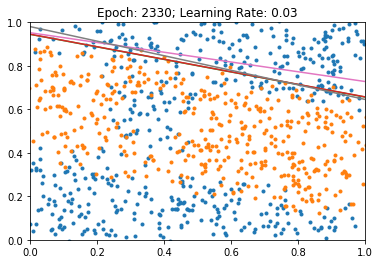

Beta-Gerade: 2.3564255237579346
Beta-AND: 2.3564255237579346


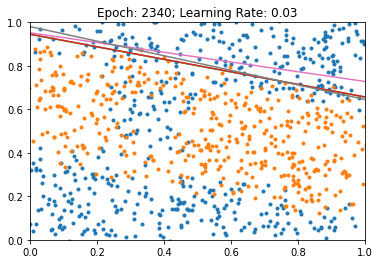

Beta-Gerade: 2.356243848800659
Beta-AND: 2.356243848800659


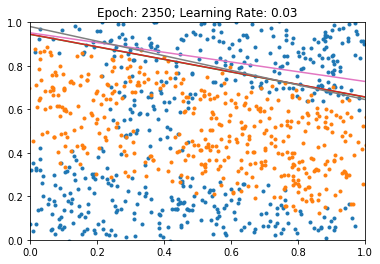

Beta-Gerade: 2.3560707569122314
Beta-AND: 2.3560707569122314


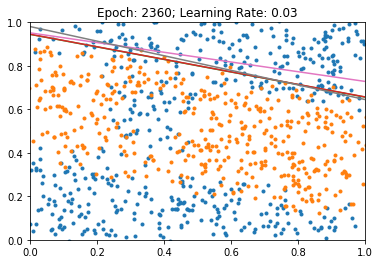

Beta-Gerade: 2.3558926582336426
Beta-AND: 2.3558926582336426


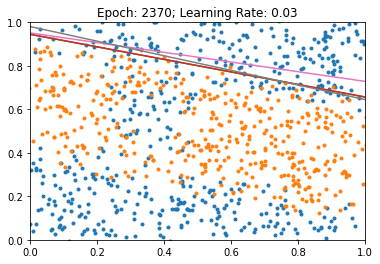

Beta-Gerade: 2.3557143211364746
Beta-AND: 2.3557143211364746


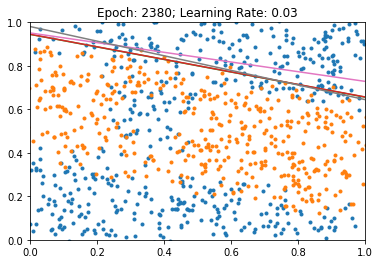

Beta-Gerade: 2.355534315109253
Beta-AND: 2.355534315109253


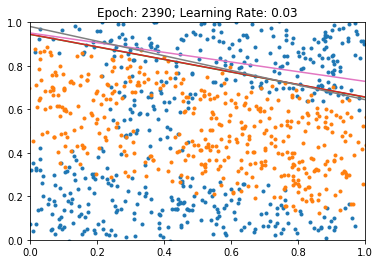

Beta-Gerade: 2.355356454849243
Beta-AND: 2.355356454849243


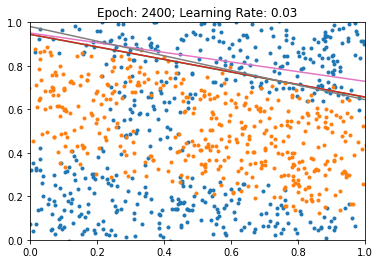

Beta-Gerade: 2.3551790714263916
Beta-AND: 2.3551790714263916


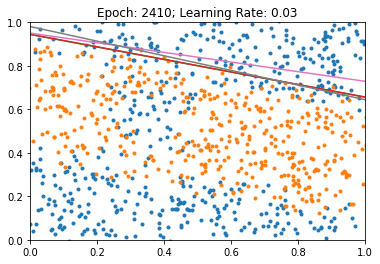

Beta-Gerade: 2.35499906539917
Beta-AND: 2.35499906539917


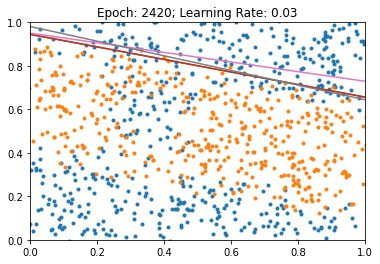

Beta-Gerade: 2.3548200130462646
Beta-AND: 2.3548200130462646


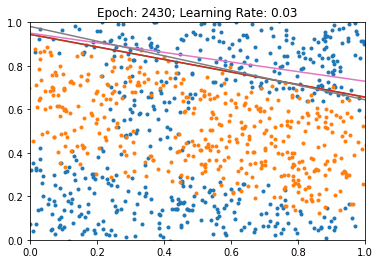

Beta-Gerade: 2.3546388149261475
Beta-AND: 2.3546388149261475


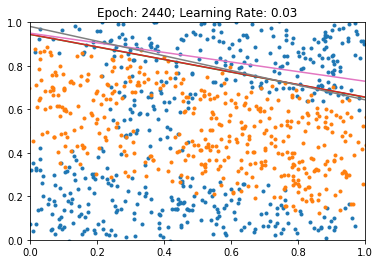

Beta-Gerade: 2.354459285736084
Beta-AND: 2.354459285736084


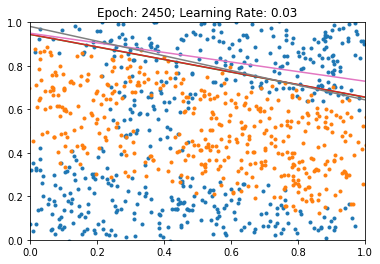

Beta-Gerade: 2.3542778491973877
Beta-AND: 2.3542778491973877


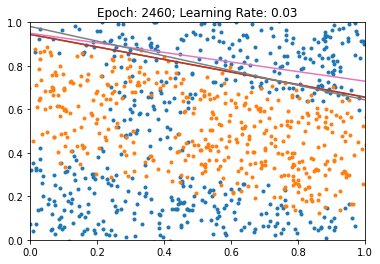

Beta-Gerade: 2.354097843170166
Beta-AND: 2.354097843170166


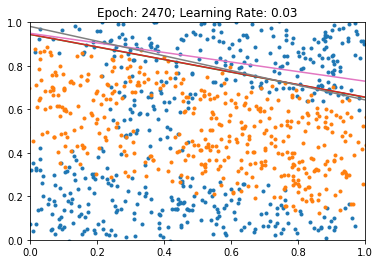

Beta-Gerade: 2.3539202213287354
Beta-AND: 2.3539202213287354


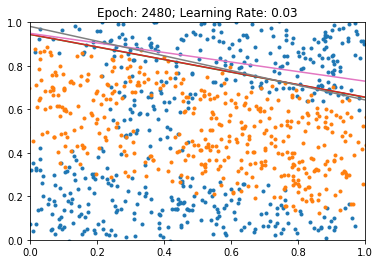

Beta-Gerade: 2.353740692138672
Beta-AND: 2.353740692138672


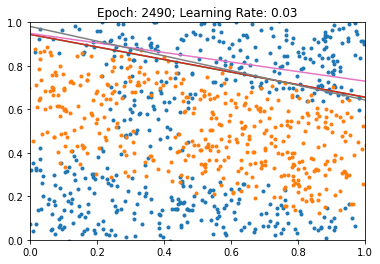

Beta-Gerade: 2.3535561561584473
Beta-AND: 2.3535561561584473


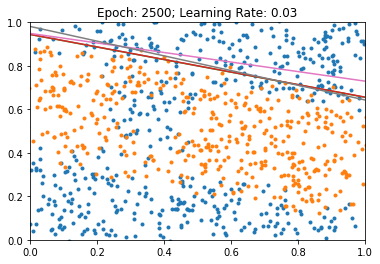

Beta-Gerade: 2.353374719619751
Beta-AND: 2.353374719619751


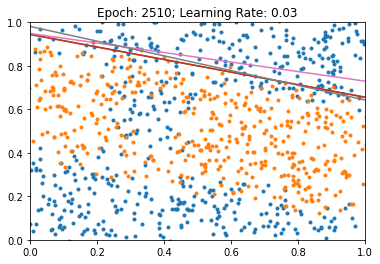

Beta-Gerade: 2.3531899452209473
Beta-AND: 2.3531899452209473


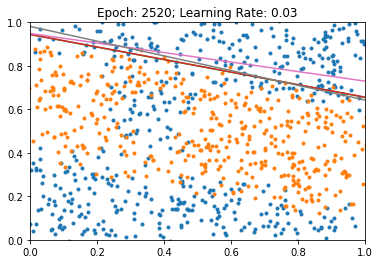

Beta-Gerade: 2.353015899658203
Beta-AND: 2.353015899658203


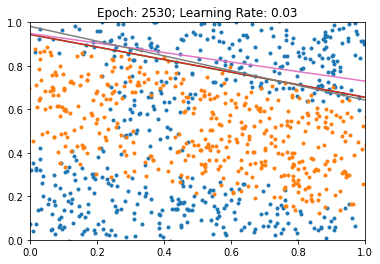

Beta-Gerade: 2.3528330326080322
Beta-AND: 2.3528330326080322


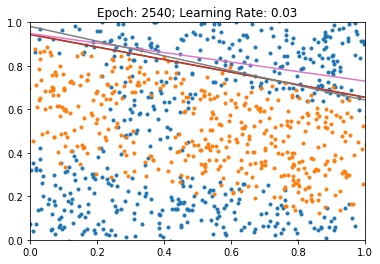

Beta-Gerade: 2.3526482582092285
Beta-AND: 2.3526482582092285


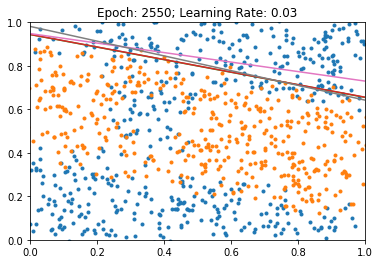

Beta-Gerade: 2.3524680137634277
Beta-AND: 2.3524680137634277


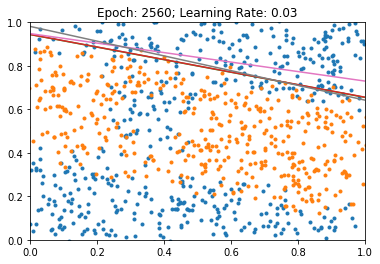

Beta-Gerade: 2.3522865772247314
Beta-AND: 2.3522865772247314


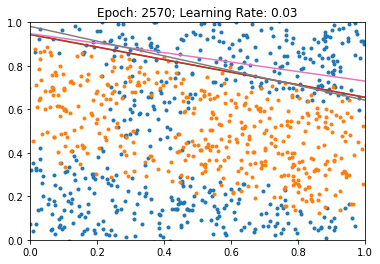

Beta-Gerade: 2.3521082401275635
Beta-AND: 2.3521082401275635


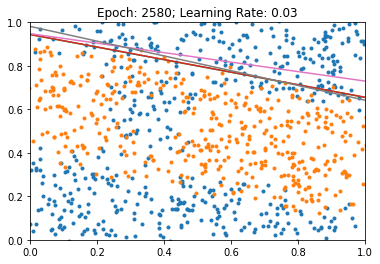

Beta-Gerade: 2.3519275188446045
Beta-AND: 2.3519275188446045


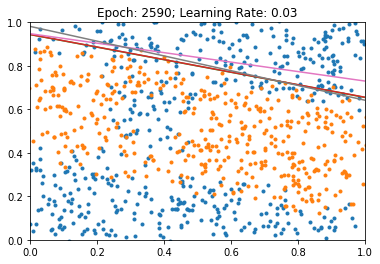

Beta-Gerade: 2.3517472743988037
Beta-AND: 2.3517472743988037


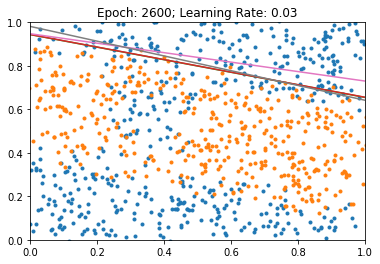

Beta-Gerade: 2.3515679836273193
Beta-AND: 2.3515679836273193


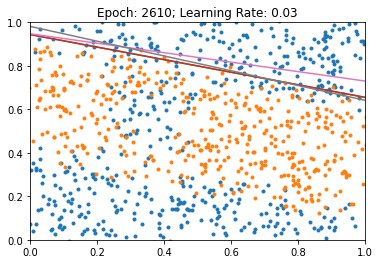

Beta-Gerade: 2.3513898849487305
Beta-AND: 2.3513898849487305


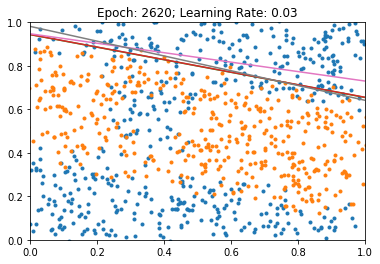

Beta-Gerade: 2.3512115478515625
Beta-AND: 2.3512115478515625


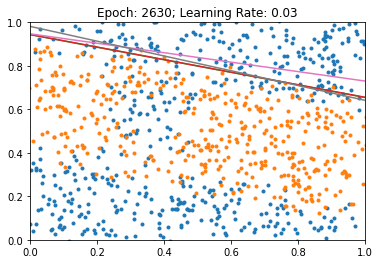

Beta-Gerade: 2.3510289192199707
Beta-AND: 2.3510289192199707


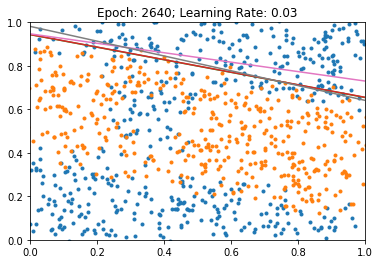

Beta-Gerade: 2.3508501052856445
Beta-AND: 2.3508501052856445


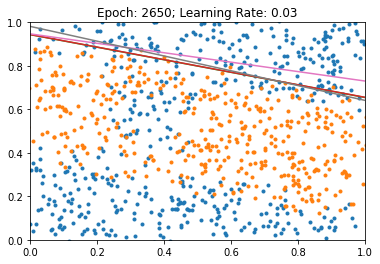

Beta-Gerade: 2.350670337677002
Beta-AND: 2.350670337677002


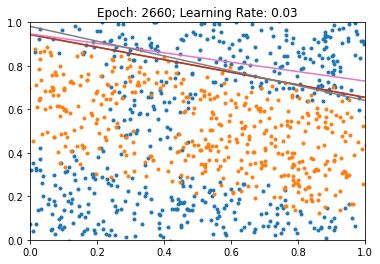

Beta-Gerade: 2.3504955768585205
Beta-AND: 2.3504955768585205


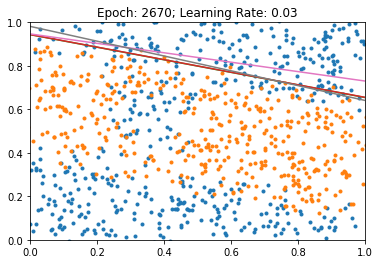

Beta-Gerade: 2.3503224849700928
Beta-AND: 2.3503224849700928


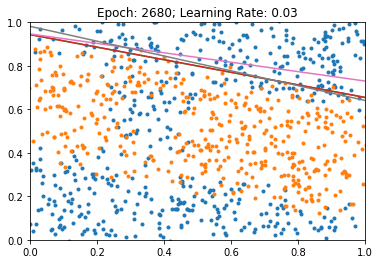

Beta-Gerade: 2.3501415252685547
Beta-AND: 2.3501415252685547


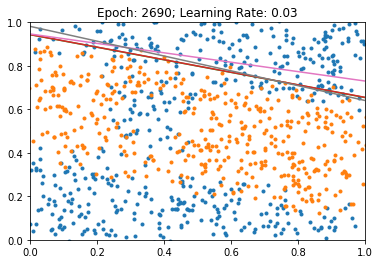

Beta-Gerade: 2.3499600887298584
Beta-AND: 2.3499600887298584


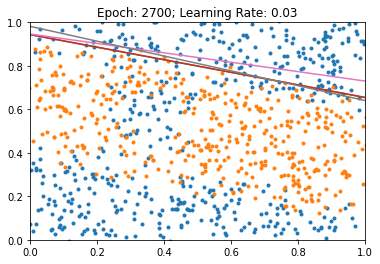

Beta-Gerade: 2.3497822284698486
Beta-AND: 2.3497822284698486


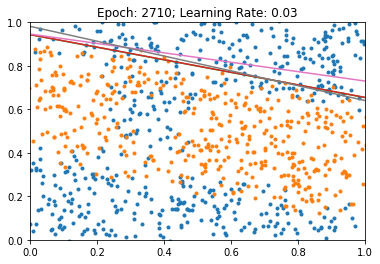

Beta-Gerade: 2.34960675239563
Beta-AND: 2.34960675239563


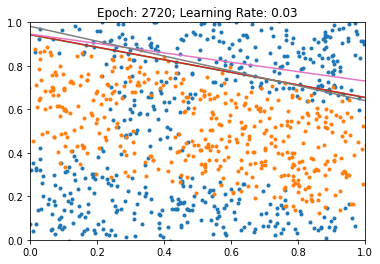

Beta-Gerade: 2.3494348526000977
Beta-AND: 2.3494348526000977


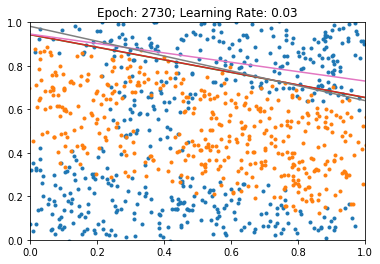

Beta-Gerade: 2.349257230758667
Beta-AND: 2.349257230758667


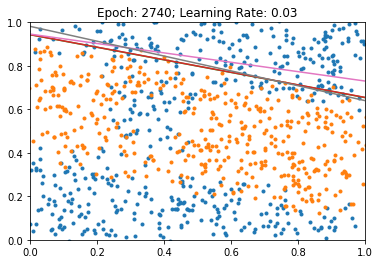

Beta-Gerade: 2.3490848541259766
Beta-AND: 2.3490848541259766


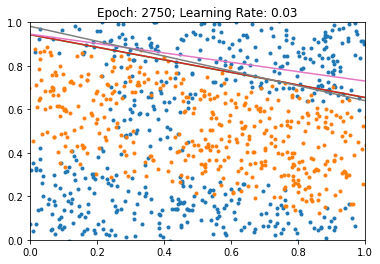

Beta-Gerade: 2.3489089012145996
Beta-AND: 2.3489089012145996


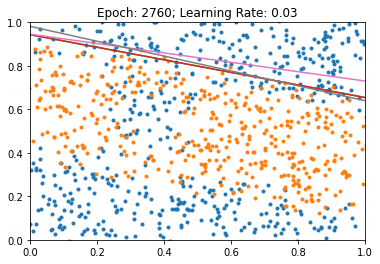

Beta-Gerade: 2.3487353324890137
Beta-AND: 2.3487353324890137


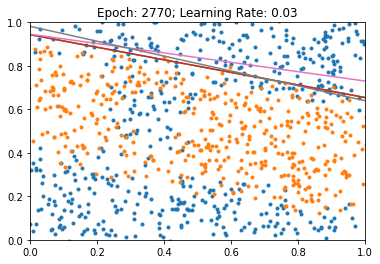

Beta-Gerade: 2.348559856414795
Beta-AND: 2.348559856414795


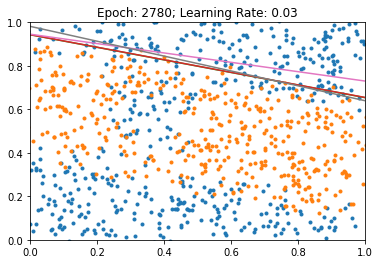

Beta-Gerade: 2.3483920097351074
Beta-AND: 2.3483920097351074


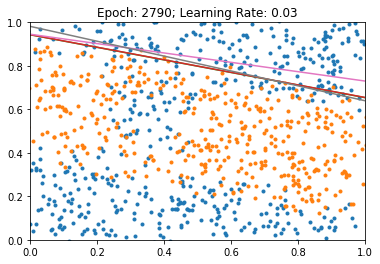

Beta-Gerade: 2.3482165336608887
Beta-AND: 2.3482165336608887


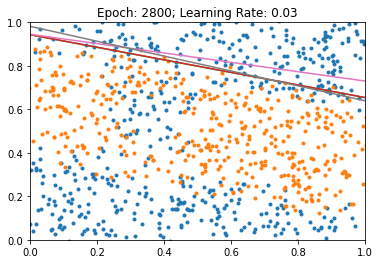

Beta-Gerade: 2.348043918609619
Beta-AND: 2.348043918609619


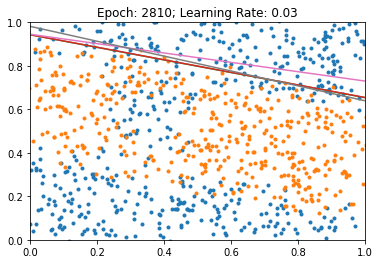

Beta-Gerade: 2.3478732109069824
Beta-AND: 2.3478732109069824


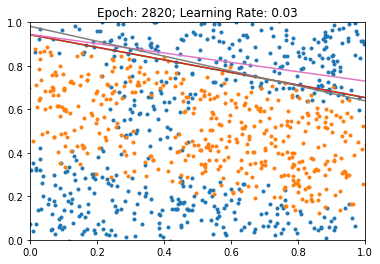

Beta-Gerade: 2.347700834274292
Beta-AND: 2.347700834274292


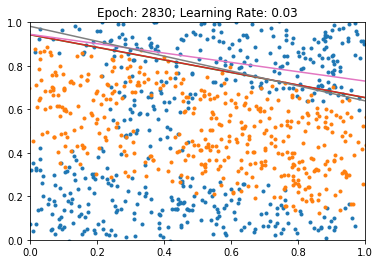

Beta-Gerade: 2.347529411315918
Beta-AND: 2.347529411315918


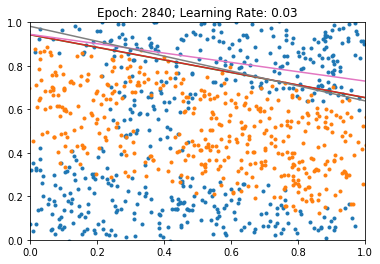

Beta-Gerade: 2.347360610961914
Beta-AND: 2.347360610961914


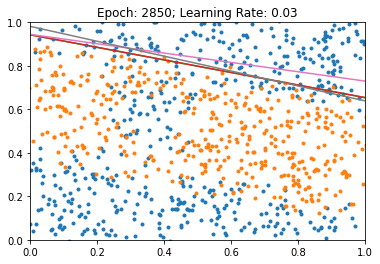

Beta-Gerade: 2.347193956375122
Beta-AND: 2.347193956375122


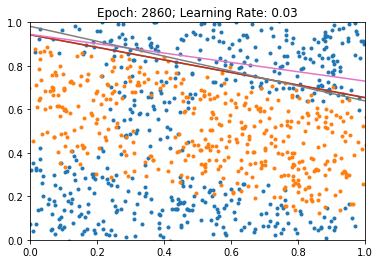

Beta-Gerade: 2.347025156021118
Beta-AND: 2.347025156021118


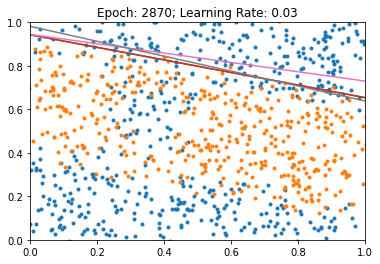

Beta-Gerade: 2.3468551635742188
Beta-AND: 2.3468551635742188


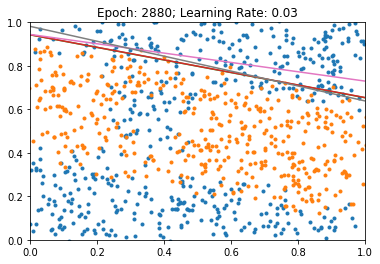

Beta-Gerade: 2.3466830253601074
Beta-AND: 2.3466830253601074


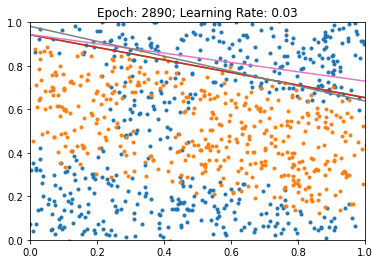

Beta-Gerade: 2.34651255607605
Beta-AND: 2.34651255607605


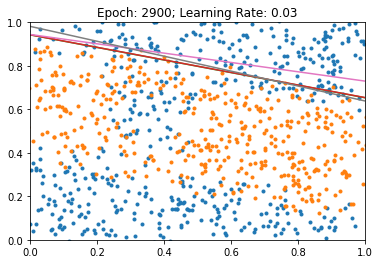

Beta-Gerade: 2.3463494777679443
Beta-AND: 2.3463494777679443


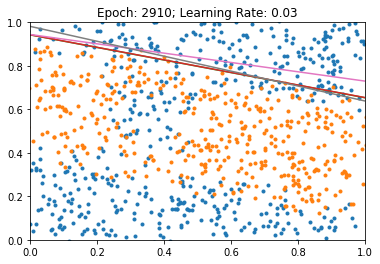

Beta-Gerade: 2.3461883068084717
Beta-AND: 2.3461883068084717


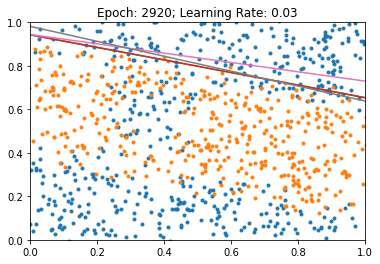

Beta-Gerade: 2.3460206985473633
Beta-AND: 2.3460206985473633


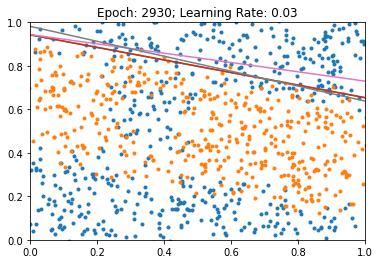

Beta-Gerade: 2.345857620239258
Beta-AND: 2.345857620239258


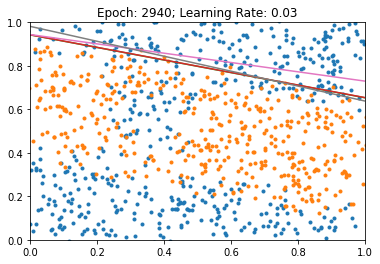

Beta-Gerade: 2.3456954956054688
Beta-AND: 2.3456954956054688


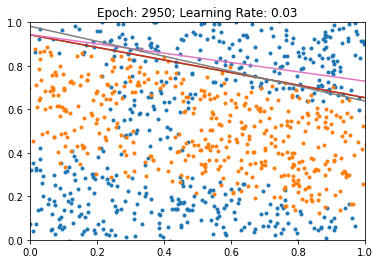

Beta-Gerade: 2.345526933670044
Beta-AND: 2.345526933670044


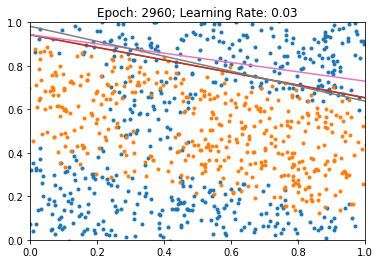

Beta-Gerade: 2.345367670059204
Beta-AND: 2.345367670059204


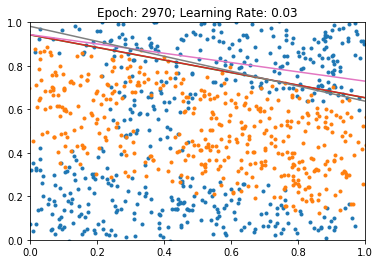

Beta-Gerade: 2.34519362449646
Beta-AND: 2.34519362449646


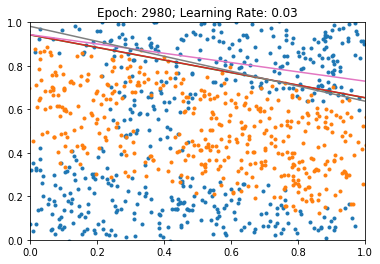

Beta-Gerade: 2.345036506652832
Beta-AND: 2.345036506652832


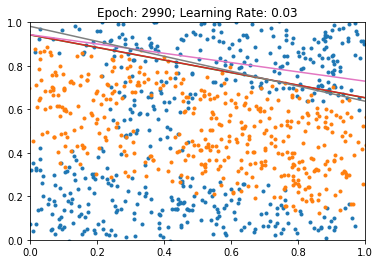

Beta-Gerade: 2.344893455505371
Beta-AND: 2.344893455505371


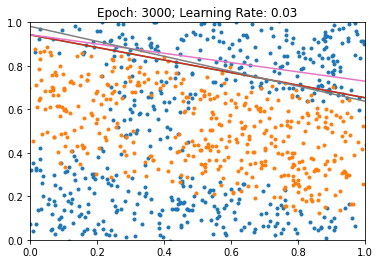

Beta-Gerade: 2.344723701477051
Beta-AND: 2.344723701477051


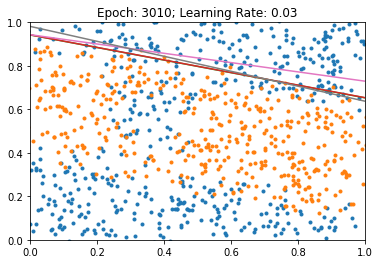

Beta-Gerade: 2.3445701599121094
Beta-AND: 2.3445701599121094


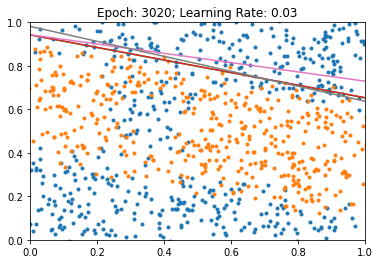

Beta-Gerade: 2.3444201946258545
Beta-AND: 2.3444201946258545


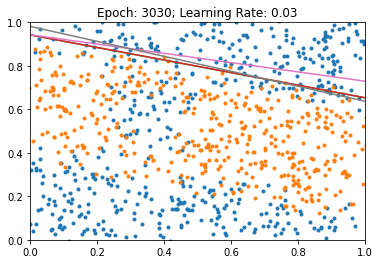

Beta-Gerade: 2.344235420227051
Beta-AND: 2.344235420227051


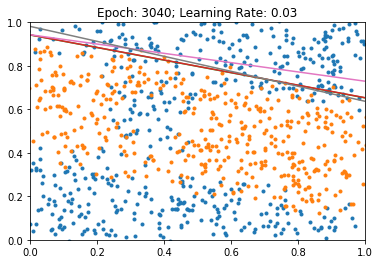

Beta-Gerade: 2.343989133834839
Beta-AND: 2.343989133834839


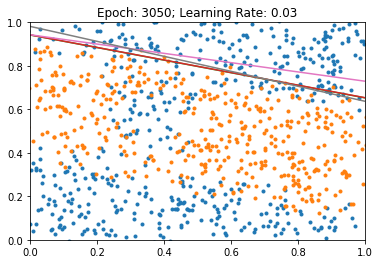

Beta-Gerade: 2.3439502716064453
Beta-AND: 2.3439502716064453


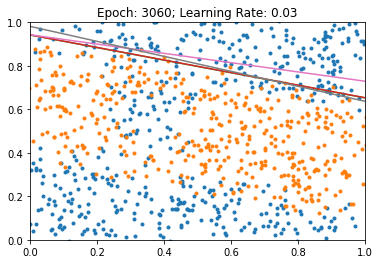

Beta-Gerade: 2.34379243850708
Beta-AND: 2.34379243850708


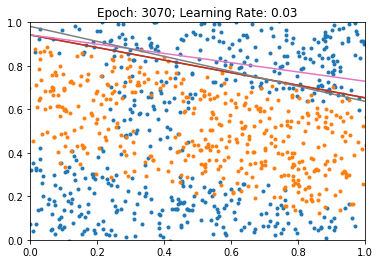

Beta-Gerade: 2.343642473220825
Beta-AND: 2.343642473220825


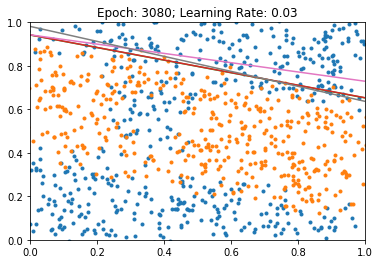

Beta-Gerade: 2.343461513519287
Beta-AND: 2.343461513519287


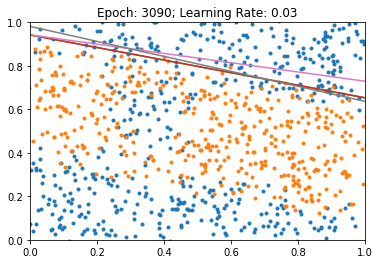

Beta-Gerade: 2.343352794647217
Beta-AND: 2.343352794647217


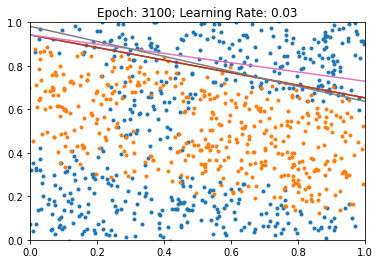

Beta-Gerade: 2.342898368835449
Beta-AND: 2.342898368835449


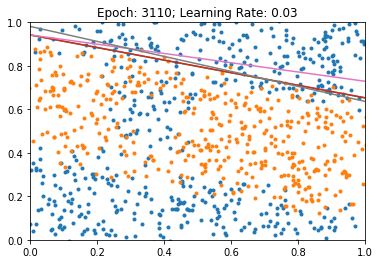

Beta-Gerade: 2.3429512977600098
Beta-AND: 2.3429512977600098


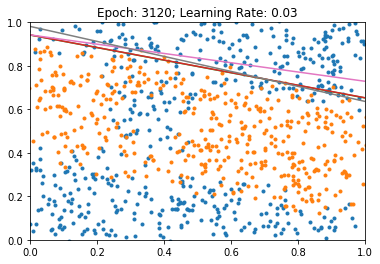

Beta-Gerade: 2.342780828475952
Beta-AND: 2.342780828475952


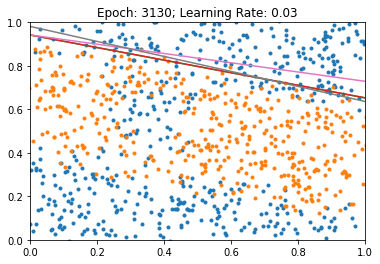

Beta-Gerade: 2.3427250385284424
Beta-AND: 2.3427250385284424


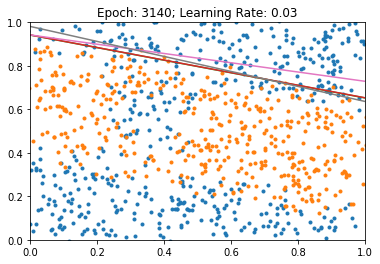

Beta-Gerade: 2.342546224594116
Beta-AND: 2.342546224594116


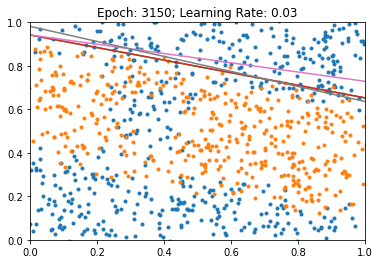

Beta-Gerade: 2.3423526287078857
Beta-AND: 2.3423526287078857


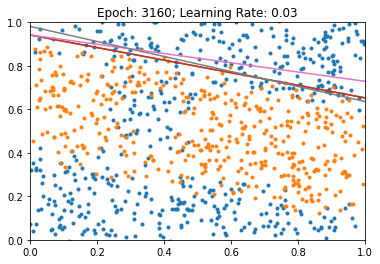

Beta-Gerade: nan
Beta-AND: nan


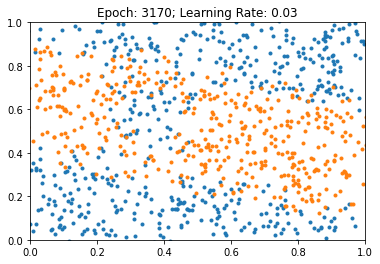

Beta-Gerade: nan
Beta-AND: nan


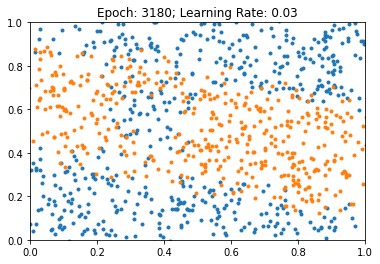

Beta-Gerade: nan
Beta-AND: nan


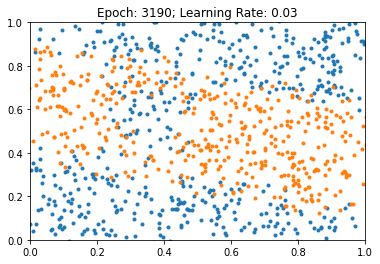

Beta-Gerade: nan
Beta-AND: nan


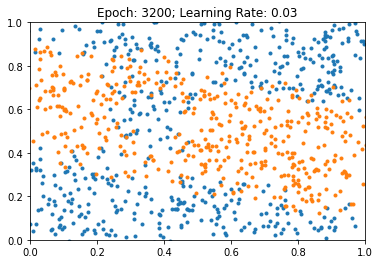

Beta-Gerade: nan
Beta-AND: nan


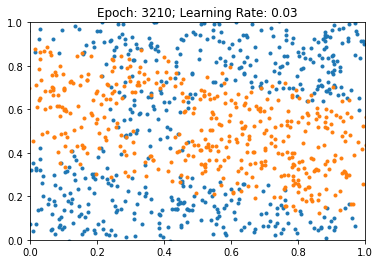

Beta-Gerade: nan
Beta-AND: nan


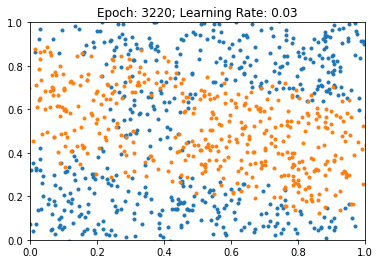

Beta-Gerade: nan
Beta-AND: nan


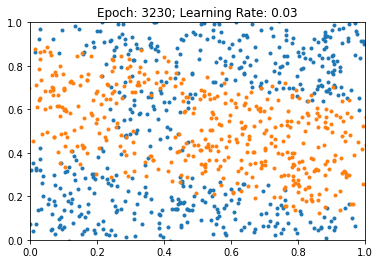

Beta-Gerade: nan
Beta-AND: nan


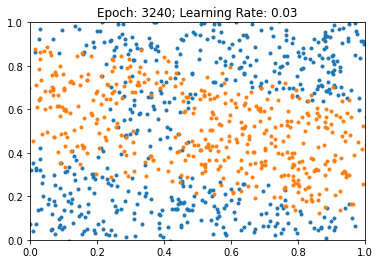

Beta-Gerade: nan
Beta-AND: nan


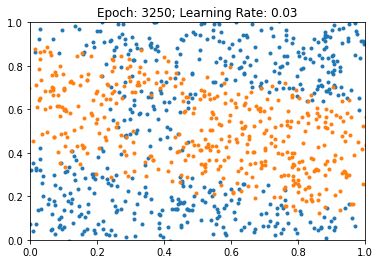

Beta-Gerade: nan
Beta-AND: nan


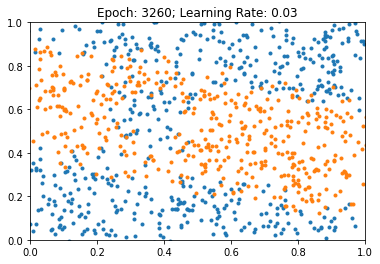

Beta-Gerade: nan
Beta-AND: nan


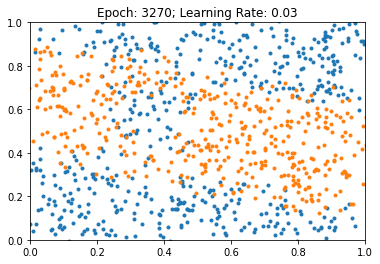

Beta-Gerade: nan
Beta-AND: nan


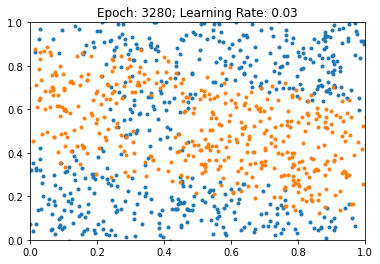

Beta-Gerade: nan
Beta-AND: nan


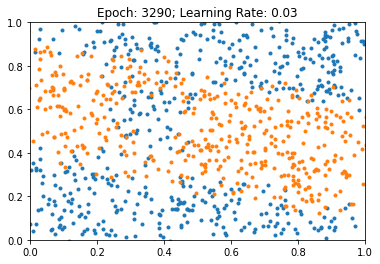

Beta-Gerade: nan
Beta-AND: nan


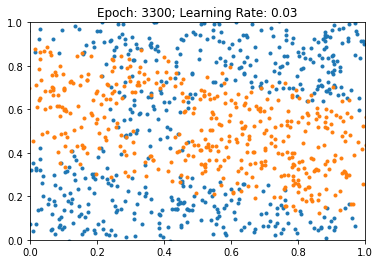

Beta-Gerade: nan
Beta-AND: nan


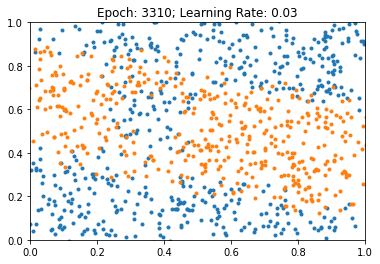

Beta-Gerade: nan
Beta-AND: nan


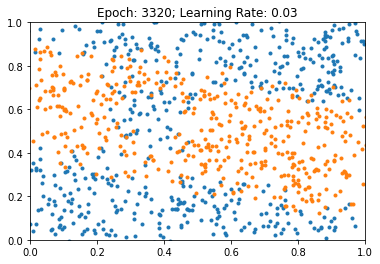

Beta-Gerade: nan
Beta-AND: nan


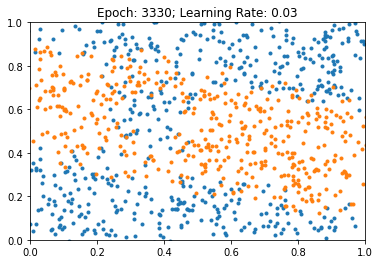

Beta-Gerade: nan
Beta-AND: nan


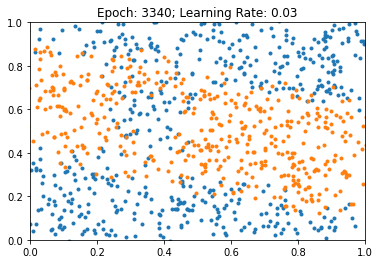

Beta-Gerade: nan
Beta-AND: nan


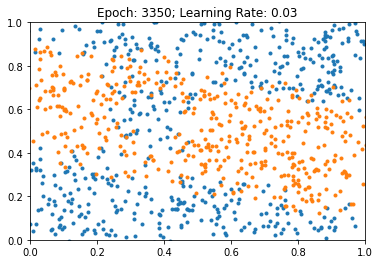

Beta-Gerade: nan
Beta-AND: nan


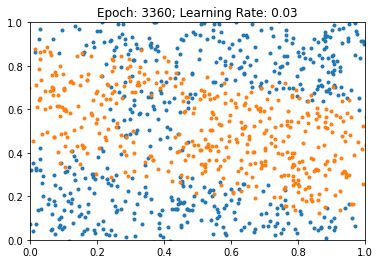

Beta-Gerade: nan
Beta-AND: nan


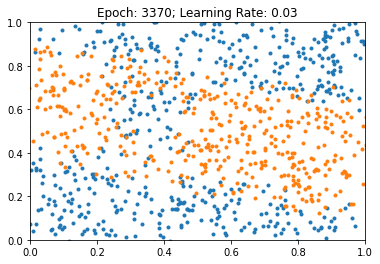

Beta-Gerade: nan
Beta-AND: nan


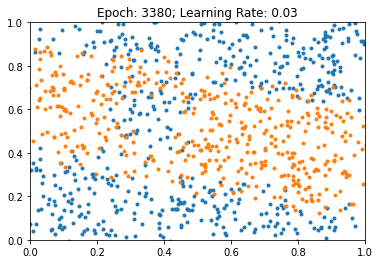

Beta-Gerade: nan
Beta-AND: nan


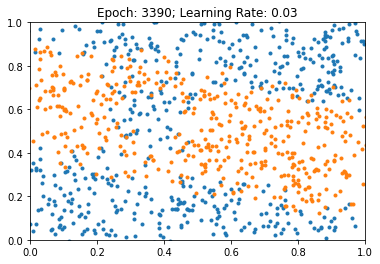

Beta-Gerade: nan
Beta-AND: nan


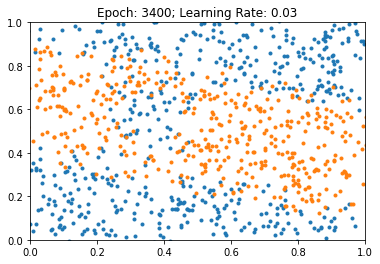

Beta-Gerade: nan
Beta-AND: nan


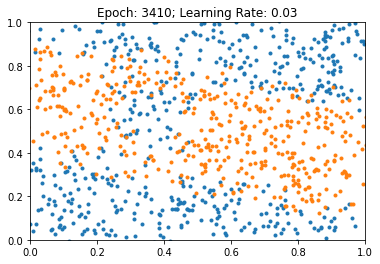

Beta-Gerade: nan
Beta-AND: nan


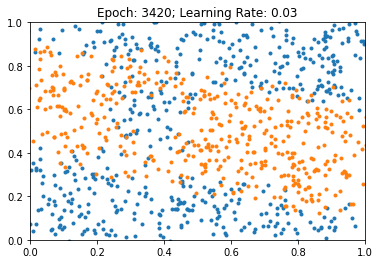

Beta-Gerade: nan
Beta-AND: nan


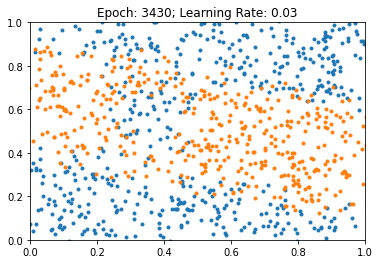

Beta-Gerade: nan
Beta-AND: nan


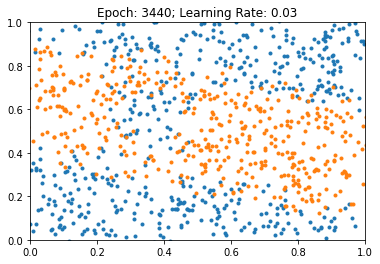

Beta-Gerade: nan
Beta-AND: nan


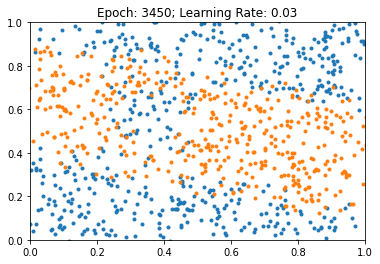

Beta-Gerade: nan
Beta-AND: nan


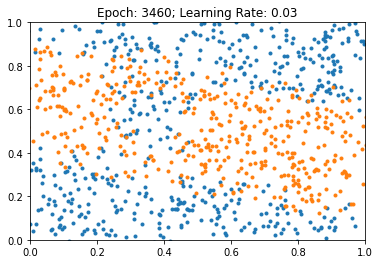

Beta-Gerade: nan
Beta-AND: nan


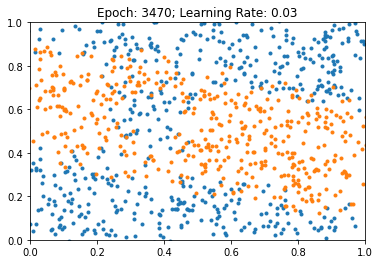

Beta-Gerade: nan
Beta-AND: nan


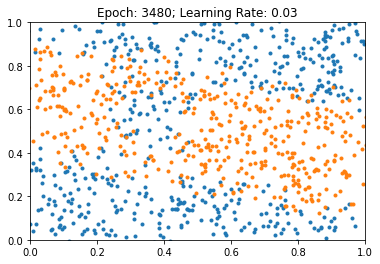

Beta-Gerade: nan
Beta-AND: nan


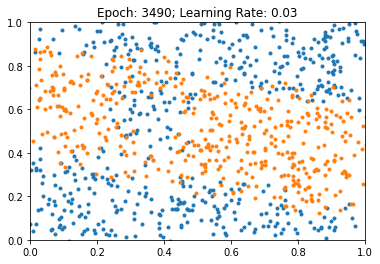

Beta-Gerade: nan
Beta-AND: nan


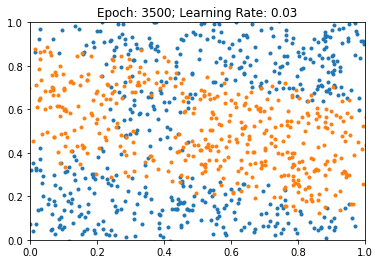

Beta-Gerade: nan
Beta-AND: nan


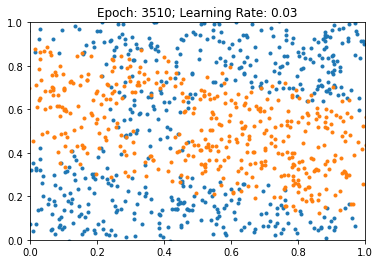

Beta-Gerade: nan
Beta-AND: nan


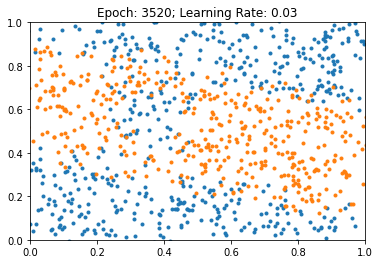

Beta-Gerade: nan
Beta-AND: nan


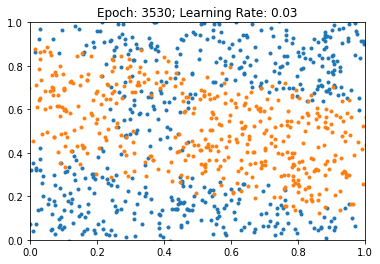

Beta-Gerade: nan
Beta-AND: nan


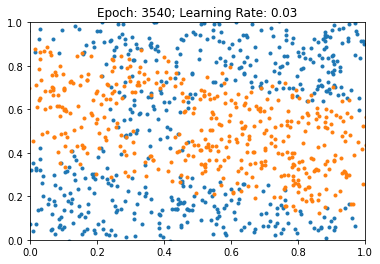

Beta-Gerade: nan
Beta-AND: nan


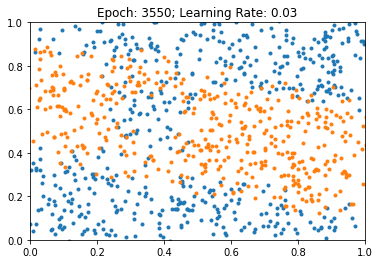

Beta-Gerade: nan
Beta-AND: nan


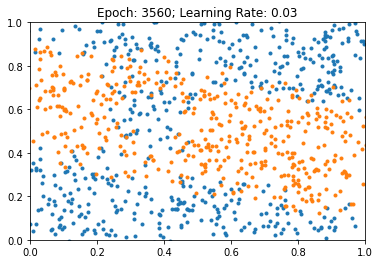

Beta-Gerade: nan
Beta-AND: nan


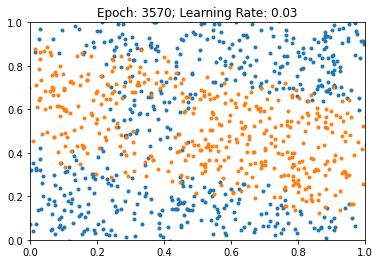

Beta-Gerade: nan
Beta-AND: nan


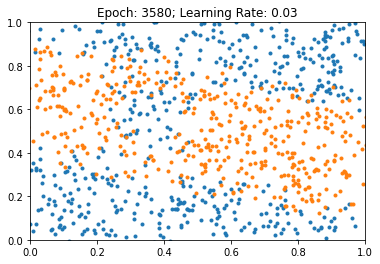

Beta-Gerade: nan
Beta-AND: nan


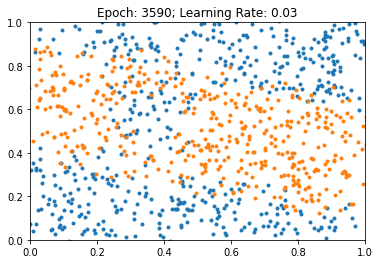

Beta-Gerade: nan
Beta-AND: nan


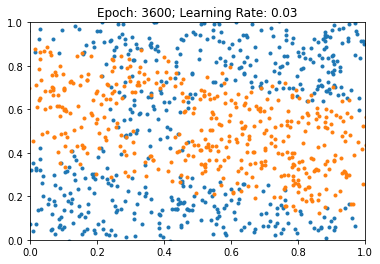

Beta-Gerade: nan
Beta-AND: nan


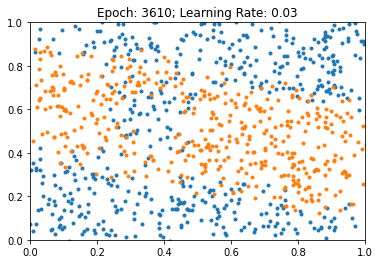

Beta-Gerade: nan
Beta-AND: nan


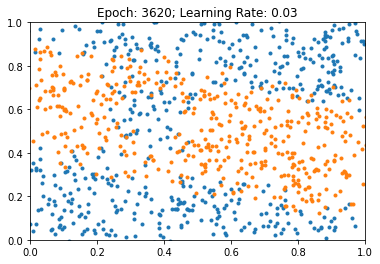

Beta-Gerade: nan
Beta-AND: nan


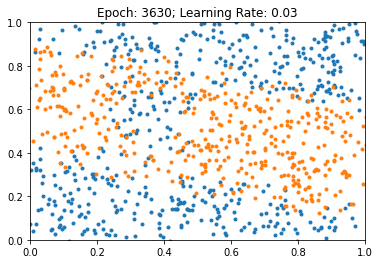

Beta-Gerade: nan
Beta-AND: nan


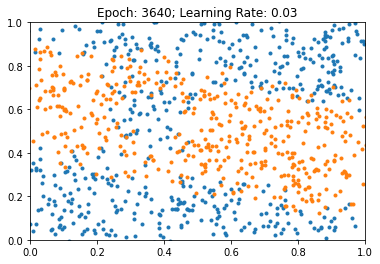

Beta-Gerade: nan
Beta-AND: nan


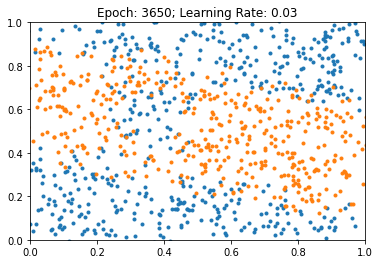

Beta-Gerade: nan
Beta-AND: nan


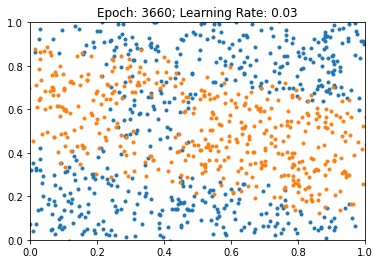

Beta-Gerade: nan
Beta-AND: nan


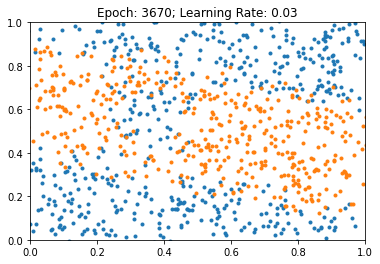

Beta-Gerade: nan
Beta-AND: nan


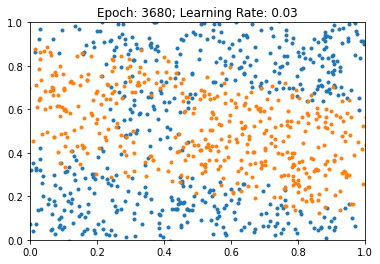

Beta-Gerade: nan
Beta-AND: nan


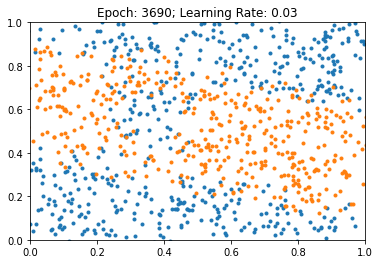

Beta-Gerade: nan
Beta-AND: nan


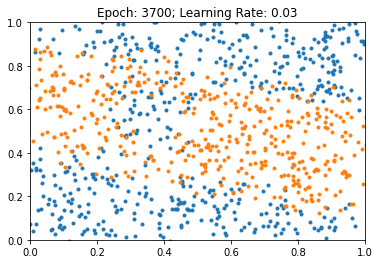

Beta-Gerade: nan
Beta-AND: nan


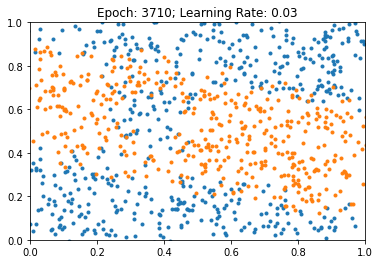

Beta-Gerade: nan
Beta-AND: nan


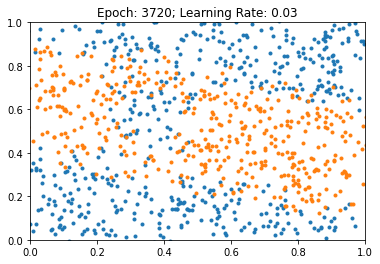

Beta-Gerade: nan
Beta-AND: nan


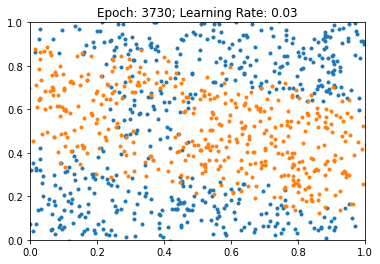

Beta-Gerade: nan
Beta-AND: nan


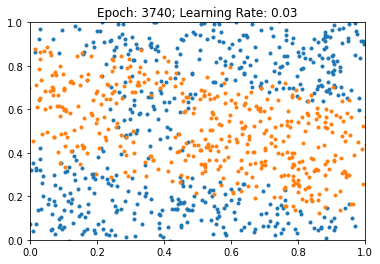

Beta-Gerade: nan
Beta-AND: nan


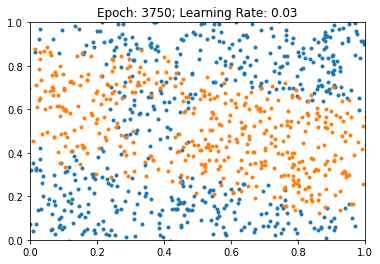

Beta-Gerade: nan
Beta-AND: nan


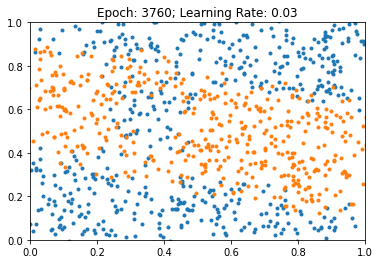

Beta-Gerade: nan
Beta-AND: nan


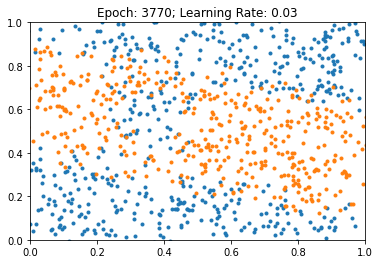

Beta-Gerade: nan
Beta-AND: nan


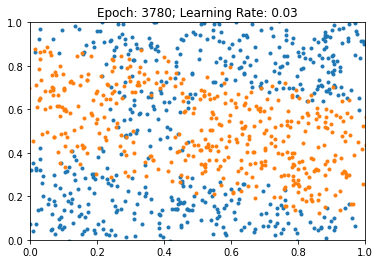

Beta-Gerade: nan
Beta-AND: nan


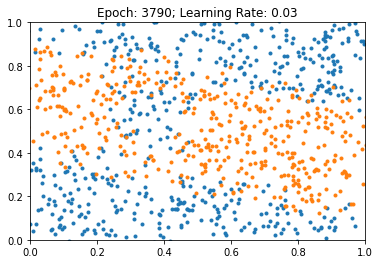

Beta-Gerade: nan
Beta-AND: nan


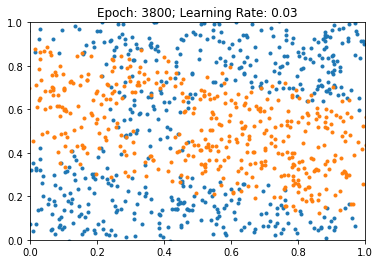

Beta-Gerade: nan
Beta-AND: nan


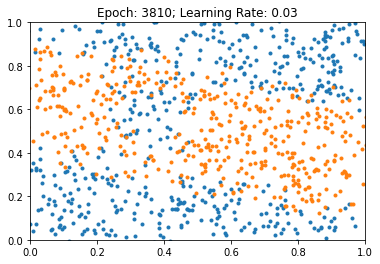

Beta-Gerade: nan
Beta-AND: nan


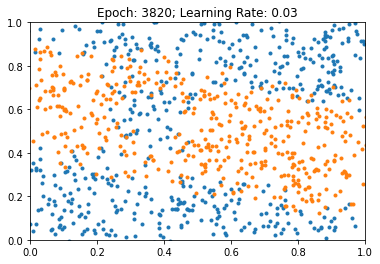

Beta-Gerade: nan
Beta-AND: nan


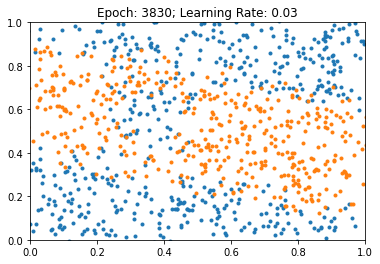

Beta-Gerade: nan
Beta-AND: nan


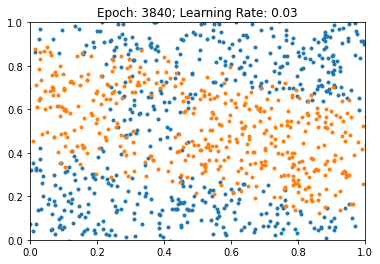

Beta-Gerade: nan
Beta-AND: nan


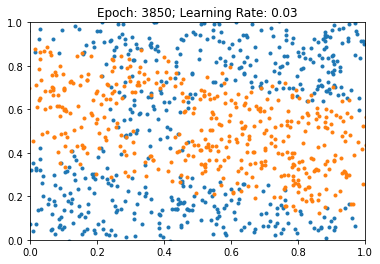

Beta-Gerade: nan
Beta-AND: nan


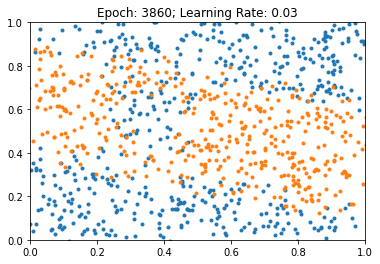

Beta-Gerade: nan
Beta-AND: nan


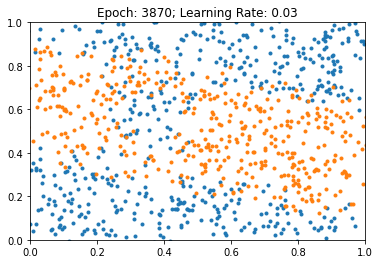

Beta-Gerade: nan
Beta-AND: nan


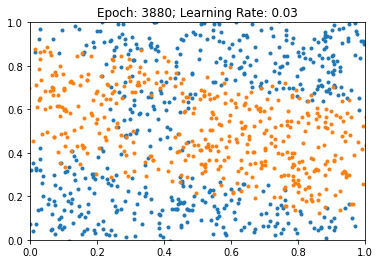

Beta-Gerade: nan
Beta-AND: nan


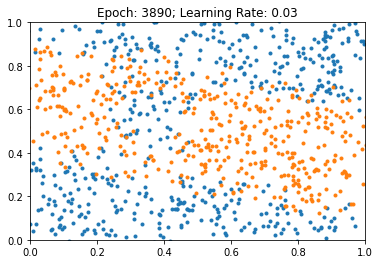

Beta-Gerade: nan
Beta-AND: nan


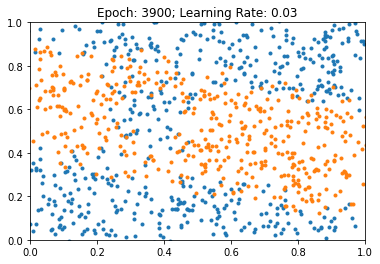

Beta-Gerade: nan
Beta-AND: nan


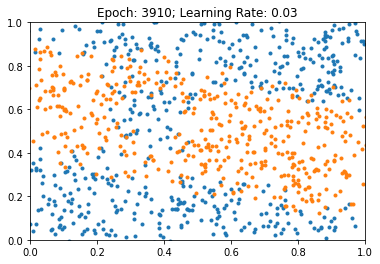

Beta-Gerade: nan
Beta-AND: nan


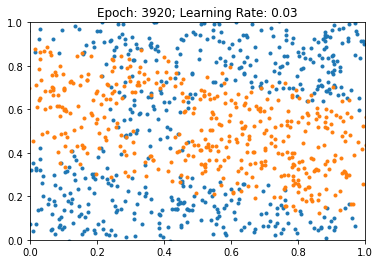

Beta-Gerade: nan
Beta-AND: nan


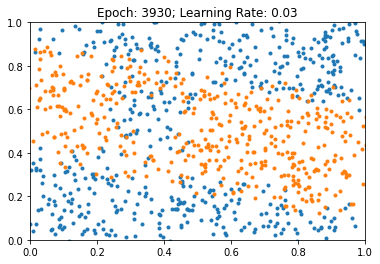

Beta-Gerade: nan
Beta-AND: nan


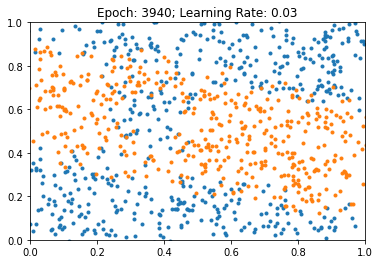

Beta-Gerade: nan
Beta-AND: nan


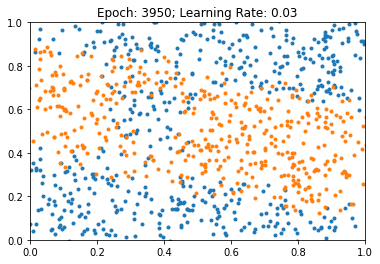

Beta-Gerade: nan
Beta-AND: nan


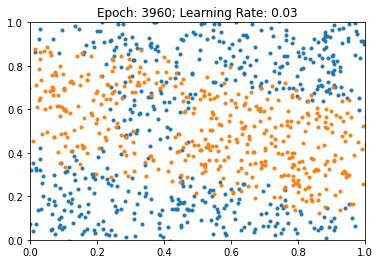

Beta-Gerade: nan
Beta-AND: nan


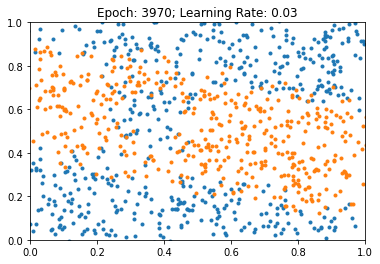

Beta-Gerade: nan
Beta-AND: nan


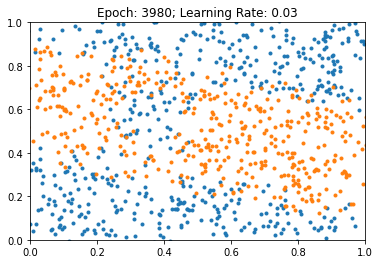

Beta-Gerade: nan
Beta-AND: nan


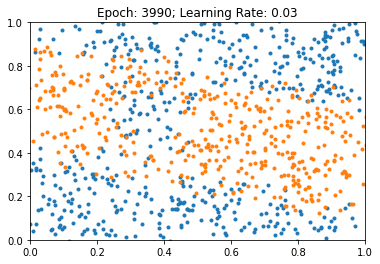

Beta-Gerade: nan
Beta-AND: nan


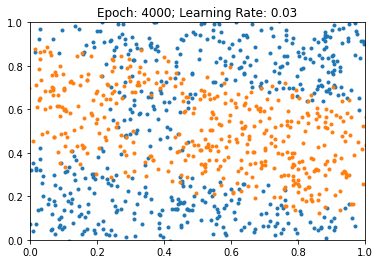

Beta-Gerade: nan
Beta-AND: nan


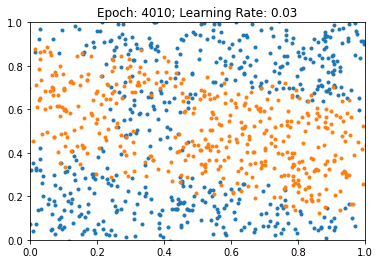

Beta-Gerade: nan
Beta-AND: nan


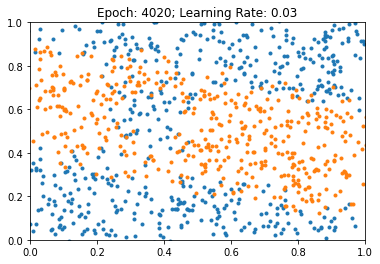

Beta-Gerade: nan
Beta-AND: nan


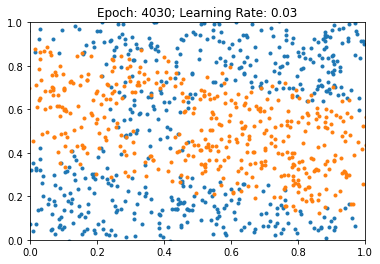

Beta-Gerade: nan
Beta-AND: nan


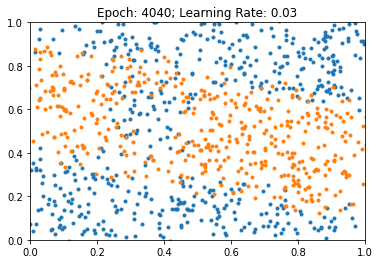

Beta-Gerade: nan
Beta-AND: nan


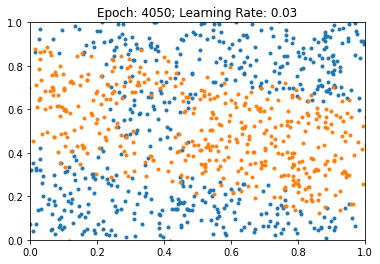

Beta-Gerade: nan
Beta-AND: nan


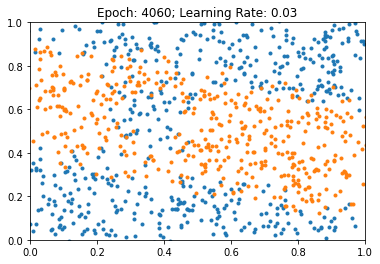

Beta-Gerade: nan
Beta-AND: nan


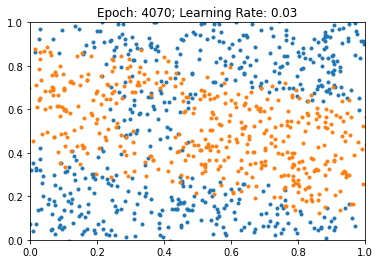

Beta-Gerade: nan
Beta-AND: nan


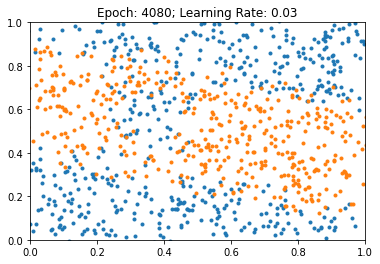

Beta-Gerade: nan
Beta-AND: nan


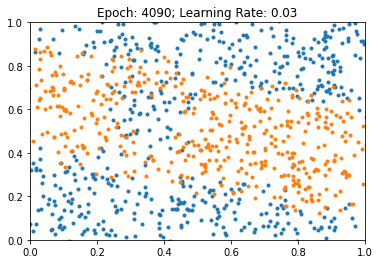

Beta-Gerade: nan
Beta-AND: nan


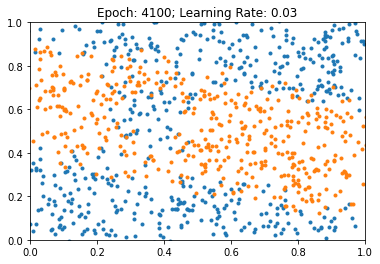

Beta-Gerade: nan
Beta-AND: nan


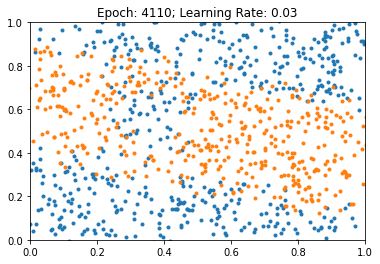

Beta-Gerade: nan
Beta-AND: nan


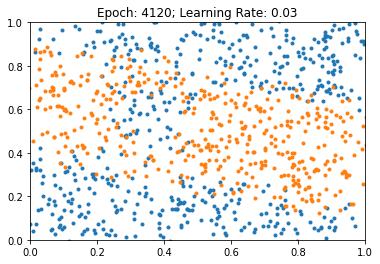

Beta-Gerade: nan
Beta-AND: nan


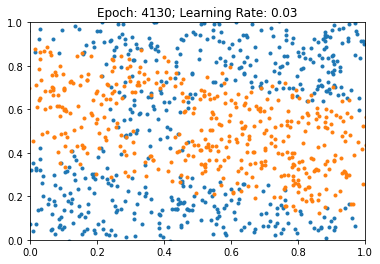

Beta-Gerade: nan
Beta-AND: nan


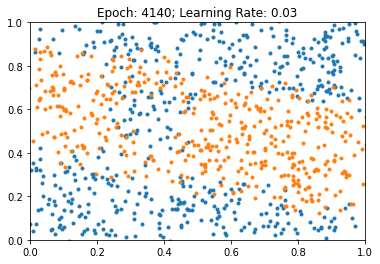

Beta-Gerade: nan
Beta-AND: nan


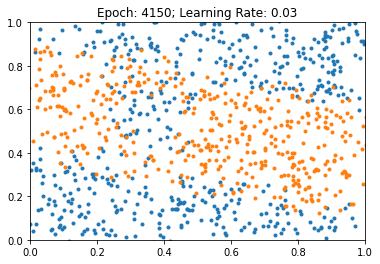

Beta-Gerade: nan
Beta-AND: nan


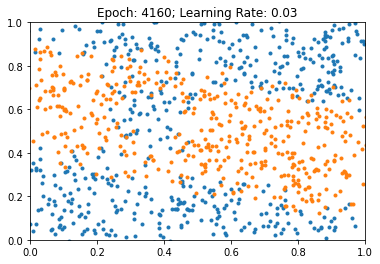

Beta-Gerade: nan
Beta-AND: nan


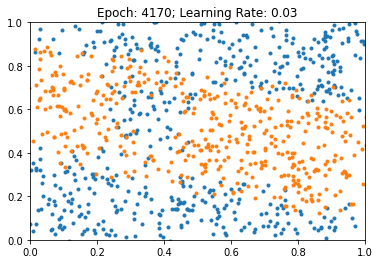

Beta-Gerade: nan
Beta-AND: nan


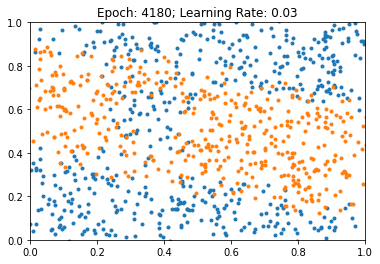

Beta-Gerade: nan
Beta-AND: nan


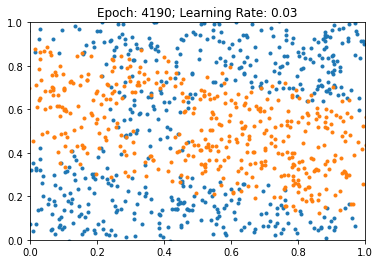

Beta-Gerade: nan
Beta-AND: nan


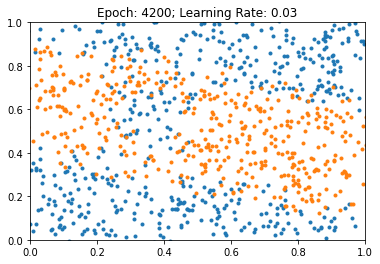

Beta-Gerade: nan
Beta-AND: nan


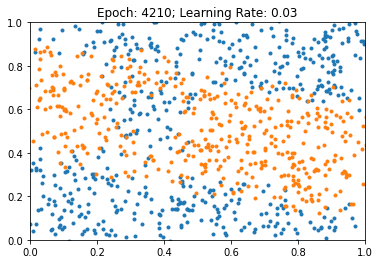

Beta-Gerade: nan
Beta-AND: nan


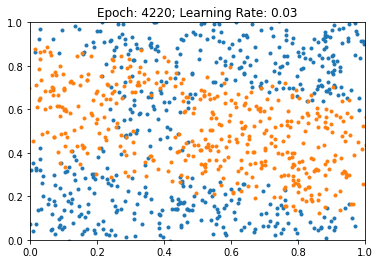

Beta-Gerade: nan
Beta-AND: nan


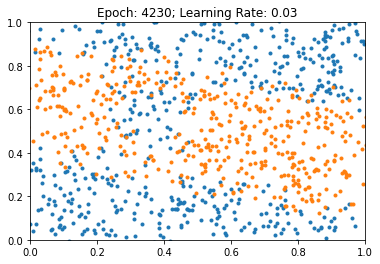

Beta-Gerade: nan
Beta-AND: nan


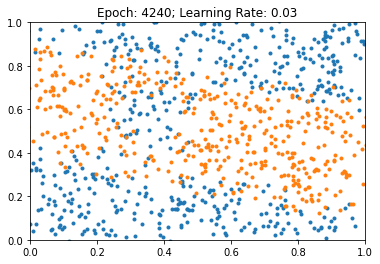

Beta-Gerade: nan
Beta-AND: nan


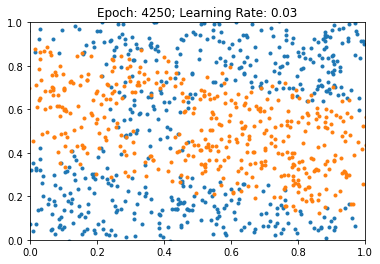

Beta-Gerade: nan
Beta-AND: nan


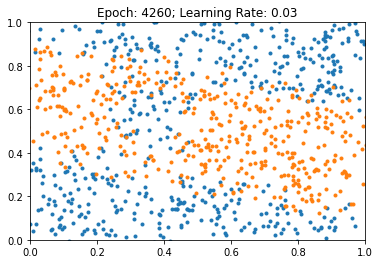

Beta-Gerade: nan
Beta-AND: nan


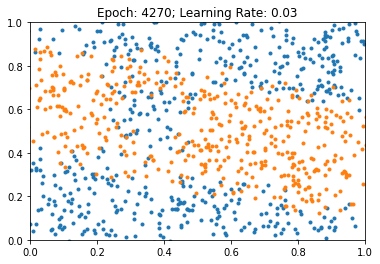

Beta-Gerade: nan
Beta-AND: nan


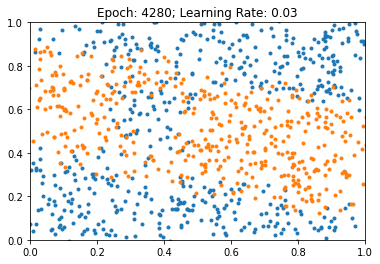

Beta-Gerade: nan
Beta-AND: nan


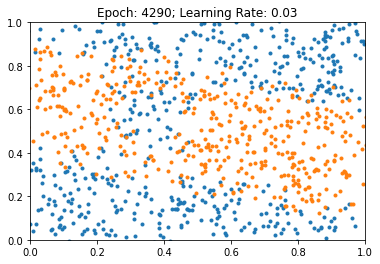

Beta-Gerade: nan
Beta-AND: nan


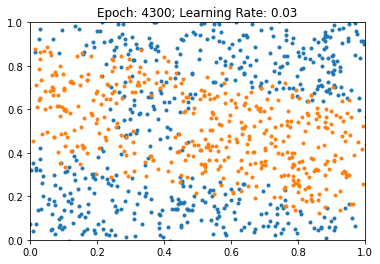

Beta-Gerade: nan
Beta-AND: nan


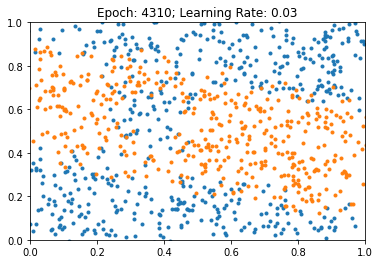

Beta-Gerade: nan
Beta-AND: nan


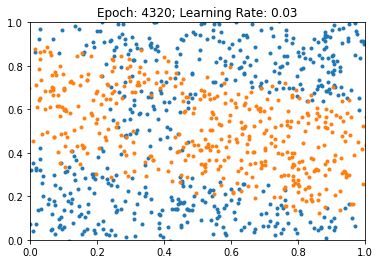

Beta-Gerade: nan
Beta-AND: nan


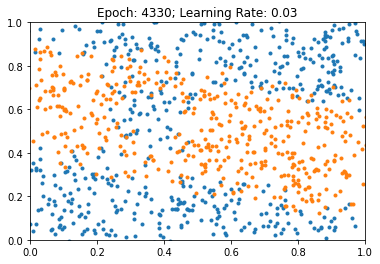

Beta-Gerade: nan
Beta-AND: nan


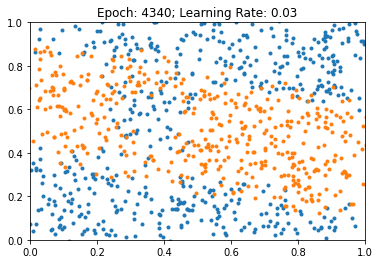

Beta-Gerade: nan
Beta-AND: nan


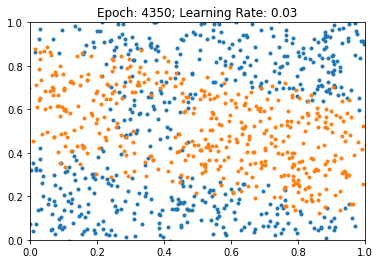

Beta-Gerade: nan
Beta-AND: nan


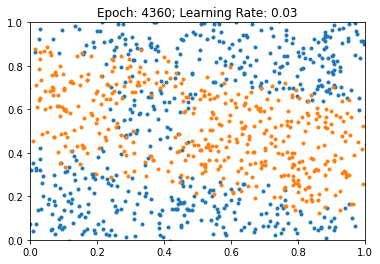

Beta-Gerade: nan
Beta-AND: nan


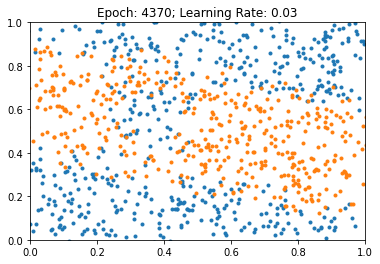

Beta-Gerade: nan
Beta-AND: nan


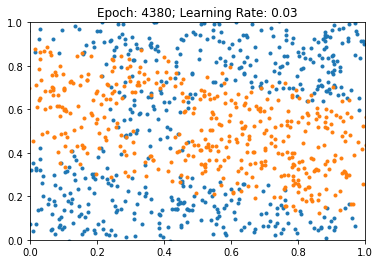

Beta-Gerade: nan
Beta-AND: nan


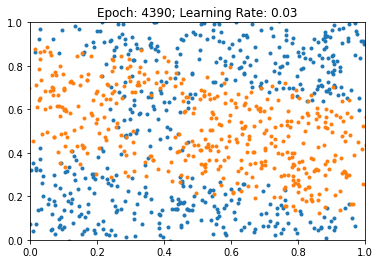

Beta-Gerade: nan
Beta-AND: nan


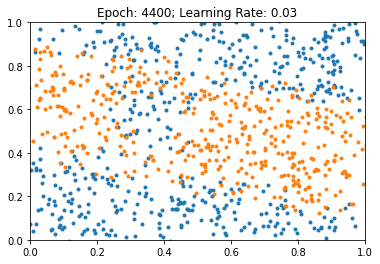

Beta-Gerade: nan
Beta-AND: nan


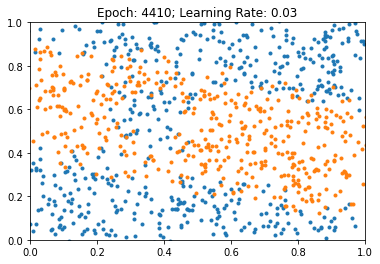

Beta-Gerade: nan
Beta-AND: nan


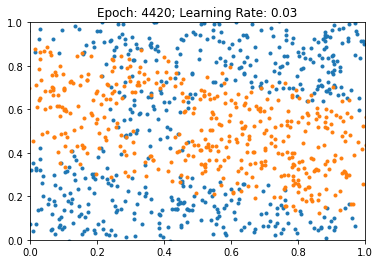

Beta-Gerade: nan
Beta-AND: nan


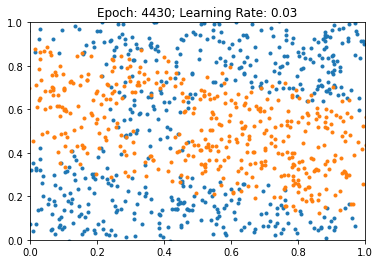

Beta-Gerade: nan
Beta-AND: nan


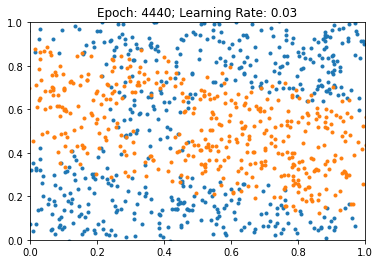

Beta-Gerade: nan
Beta-AND: nan


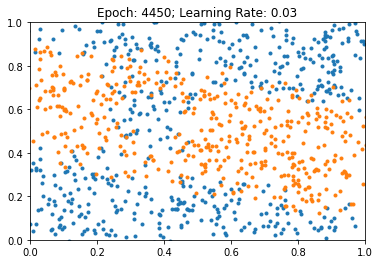

Beta-Gerade: nan
Beta-AND: nan


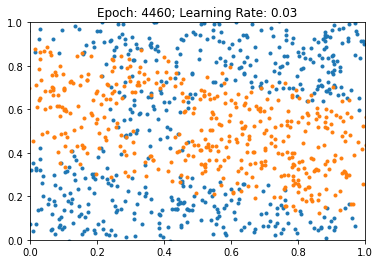

Beta-Gerade: nan
Beta-AND: nan


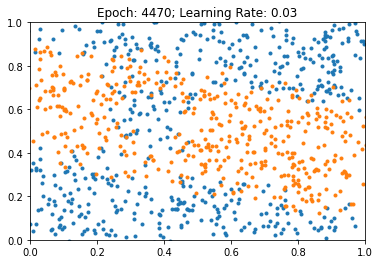

Beta-Gerade: nan
Beta-AND: nan


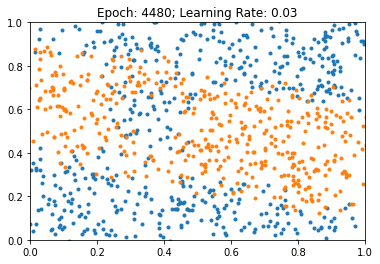

Beta-Gerade: nan
Beta-AND: nan


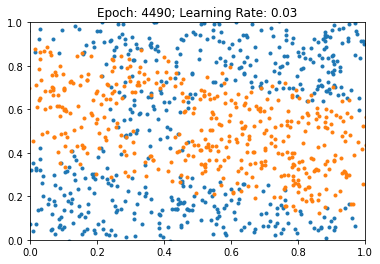

Beta-Gerade: nan
Beta-AND: nan


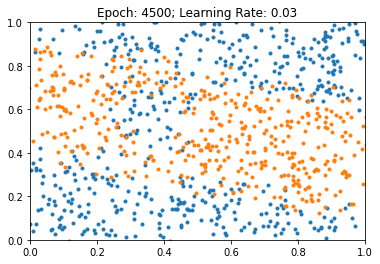

Beta-Gerade: nan
Beta-AND: nan


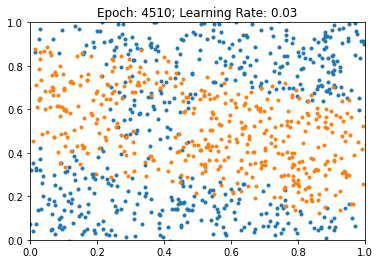

Beta-Gerade: nan
Beta-AND: nan


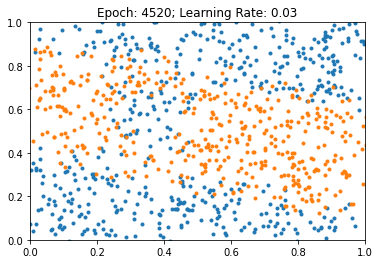

Beta-Gerade: nan
Beta-AND: nan


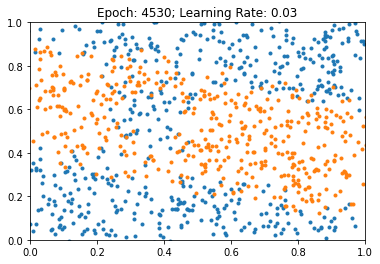

Beta-Gerade: nan
Beta-AND: nan


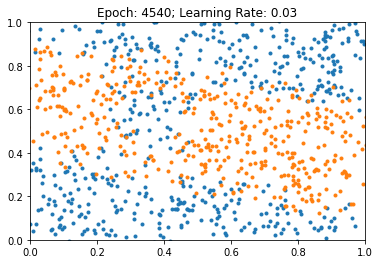

Beta-Gerade: nan
Beta-AND: nan


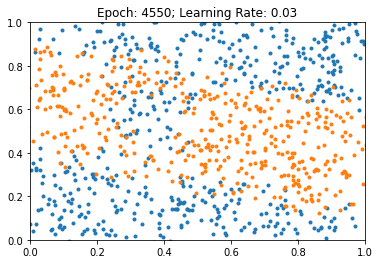

Beta-Gerade: nan
Beta-AND: nan


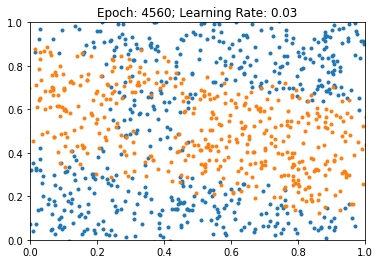

Beta-Gerade: nan
Beta-AND: nan


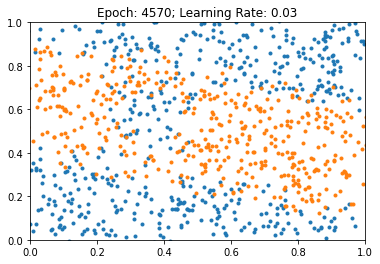

Beta-Gerade: nan
Beta-AND: nan


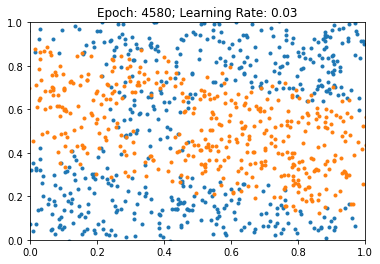

Beta-Gerade: nan
Beta-AND: nan


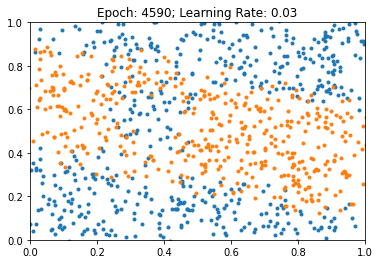

Beta-Gerade: nan
Beta-AND: nan


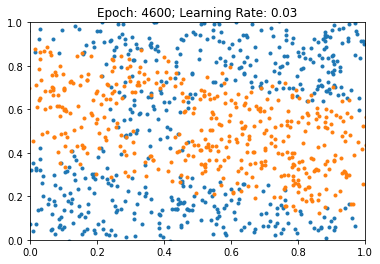

Beta-Gerade: nan
Beta-AND: nan


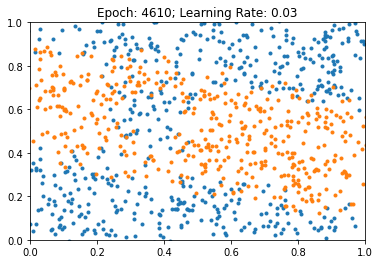

Beta-Gerade: nan
Beta-AND: nan


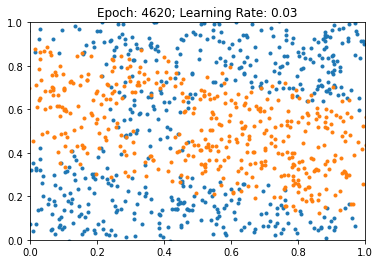

Beta-Gerade: nan
Beta-AND: nan


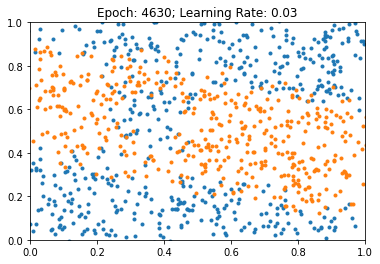

Beta-Gerade: nan
Beta-AND: nan


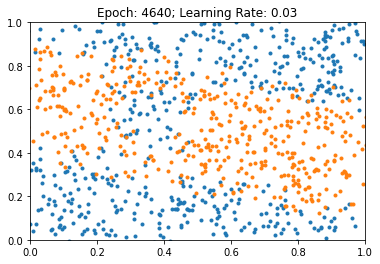

Beta-Gerade: nan
Beta-AND: nan


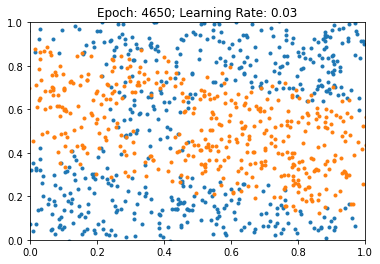

Beta-Gerade: nan
Beta-AND: nan


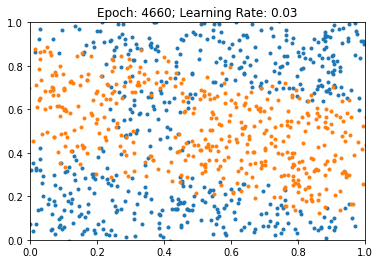

Beta-Gerade: nan
Beta-AND: nan


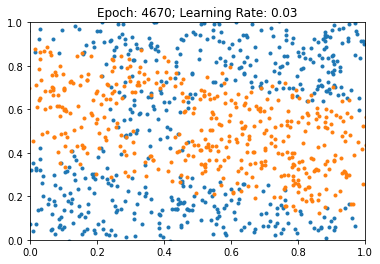

Beta-Gerade: nan
Beta-AND: nan


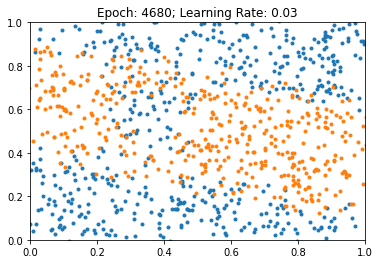

Beta-Gerade: nan
Beta-AND: nan


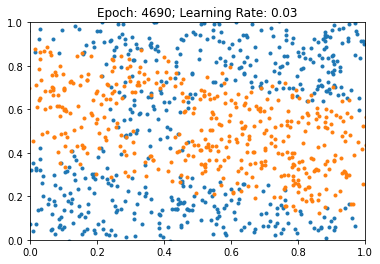

Beta-Gerade: nan
Beta-AND: nan


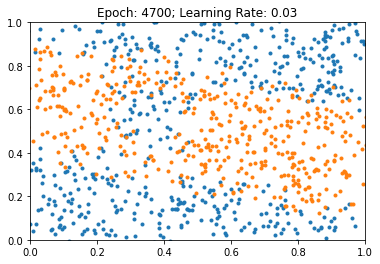

Beta-Gerade: nan
Beta-AND: nan


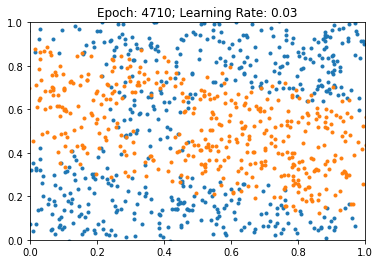

Beta-Gerade: nan
Beta-AND: nan


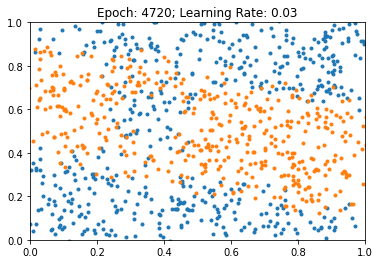

Beta-Gerade: nan
Beta-AND: nan


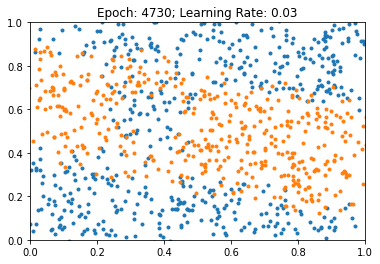

Beta-Gerade: nan
Beta-AND: nan


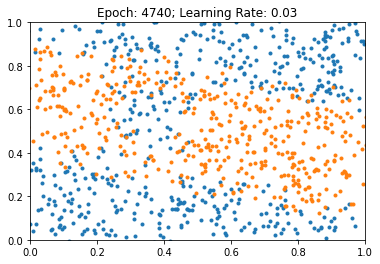

Beta-Gerade: nan
Beta-AND: nan


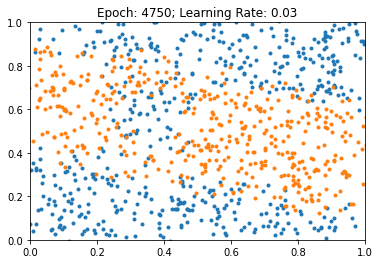

Beta-Gerade: nan
Beta-AND: nan


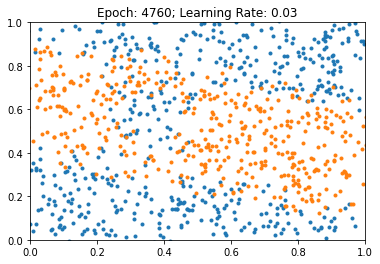

Beta-Gerade: nan
Beta-AND: nan


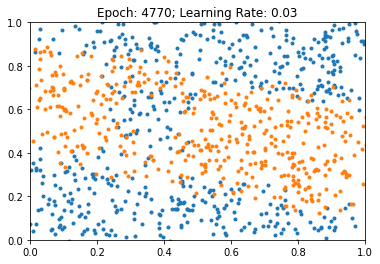

Beta-Gerade: nan
Beta-AND: nan


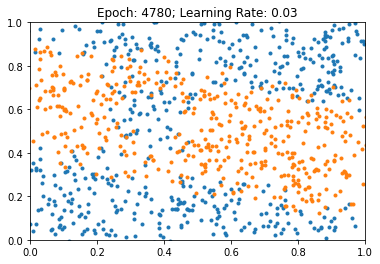

Beta-Gerade: nan
Beta-AND: nan


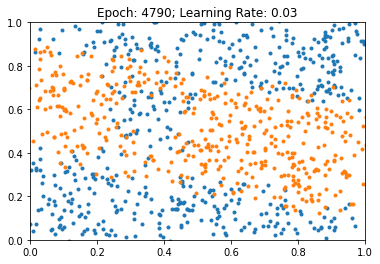

Beta-Gerade: nan
Beta-AND: nan


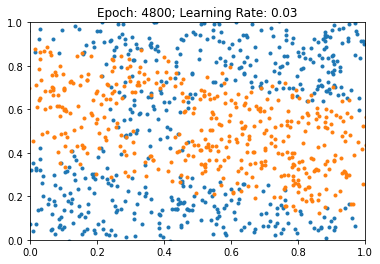

Beta-Gerade: nan
Beta-AND: nan


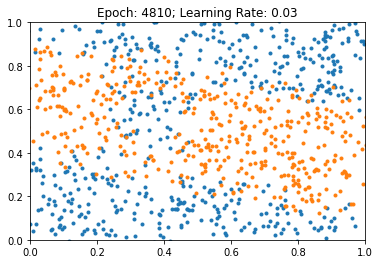

Beta-Gerade: nan
Beta-AND: nan


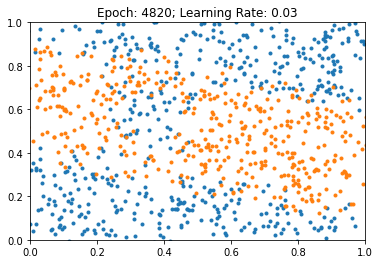

Beta-Gerade: nan
Beta-AND: nan


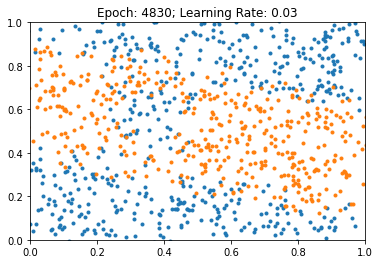

Beta-Gerade: nan
Beta-AND: nan


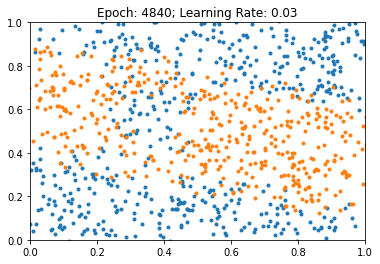

Beta-Gerade: nan
Beta-AND: nan


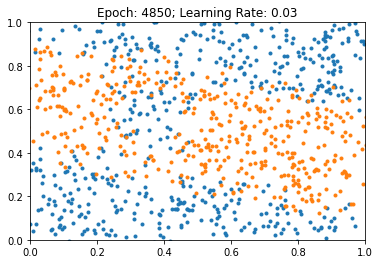

Beta-Gerade: nan
Beta-AND: nan


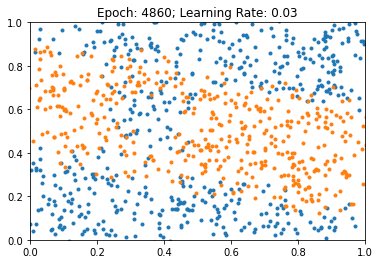

Beta-Gerade: nan
Beta-AND: nan


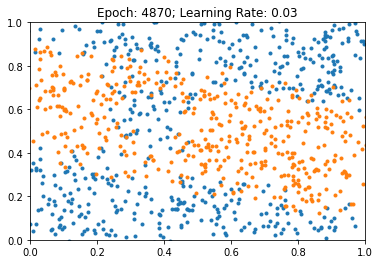

Beta-Gerade: nan
Beta-AND: nan


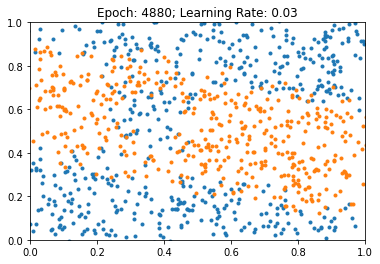

Beta-Gerade: nan
Beta-AND: nan


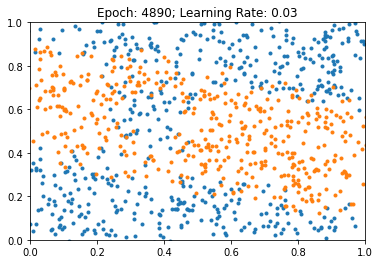

Beta-Gerade: nan
Beta-AND: nan


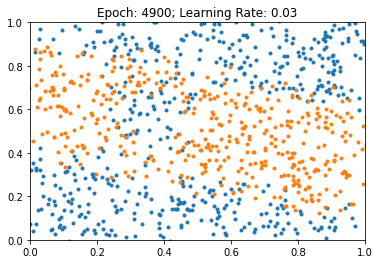

Beta-Gerade: nan
Beta-AND: nan


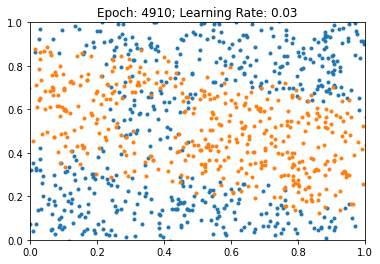

Beta-Gerade: nan
Beta-AND: nan


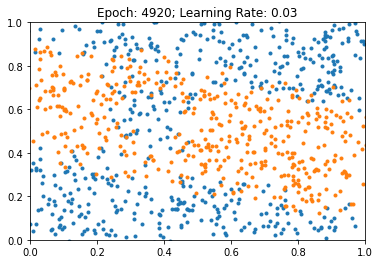

Beta-Gerade: nan
Beta-AND: nan


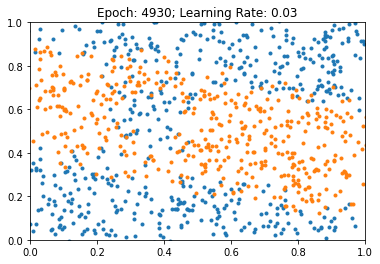

Beta-Gerade: nan
Beta-AND: nan


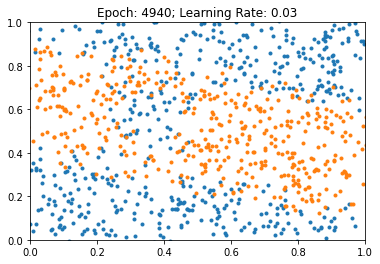

Beta-Gerade: nan
Beta-AND: nan


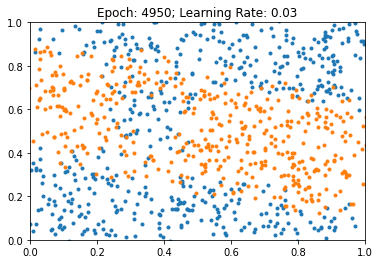

Beta-Gerade: nan
Beta-AND: nan


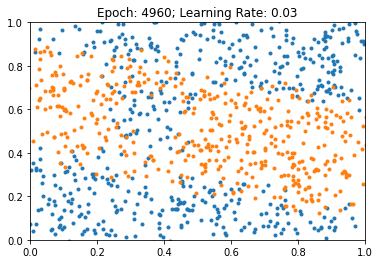

Beta-Gerade: nan
Beta-AND: nan


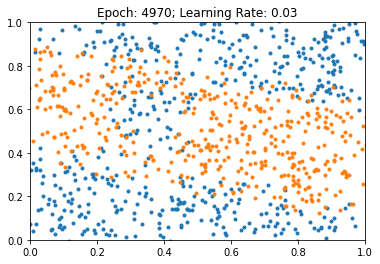

Beta-Gerade: nan
Beta-AND: nan


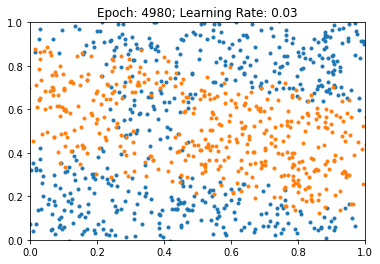

Beta-Gerade: nan
Beta-AND: nan


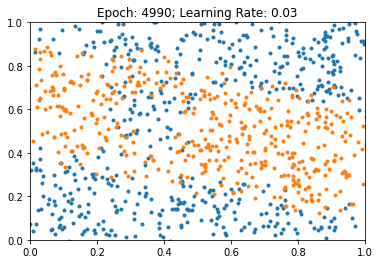

Beta-Gerade: nan
Beta-AND: nan


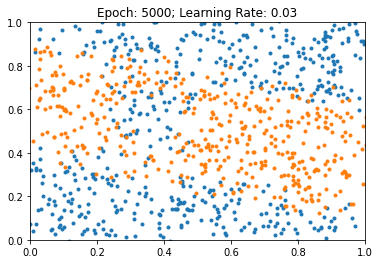

Beta-Gerade: nan
Beta-AND: nan


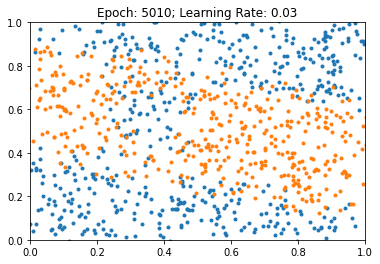

Beta-Gerade: nan
Beta-AND: nan


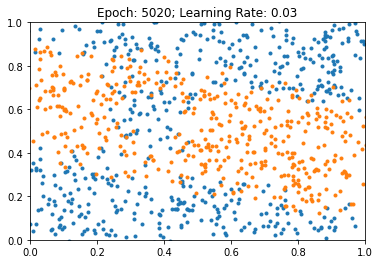

Beta-Gerade: nan
Beta-AND: nan


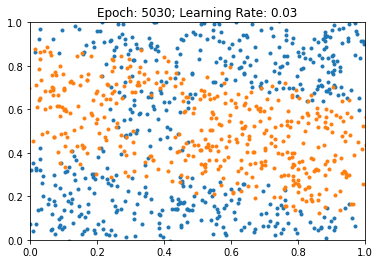

Beta-Gerade: nan
Beta-AND: nan


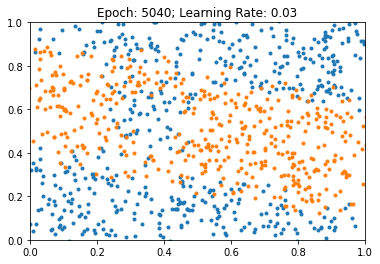

Beta-Gerade: nan
Beta-AND: nan


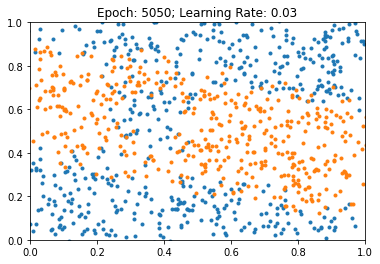

Beta-Gerade: nan
Beta-AND: nan


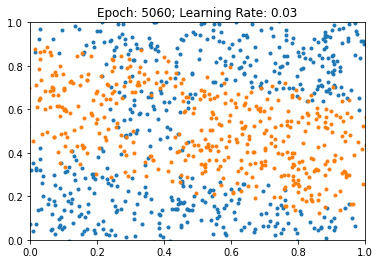

Beta-Gerade: nan
Beta-AND: nan


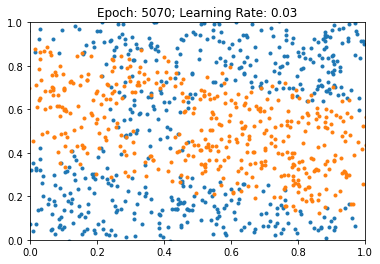

Beta-Gerade: nan
Beta-AND: nan


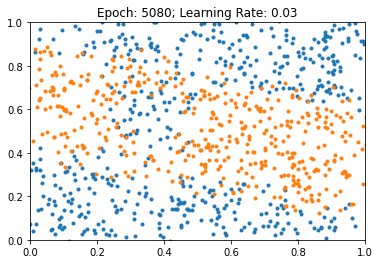

Beta-Gerade: nan
Beta-AND: nan


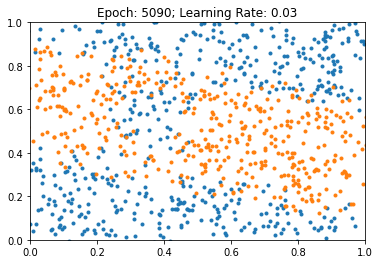

Beta-Gerade: nan
Beta-AND: nan


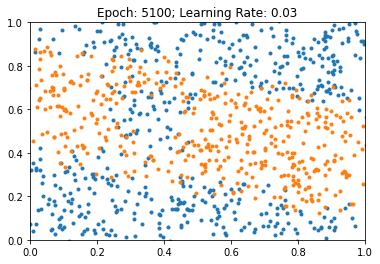

Beta-Gerade: nan
Beta-AND: nan


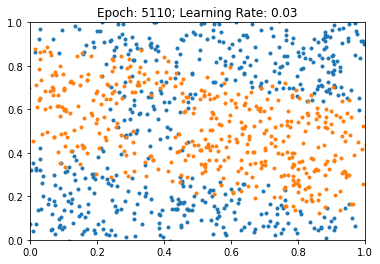

Beta-Gerade: nan
Beta-AND: nan


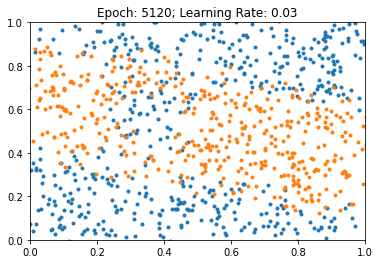

Beta-Gerade: nan
Beta-AND: nan


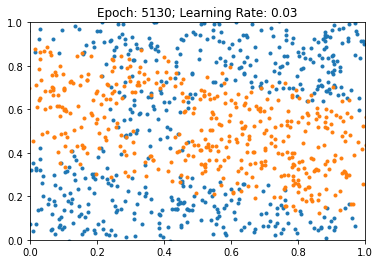

Beta-Gerade: nan
Beta-AND: nan


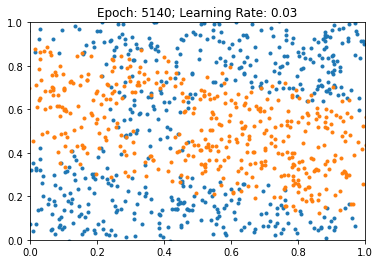

Beta-Gerade: nan
Beta-AND: nan


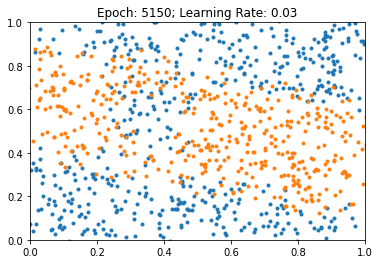

Beta-Gerade: nan
Beta-AND: nan


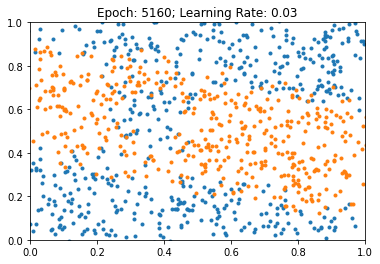

Beta-Gerade: nan
Beta-AND: nan


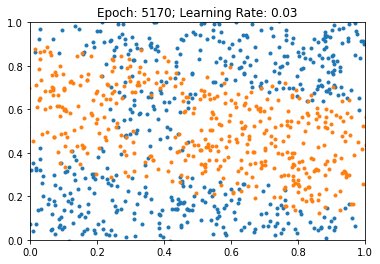

Beta-Gerade: nan
Beta-AND: nan


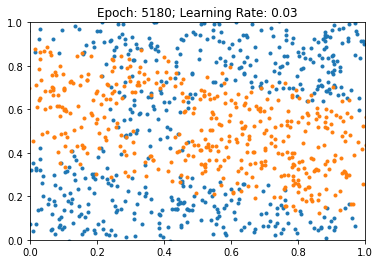

Beta-Gerade: nan
Beta-AND: nan


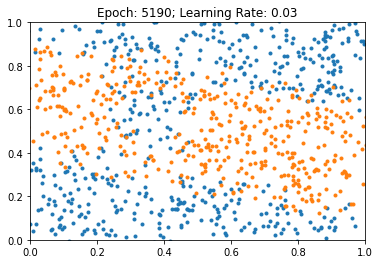

Beta-Gerade: nan
Beta-AND: nan


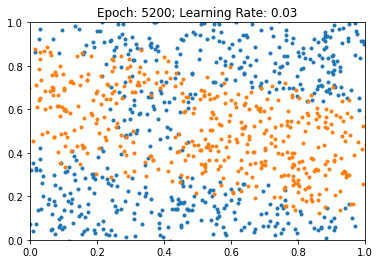

Beta-Gerade: nan
Beta-AND: nan


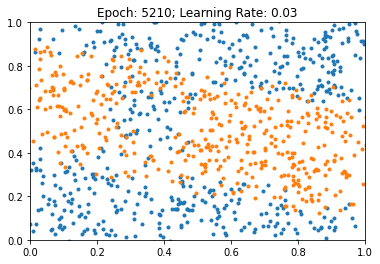

Beta-Gerade: nan
Beta-AND: nan


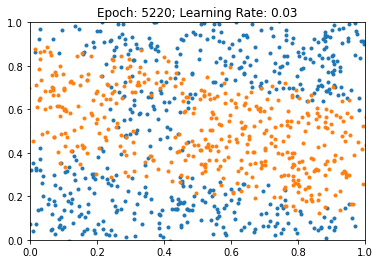

Beta-Gerade: nan
Beta-AND: nan


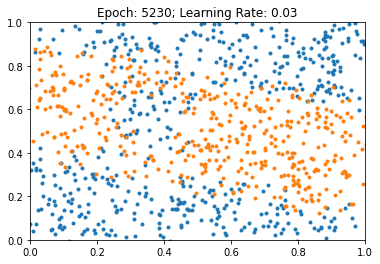

Beta-Gerade: nan
Beta-AND: nan


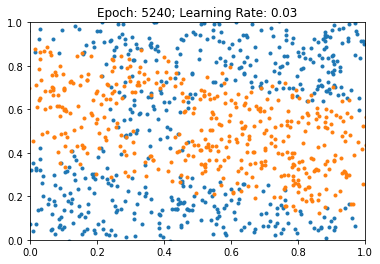

Beta-Gerade: nan
Beta-AND: nan


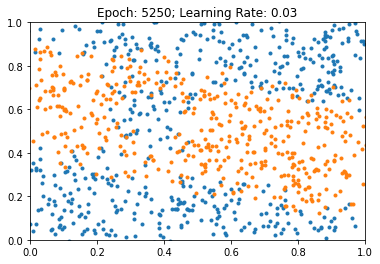

Beta-Gerade: nan
Beta-AND: nan


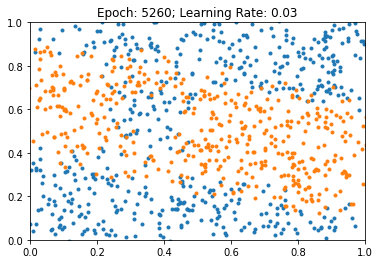

Beta-Gerade: nan
Beta-AND: nan


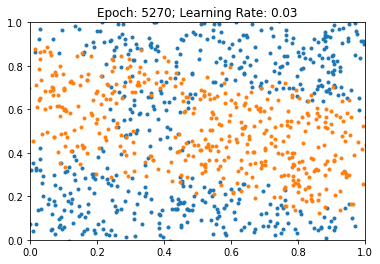

Beta-Gerade: nan
Beta-AND: nan


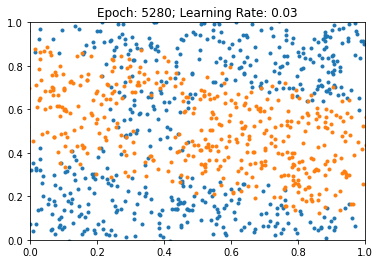

Beta-Gerade: nan
Beta-AND: nan


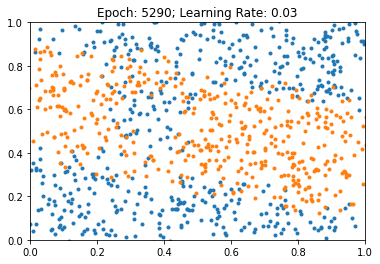

Beta-Gerade: nan
Beta-AND: nan


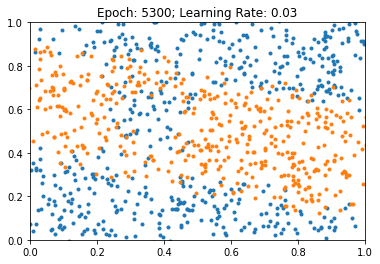

Beta-Gerade: nan
Beta-AND: nan


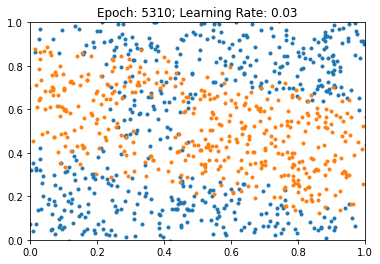

Beta-Gerade: nan
Beta-AND: nan


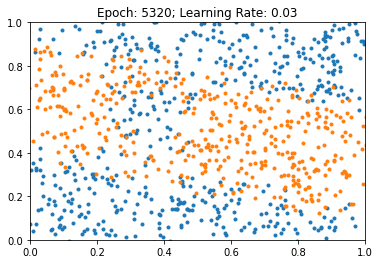

Beta-Gerade: nan
Beta-AND: nan


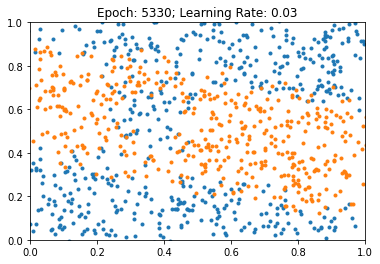

Beta-Gerade: nan
Beta-AND: nan


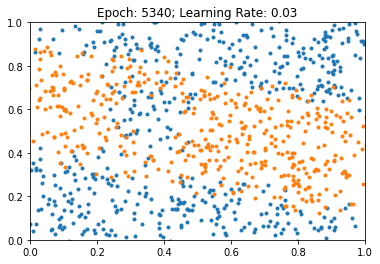

Beta-Gerade: nan
Beta-AND: nan


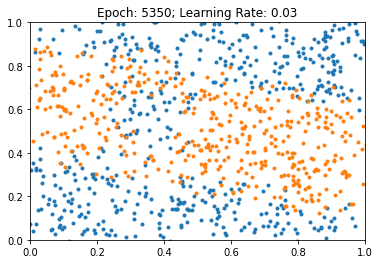

Beta-Gerade: nan
Beta-AND: nan


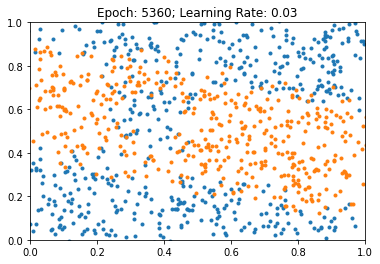

Beta-Gerade: nan
Beta-AND: nan


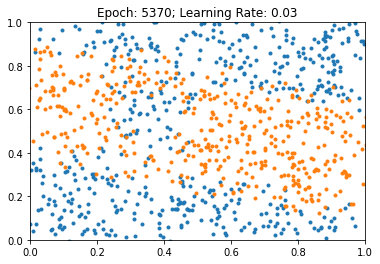

Beta-Gerade: nan
Beta-AND: nan


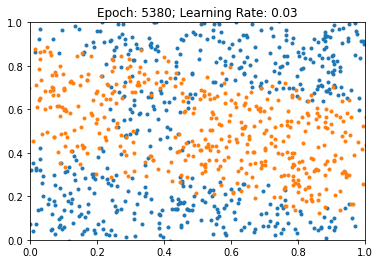

Beta-Gerade: nan
Beta-AND: nan


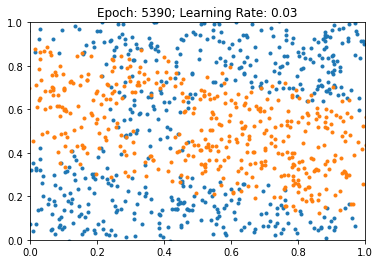

Beta-Gerade: nan
Beta-AND: nan


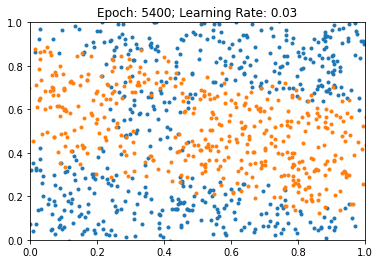

Beta-Gerade: nan
Beta-AND: nan


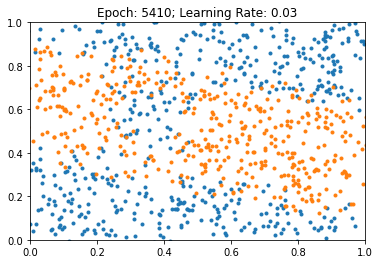

Beta-Gerade: nan
Beta-AND: nan


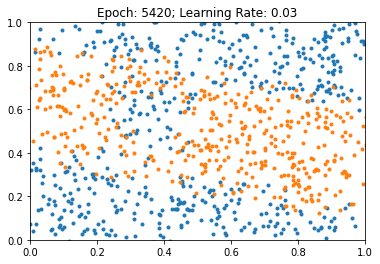

Beta-Gerade: nan
Beta-AND: nan


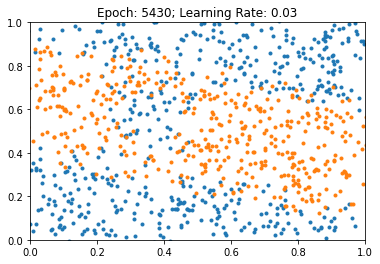

Beta-Gerade: nan
Beta-AND: nan


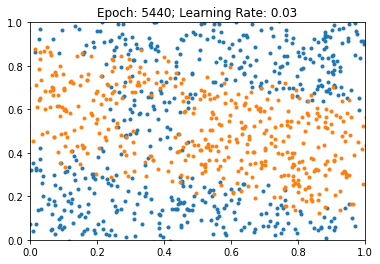

Beta-Gerade: nan
Beta-AND: nan


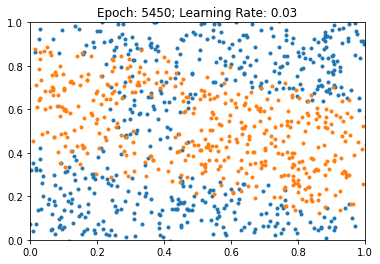

Beta-Gerade: nan
Beta-AND: nan


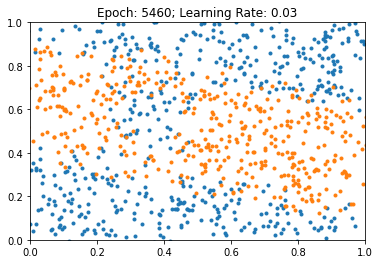

Beta-Gerade: nan
Beta-AND: nan


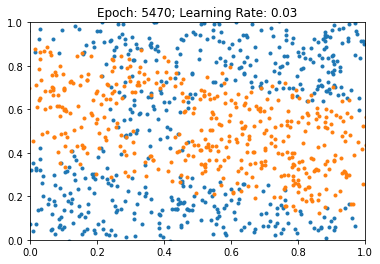

Beta-Gerade: nan
Beta-AND: nan


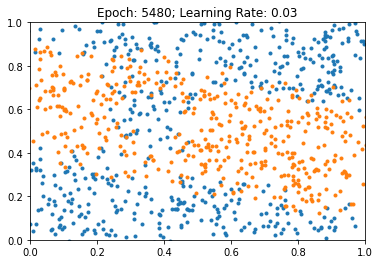

Beta-Gerade: nan
Beta-AND: nan


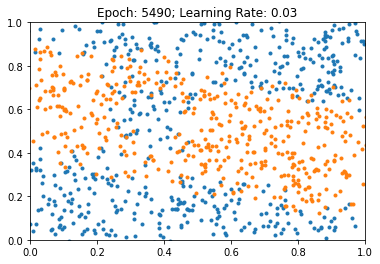

Beta-Gerade: nan
Beta-AND: nan


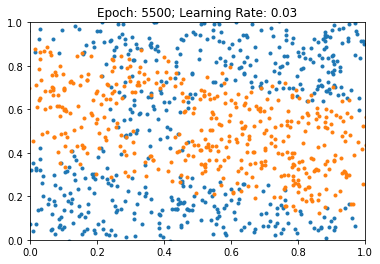

Beta-Gerade: nan
Beta-AND: nan


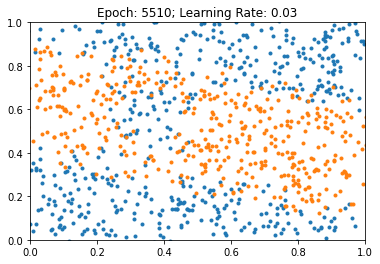

Beta-Gerade: nan
Beta-AND: nan


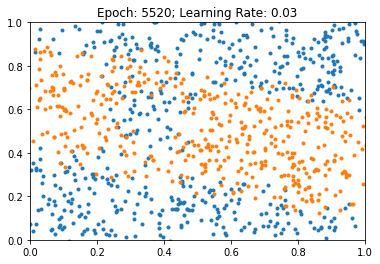

Beta-Gerade: nan
Beta-AND: nan


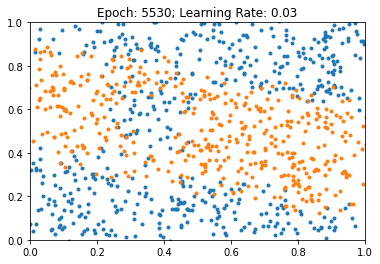

Beta-Gerade: nan
Beta-AND: nan


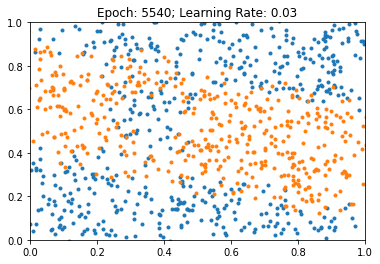

Beta-Gerade: nan
Beta-AND: nan


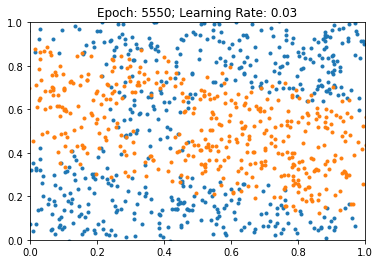

Beta-Gerade: nan
Beta-AND: nan


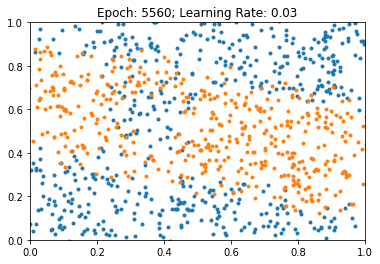

Beta-Gerade: nan
Beta-AND: nan


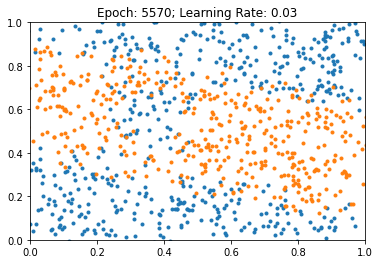

Beta-Gerade: nan
Beta-AND: nan


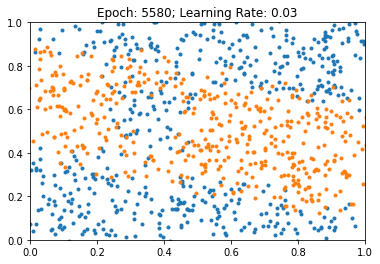

Beta-Gerade: nan
Beta-AND: nan


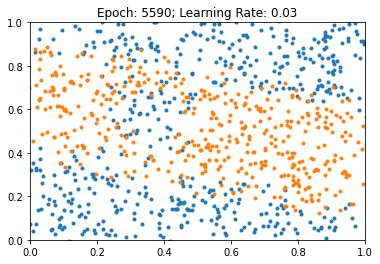

Beta-Gerade: nan
Beta-AND: nan


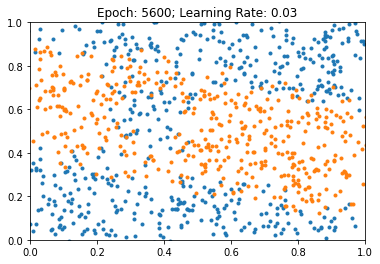

Beta-Gerade: nan
Beta-AND: nan


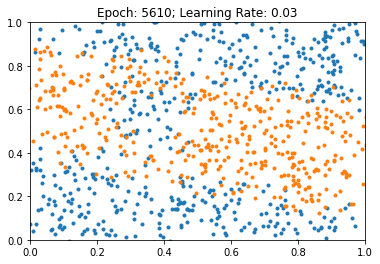

Beta-Gerade: nan
Beta-AND: nan


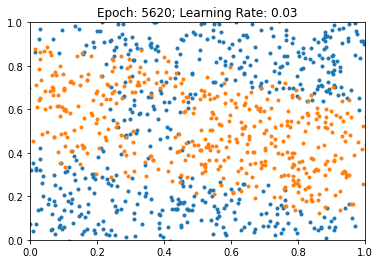

Beta-Gerade: nan
Beta-AND: nan


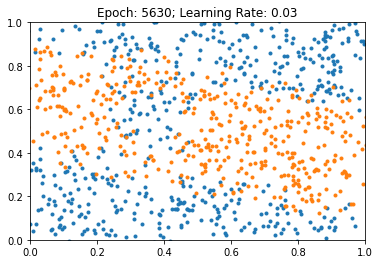

Beta-Gerade: nan
Beta-AND: nan


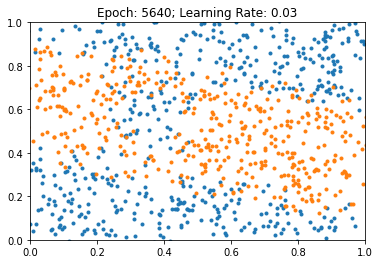

Beta-Gerade: nan
Beta-AND: nan


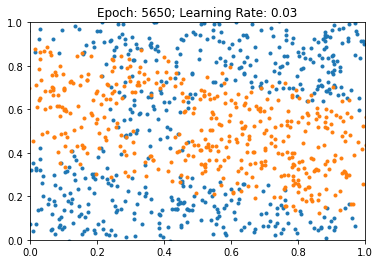

Beta-Gerade: nan
Beta-AND: nan


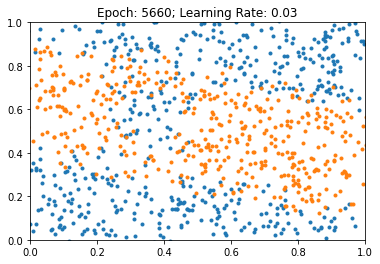

Beta-Gerade: nan
Beta-AND: nan


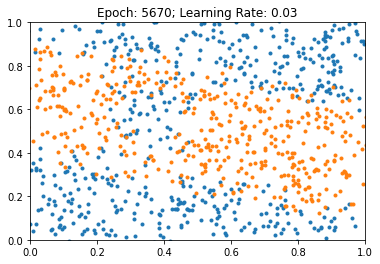

Beta-Gerade: nan
Beta-AND: nan


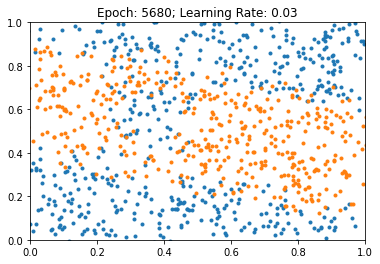

Beta-Gerade: nan
Beta-AND: nan


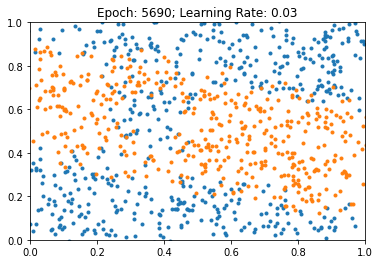

Beta-Gerade: nan
Beta-AND: nan


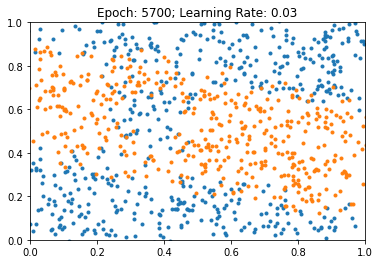

Beta-Gerade: nan
Beta-AND: nan


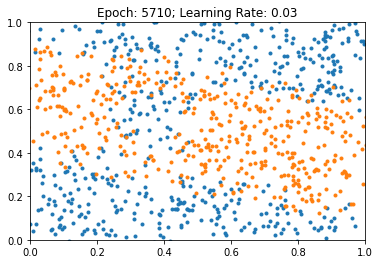

Beta-Gerade: nan
Beta-AND: nan


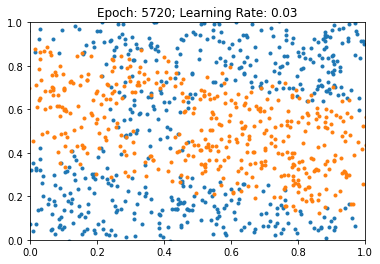

Beta-Gerade: nan
Beta-AND: nan


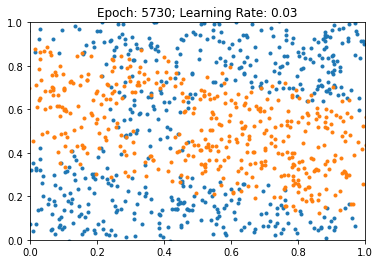

Beta-Gerade: nan
Beta-AND: nan


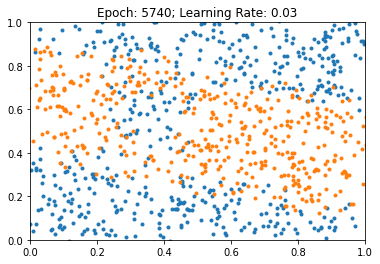

Beta-Gerade: nan
Beta-AND: nan


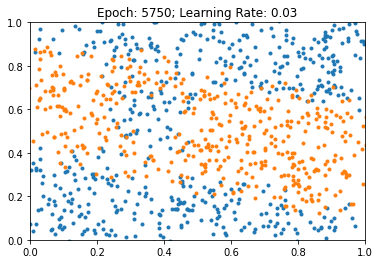

Beta-Gerade: nan
Beta-AND: nan


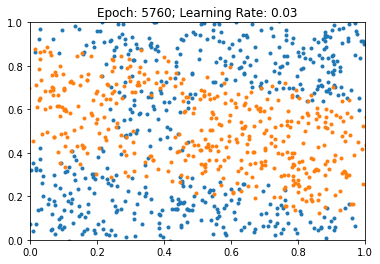

Beta-Gerade: nan
Beta-AND: nan


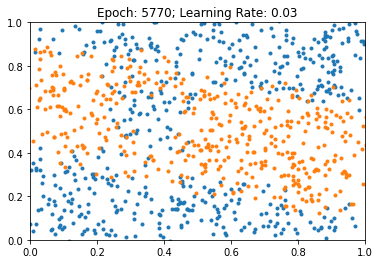

Beta-Gerade: nan
Beta-AND: nan


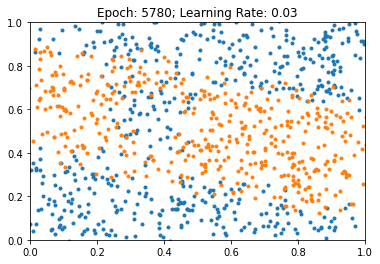

Beta-Gerade: nan
Beta-AND: nan


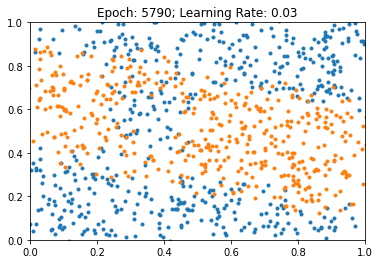

Beta-Gerade: nan
Beta-AND: nan


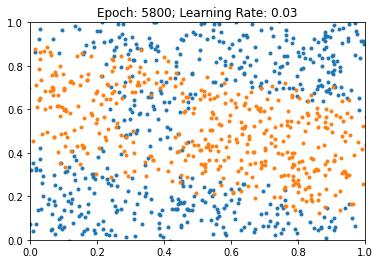

Beta-Gerade: nan
Beta-AND: nan


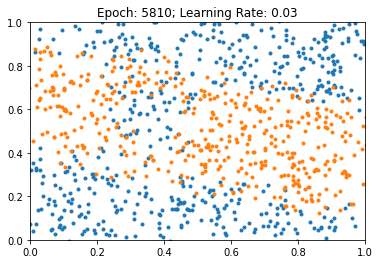

Beta-Gerade: nan
Beta-AND: nan


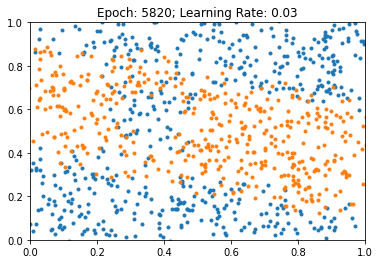

Beta-Gerade: nan
Beta-AND: nan


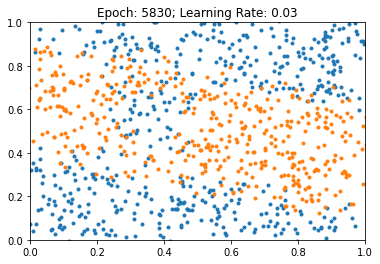

Beta-Gerade: nan
Beta-AND: nan


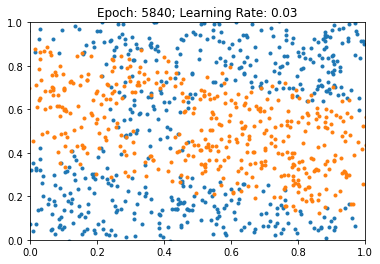

Beta-Gerade: nan
Beta-AND: nan


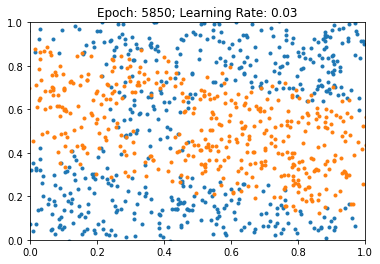

Beta-Gerade: nan
Beta-AND: nan


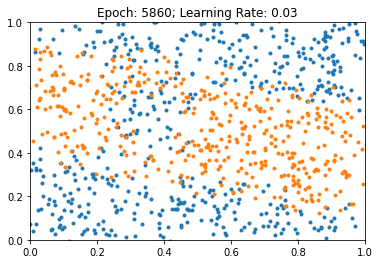

Beta-Gerade: nan
Beta-AND: nan


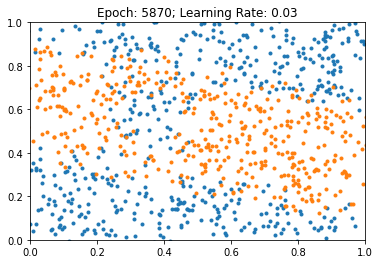

Beta-Gerade: nan
Beta-AND: nan


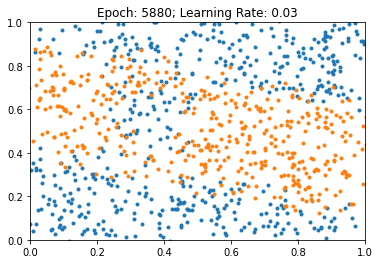

Beta-Gerade: nan
Beta-AND: nan


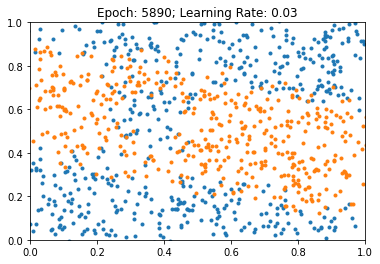

Beta-Gerade: nan
Beta-AND: nan


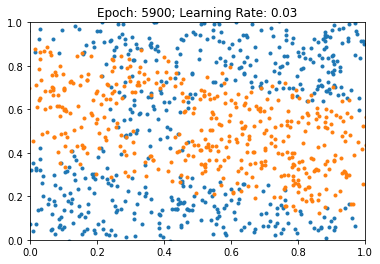

Beta-Gerade: nan
Beta-AND: nan


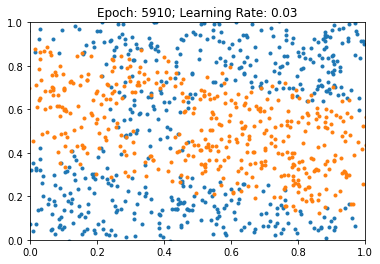

Beta-Gerade: nan
Beta-AND: nan


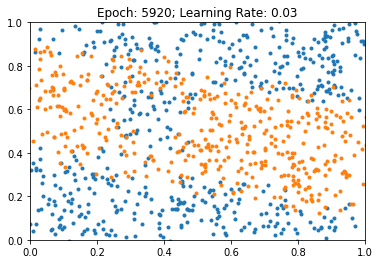

Beta-Gerade: nan
Beta-AND: nan


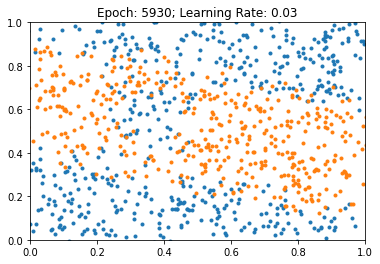

Beta-Gerade: nan
Beta-AND: nan


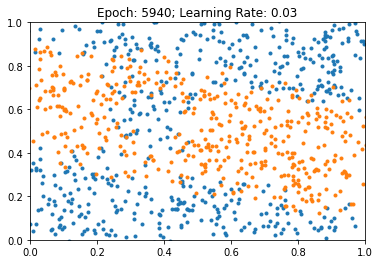

Beta-Gerade: nan
Beta-AND: nan


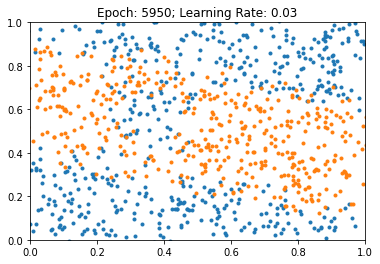

Beta-Gerade: nan
Beta-AND: nan


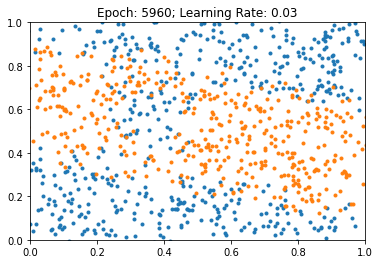

Beta-Gerade: nan
Beta-AND: nan


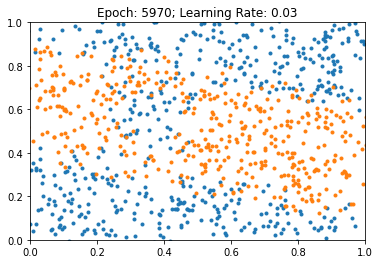

Beta-Gerade: nan
Beta-AND: nan


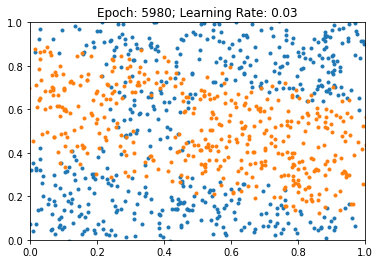

Beta-Gerade: nan
Beta-AND: nan


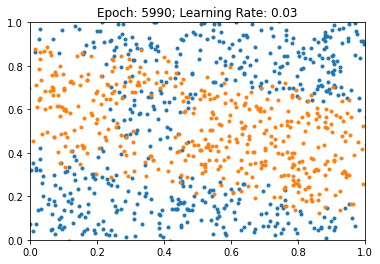

Beta-Gerade: nan
Beta-AND: nan


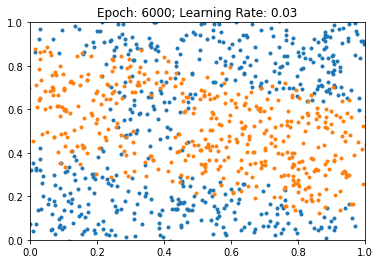

Beta-Gerade: nan
Beta-AND: nan


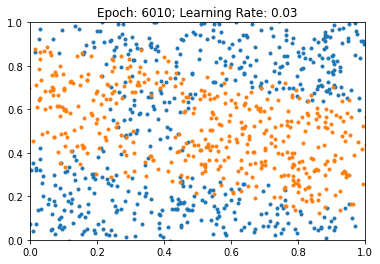

Beta-Gerade: nan
Beta-AND: nan


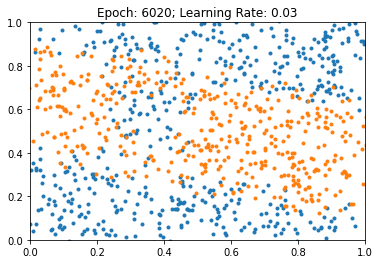

Beta-Gerade: nan
Beta-AND: nan


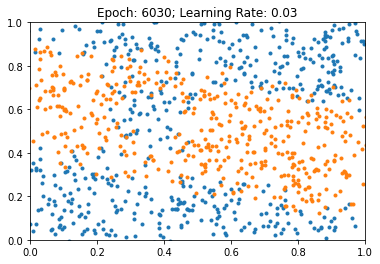

Beta-Gerade: nan
Beta-AND: nan


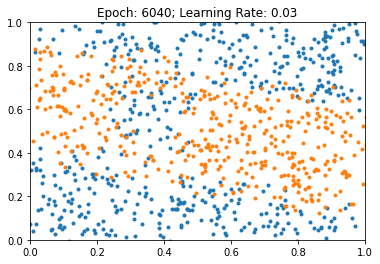

Beta-Gerade: nan
Beta-AND: nan


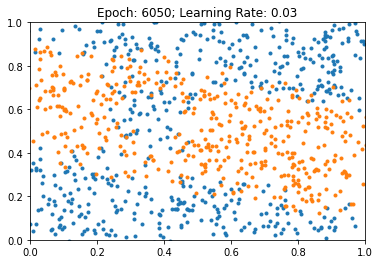

Beta-Gerade: nan
Beta-AND: nan


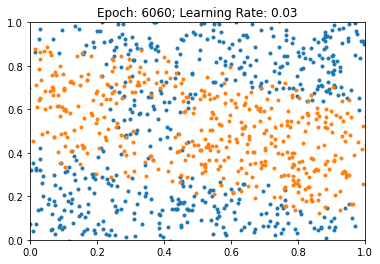

Beta-Gerade: nan
Beta-AND: nan


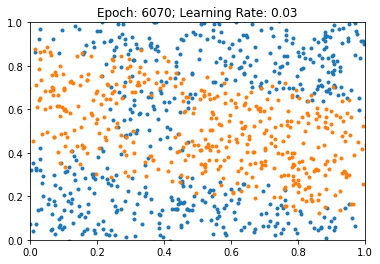

Beta-Gerade: nan
Beta-AND: nan


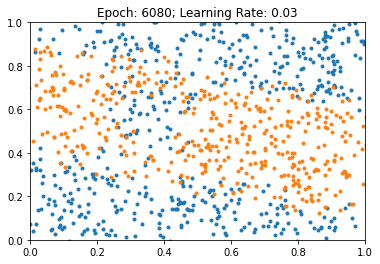

Beta-Gerade: nan
Beta-AND: nan


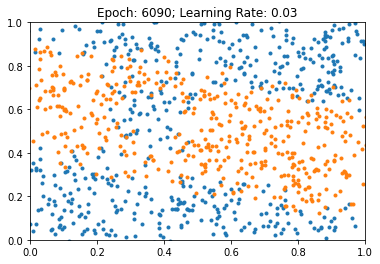

Beta-Gerade: nan
Beta-AND: nan


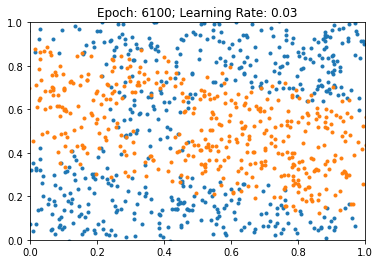

Beta-Gerade: nan
Beta-AND: nan


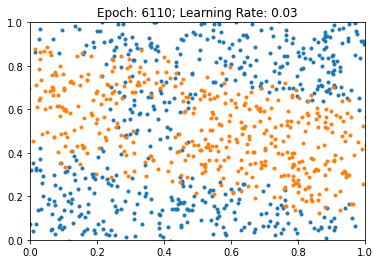

Beta-Gerade: nan
Beta-AND: nan


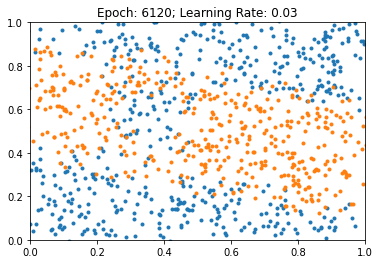

Beta-Gerade: nan
Beta-AND: nan


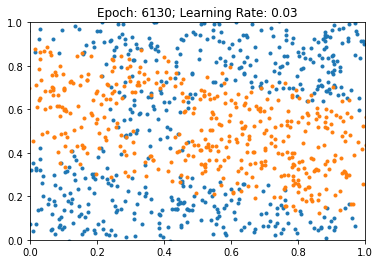

Beta-Gerade: nan
Beta-AND: nan


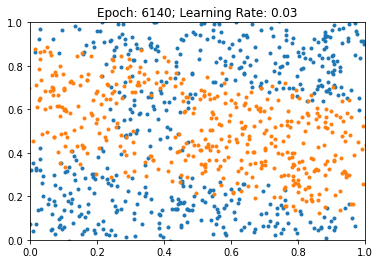

Beta-Gerade: nan
Beta-AND: nan


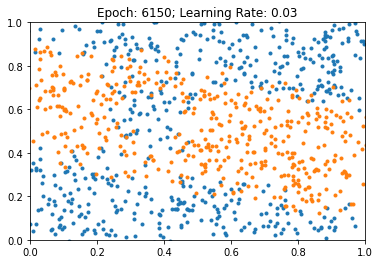

Beta-Gerade: nan
Beta-AND: nan


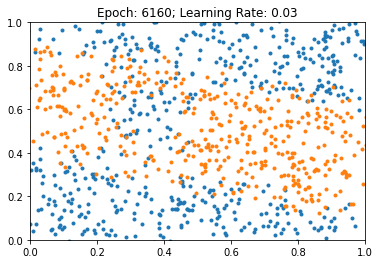

Beta-Gerade: nan
Beta-AND: nan


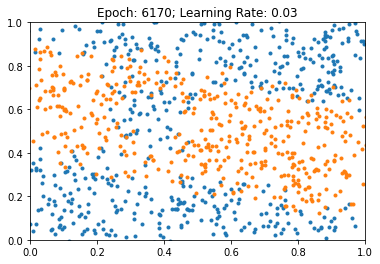

Beta-Gerade: nan
Beta-AND: nan


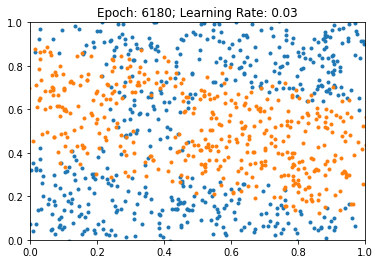

Beta-Gerade: nan
Beta-AND: nan


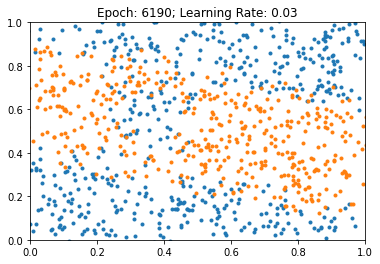

Beta-Gerade: nan
Beta-AND: nan


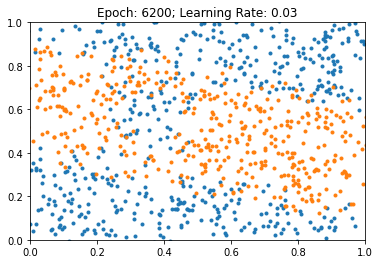

Beta-Gerade: nan
Beta-AND: nan


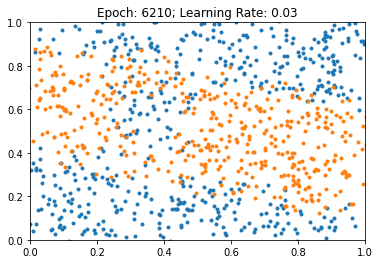

Beta-Gerade: nan
Beta-AND: nan


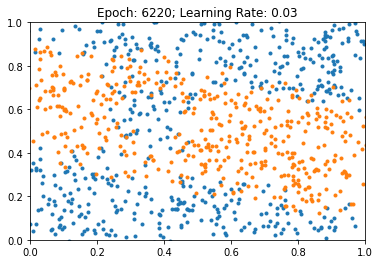

Beta-Gerade: nan
Beta-AND: nan


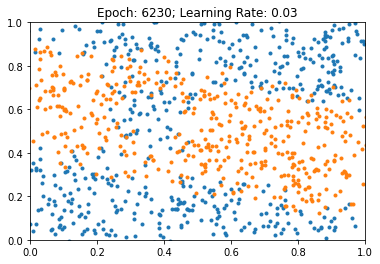

Beta-Gerade: nan
Beta-AND: nan


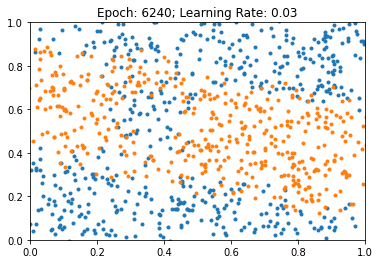

Beta-Gerade: nan
Beta-AND: nan


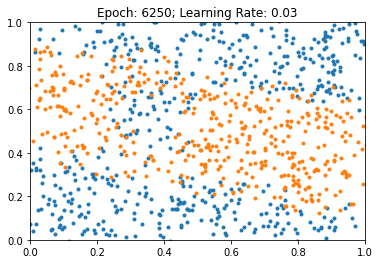

Beta-Gerade: nan
Beta-AND: nan


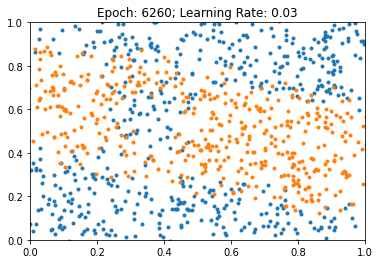

Beta-Gerade: nan
Beta-AND: nan


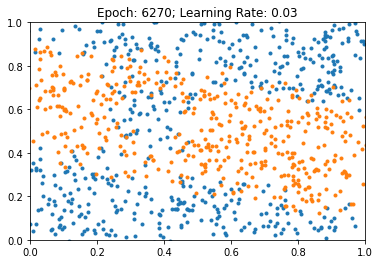

Beta-Gerade: nan
Beta-AND: nan


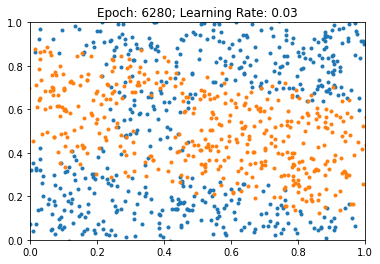

Beta-Gerade: nan
Beta-AND: nan


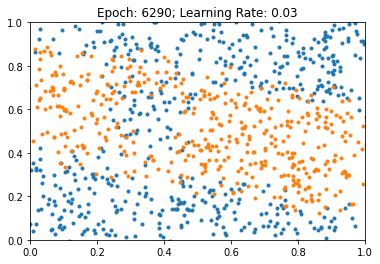

Beta-Gerade: nan
Beta-AND: nan


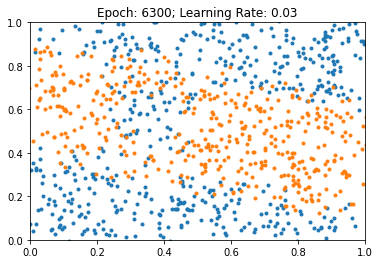

Beta-Gerade: nan
Beta-AND: nan


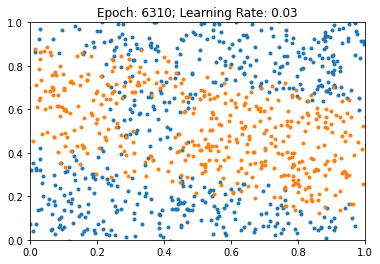

Beta-Gerade: nan
Beta-AND: nan


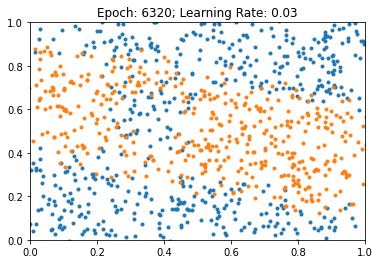

Beta-Gerade: nan
Beta-AND: nan


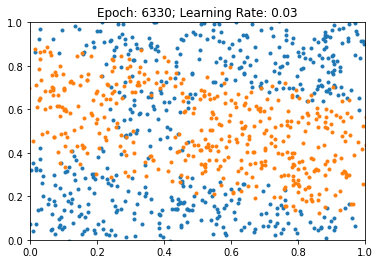

Beta-Gerade: nan
Beta-AND: nan


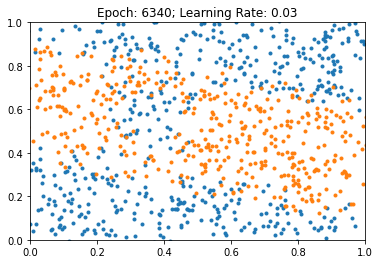

Beta-Gerade: nan
Beta-AND: nan


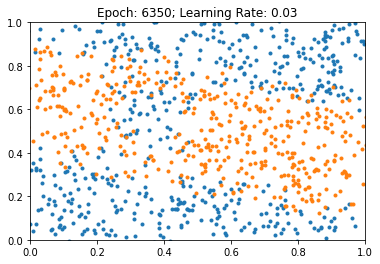

Beta-Gerade: nan
Beta-AND: nan


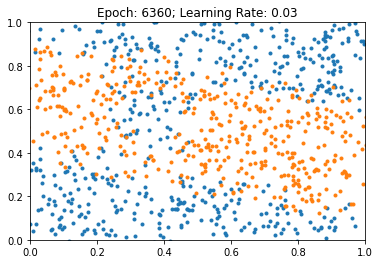

Beta-Gerade: nan
Beta-AND: nan


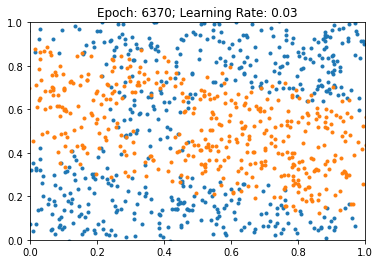

Beta-Gerade: nan
Beta-AND: nan


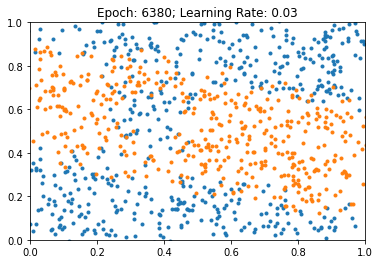

Beta-Gerade: nan
Beta-AND: nan


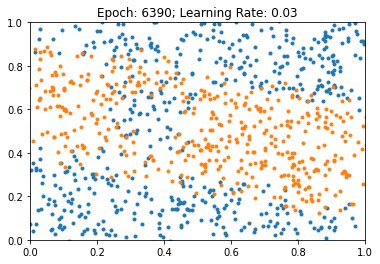

Beta-Gerade: nan
Beta-AND: nan


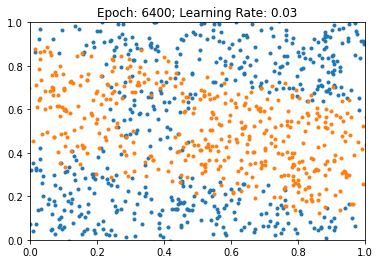

Beta-Gerade: nan
Beta-AND: nan


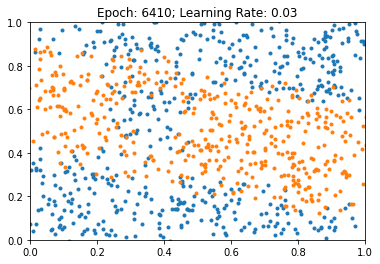

Beta-Gerade: nan
Beta-AND: nan


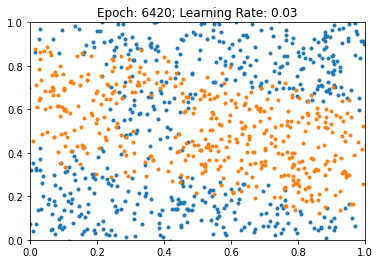

Beta-Gerade: nan
Beta-AND: nan


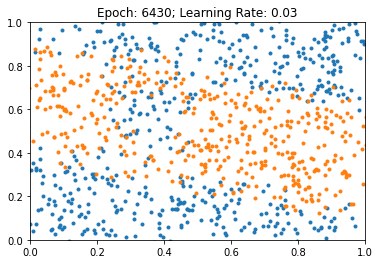

Beta-Gerade: nan
Beta-AND: nan


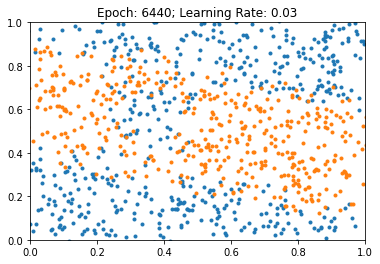

Beta-Gerade: nan
Beta-AND: nan


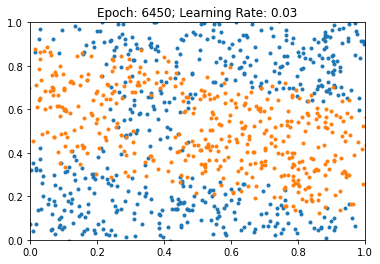

Beta-Gerade: nan
Beta-AND: nan


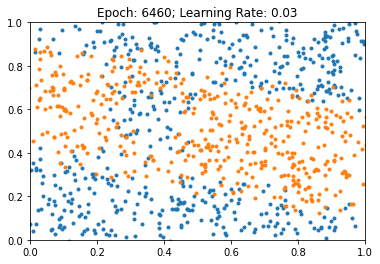

Beta-Gerade: nan
Beta-AND: nan


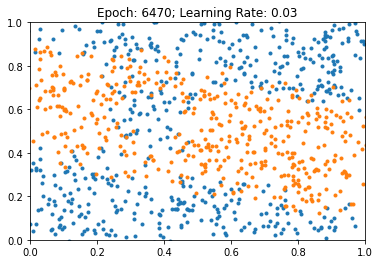

Beta-Gerade: nan
Beta-AND: nan


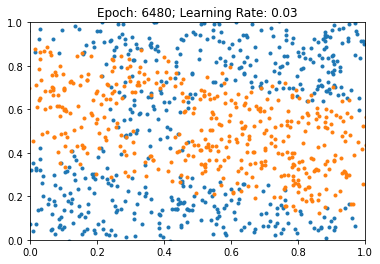

Beta-Gerade: nan
Beta-AND: nan


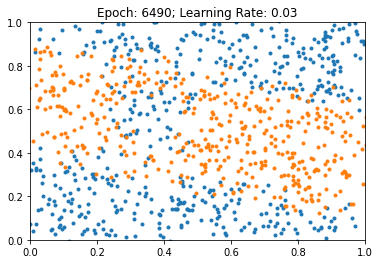

Beta-Gerade: nan
Beta-AND: nan


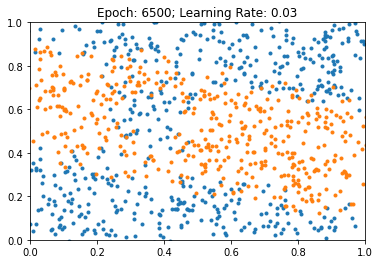

Beta-Gerade: nan
Beta-AND: nan


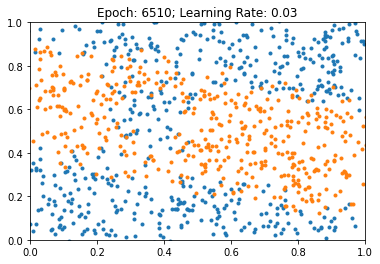

Beta-Gerade: nan
Beta-AND: nan


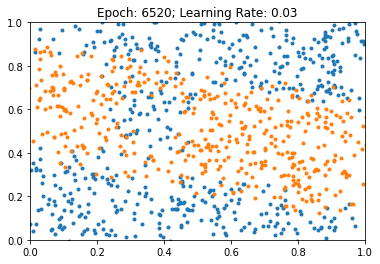

Beta-Gerade: nan
Beta-AND: nan


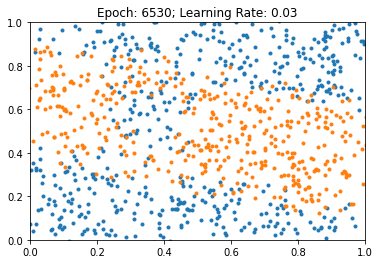

Beta-Gerade: nan
Beta-AND: nan


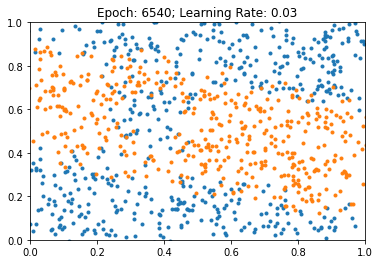

Beta-Gerade: nan
Beta-AND: nan


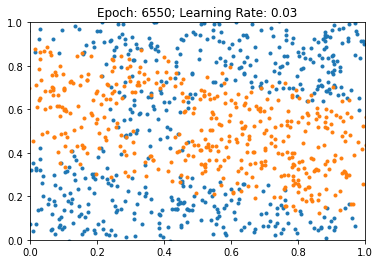

Beta-Gerade: nan
Beta-AND: nan


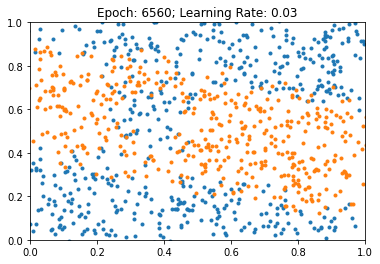

Beta-Gerade: nan
Beta-AND: nan


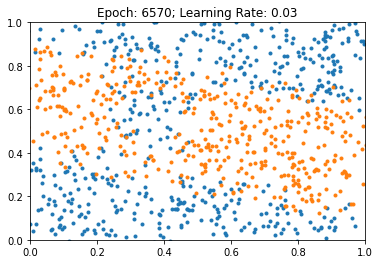

Beta-Gerade: nan
Beta-AND: nan


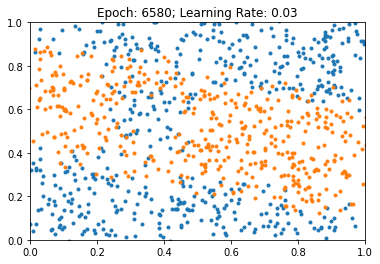

Beta-Gerade: nan
Beta-AND: nan


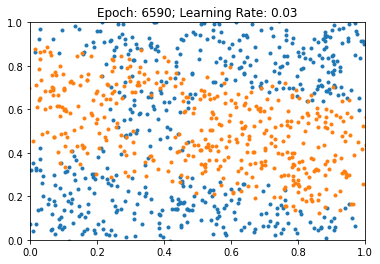

Beta-Gerade: nan
Beta-AND: nan


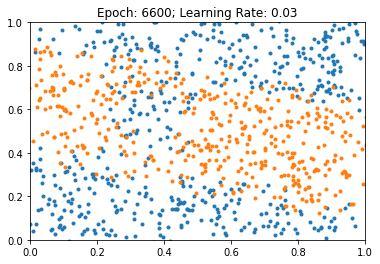

Beta-Gerade: nan
Beta-AND: nan


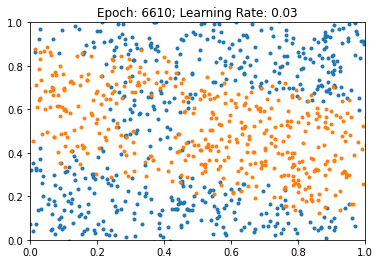

Beta-Gerade: nan
Beta-AND: nan


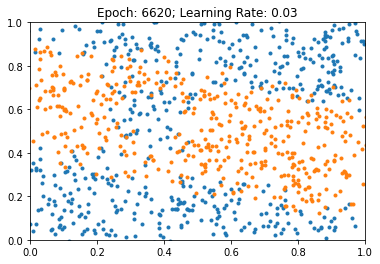

Beta-Gerade: nan
Beta-AND: nan


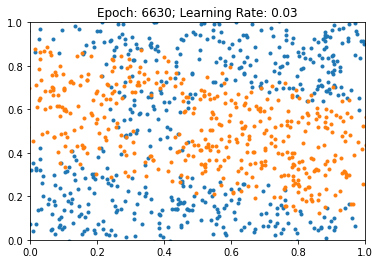

Beta-Gerade: nan
Beta-AND: nan


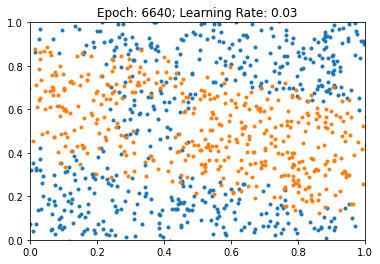

Beta-Gerade: nan
Beta-AND: nan


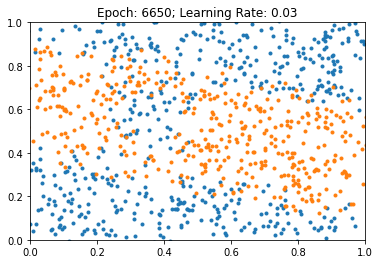

Beta-Gerade: nan
Beta-AND: nan


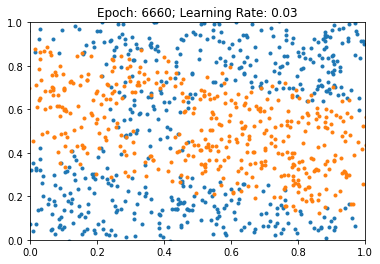

Beta-Gerade: nan
Beta-AND: nan


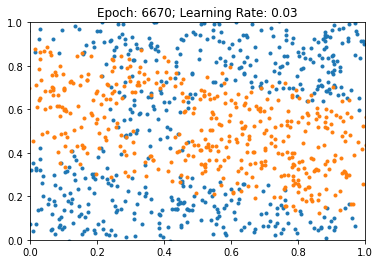

Beta-Gerade: nan
Beta-AND: nan


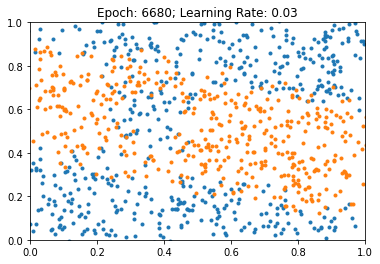

Beta-Gerade: nan
Beta-AND: nan


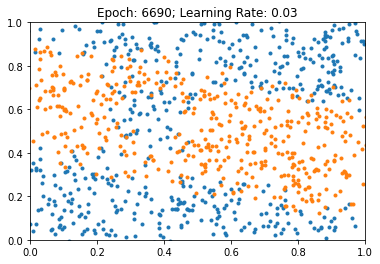

Beta-Gerade: nan
Beta-AND: nan


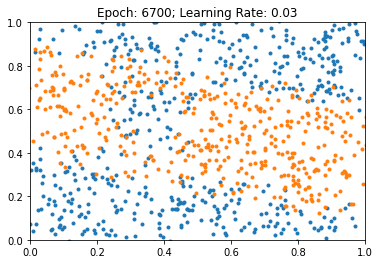

Beta-Gerade: nan
Beta-AND: nan


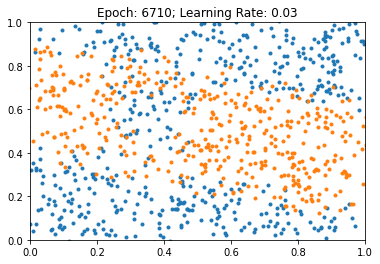

Beta-Gerade: nan
Beta-AND: nan


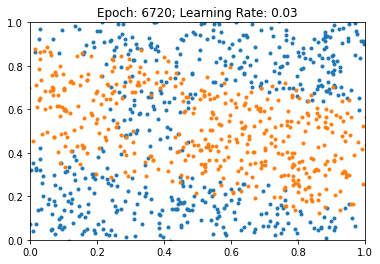

Beta-Gerade: nan
Beta-AND: nan


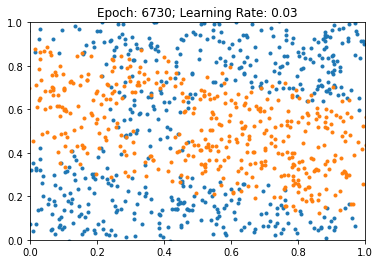

Beta-Gerade: nan
Beta-AND: nan


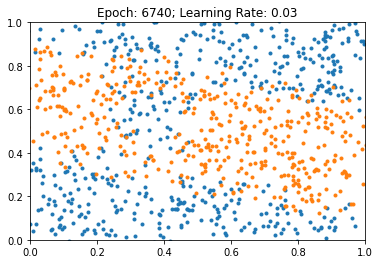

Beta-Gerade: nan
Beta-AND: nan


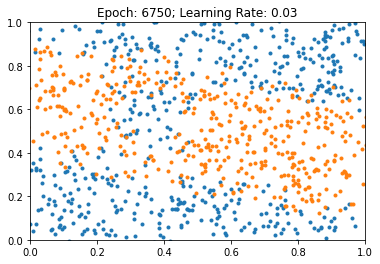

Beta-Gerade: nan
Beta-AND: nan


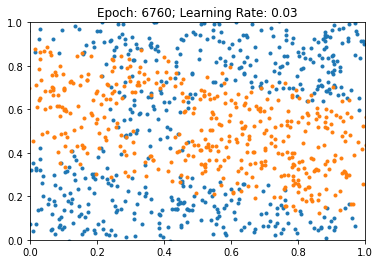

Beta-Gerade: nan
Beta-AND: nan


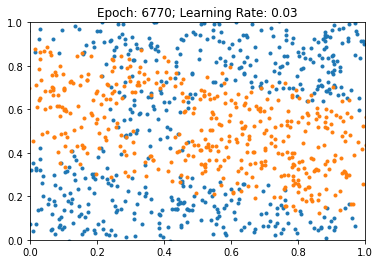

Beta-Gerade: nan
Beta-AND: nan


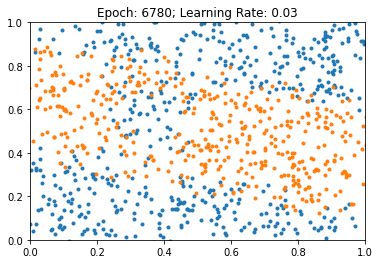

Beta-Gerade: nan
Beta-AND: nan


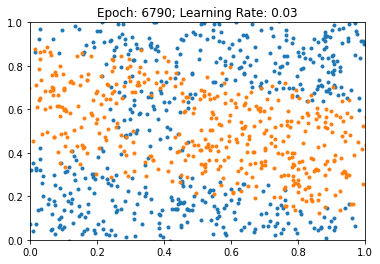

Beta-Gerade: nan
Beta-AND: nan


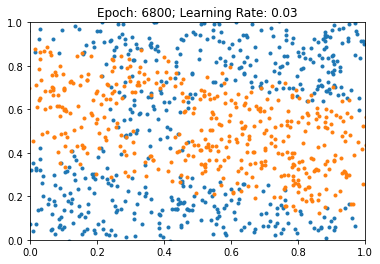

Beta-Gerade: nan
Beta-AND: nan


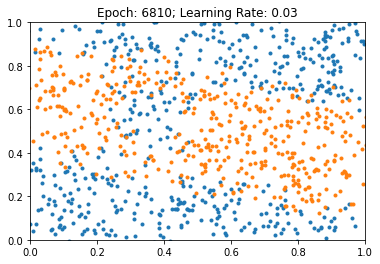

Beta-Gerade: nan
Beta-AND: nan


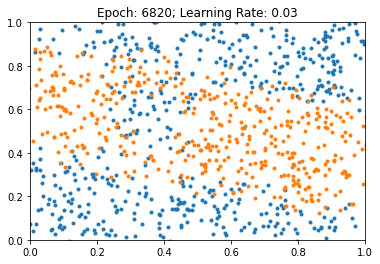

Beta-Gerade: nan
Beta-AND: nan


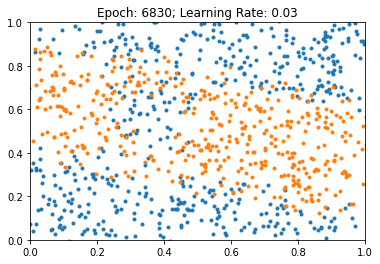

Beta-Gerade: nan
Beta-AND: nan


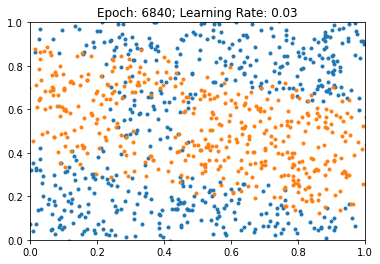

Beta-Gerade: nan
Beta-AND: nan


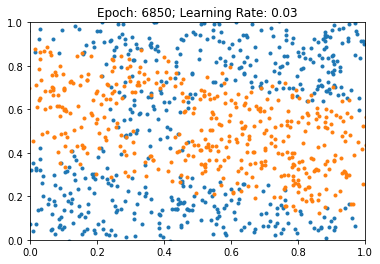

Beta-Gerade: nan
Beta-AND: nan


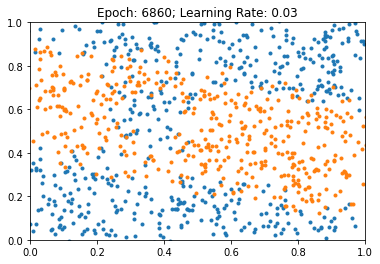

Beta-Gerade: nan
Beta-AND: nan


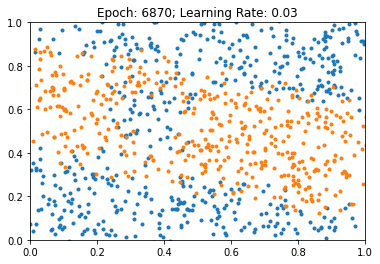

Beta-Gerade: nan
Beta-AND: nan


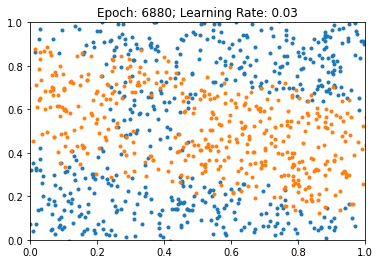

Beta-Gerade: nan
Beta-AND: nan


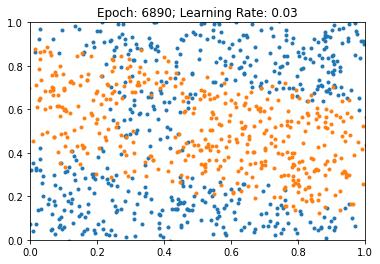

Beta-Gerade: nan
Beta-AND: nan


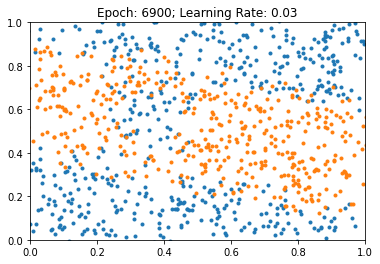

Beta-Gerade: nan
Beta-AND: nan


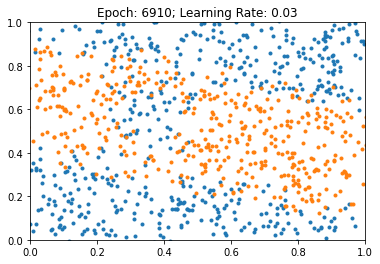

Beta-Gerade: nan
Beta-AND: nan


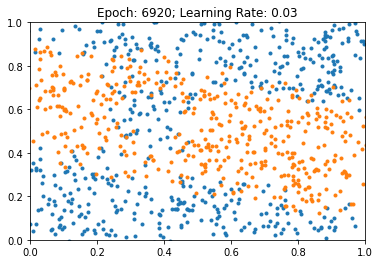

Beta-Gerade: nan
Beta-AND: nan


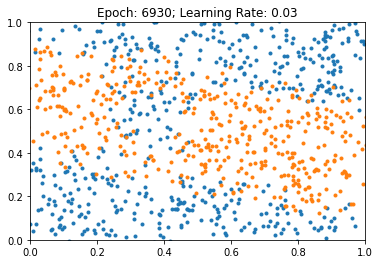

Beta-Gerade: nan
Beta-AND: nan


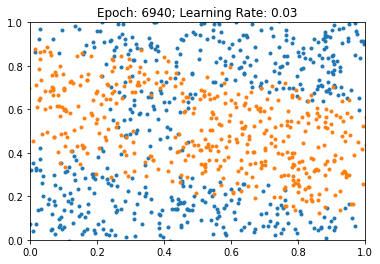

Beta-Gerade: nan
Beta-AND: nan


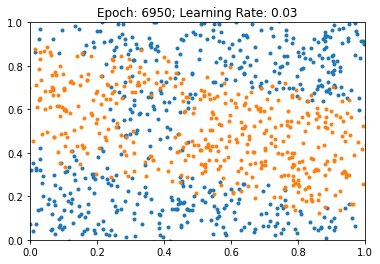

Beta-Gerade: nan
Beta-AND: nan


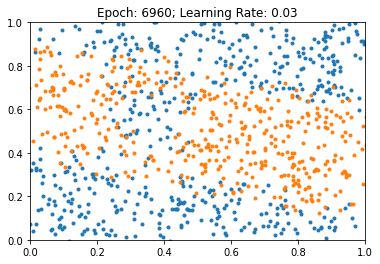

Beta-Gerade: nan
Beta-AND: nan


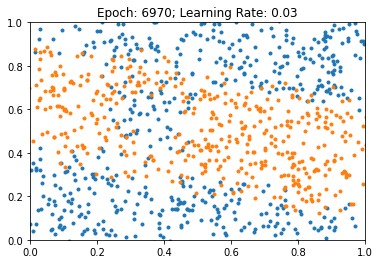

Beta-Gerade: nan
Beta-AND: nan


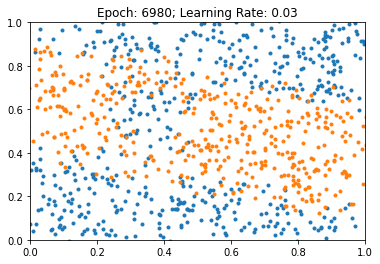

Beta-Gerade: nan
Beta-AND: nan


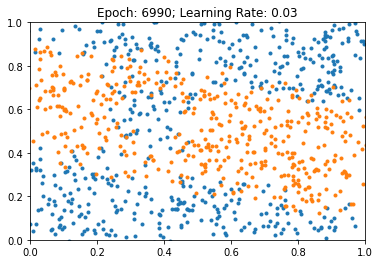

Beta-Gerade: nan
Beta-AND: nan


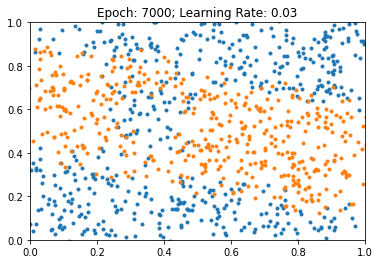

Beta-Gerade: nan
Beta-AND: nan


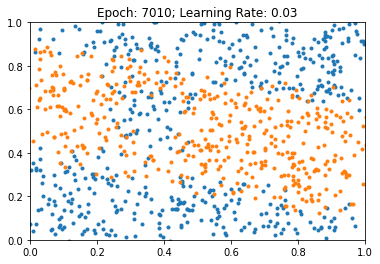

Beta-Gerade: nan
Beta-AND: nan


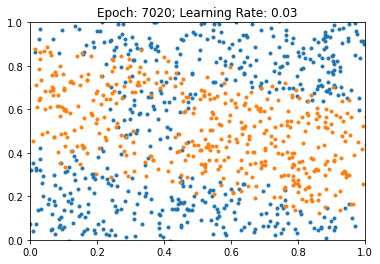

Beta-Gerade: nan
Beta-AND: nan


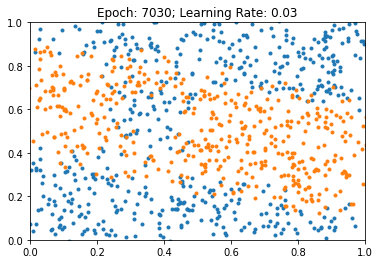

Beta-Gerade: nan
Beta-AND: nan


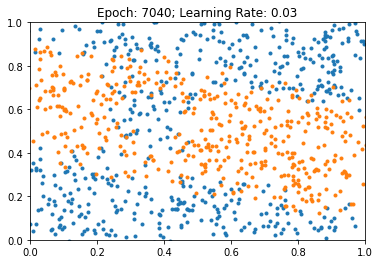

Beta-Gerade: nan
Beta-AND: nan


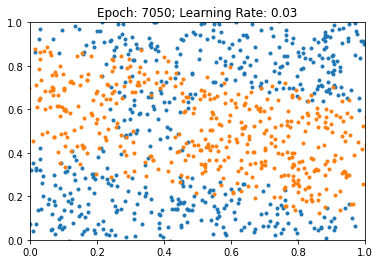

Beta-Gerade: nan
Beta-AND: nan


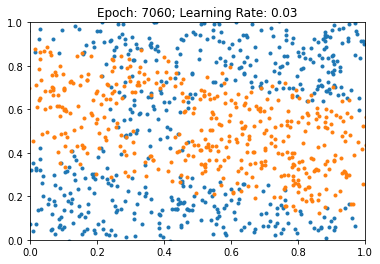

Beta-Gerade: nan
Beta-AND: nan


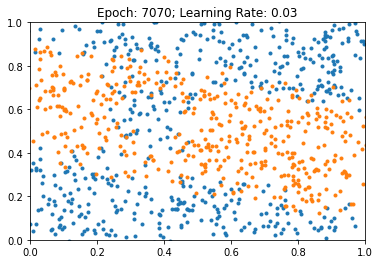

Beta-Gerade: nan
Beta-AND: nan


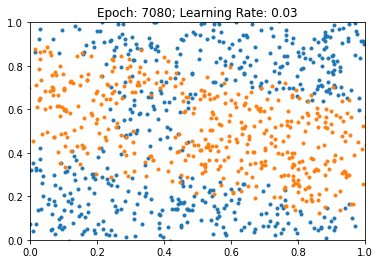

Beta-Gerade: nan
Beta-AND: nan


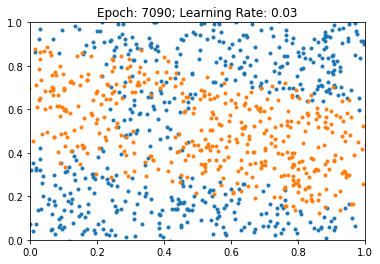

Beta-Gerade: nan
Beta-AND: nan


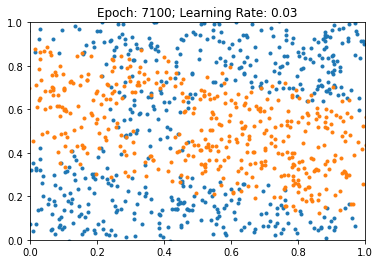

Beta-Gerade: nan
Beta-AND: nan


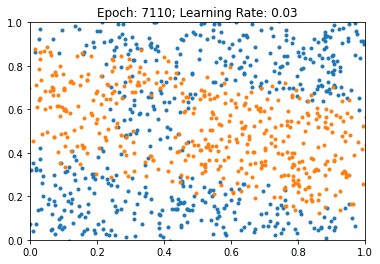

Beta-Gerade: nan
Beta-AND: nan


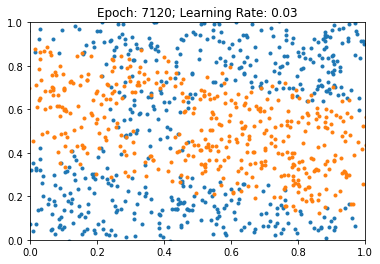

Beta-Gerade: nan
Beta-AND: nan


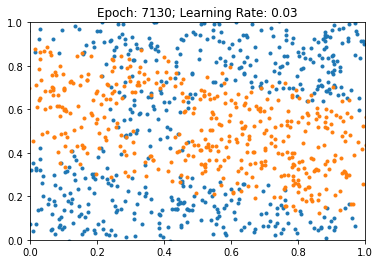

Beta-Gerade: nan
Beta-AND: nan


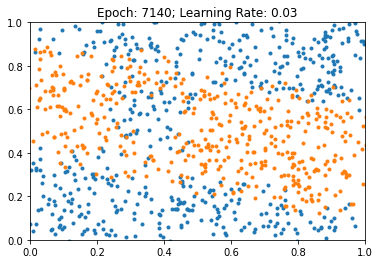

Beta-Gerade: nan
Beta-AND: nan


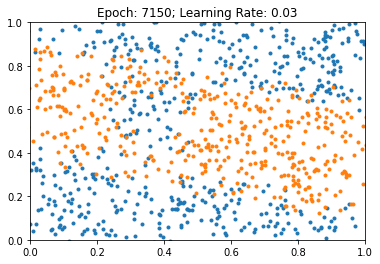

Beta-Gerade: nan
Beta-AND: nan


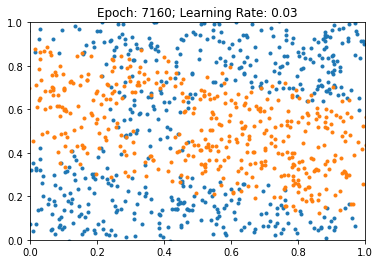

Beta-Gerade: nan
Beta-AND: nan


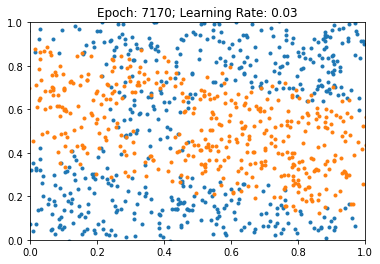

Beta-Gerade: nan
Beta-AND: nan


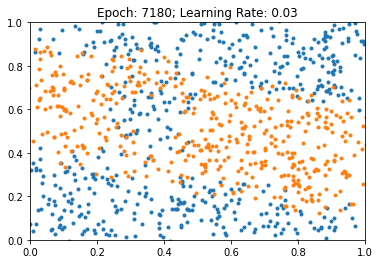

Beta-Gerade: nan
Beta-AND: nan


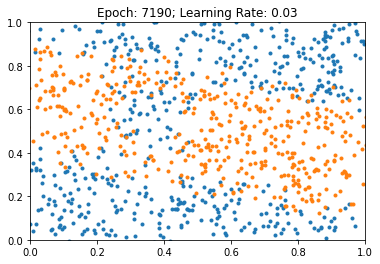

Beta-Gerade: nan
Beta-AND: nan


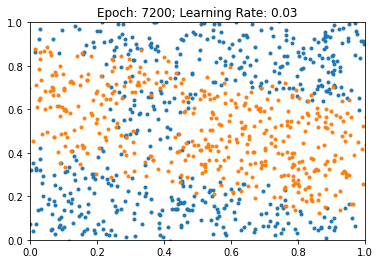

Beta-Gerade: nan
Beta-AND: nan


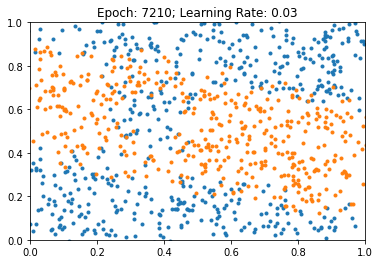

Beta-Gerade: nan
Beta-AND: nan


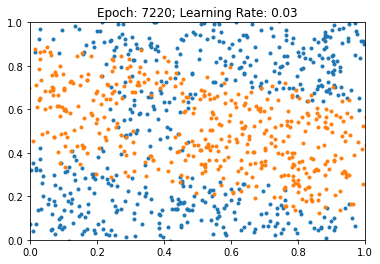

Beta-Gerade: nan
Beta-AND: nan


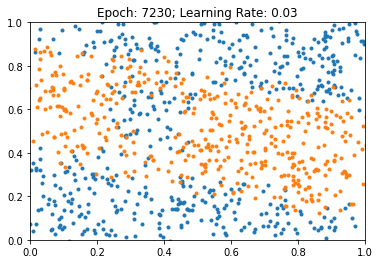

Beta-Gerade: nan
Beta-AND: nan


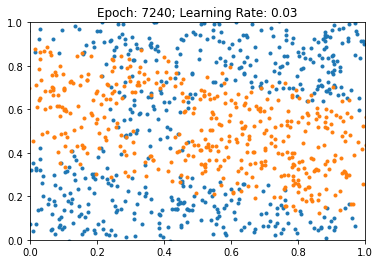

Beta-Gerade: nan
Beta-AND: nan


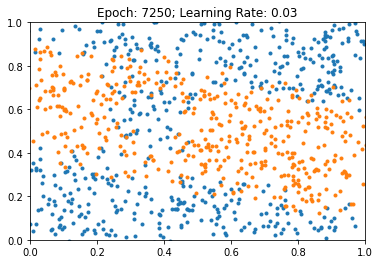

Beta-Gerade: nan
Beta-AND: nan


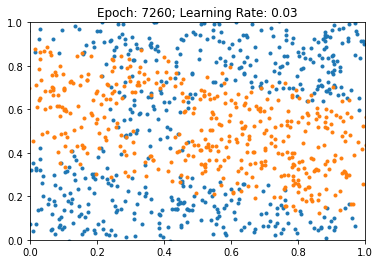

Beta-Gerade: nan
Beta-AND: nan


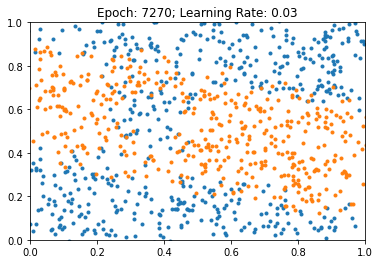

Beta-Gerade: nan
Beta-AND: nan


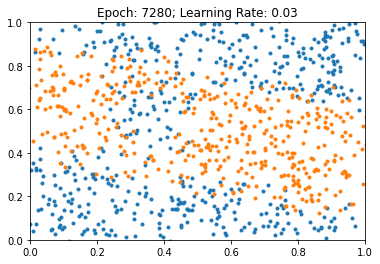

Beta-Gerade: nan
Beta-AND: nan


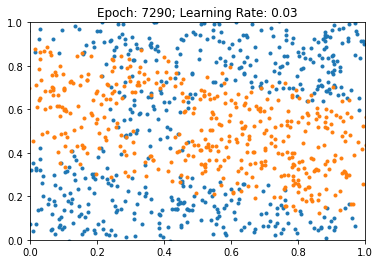

Beta-Gerade: nan
Beta-AND: nan


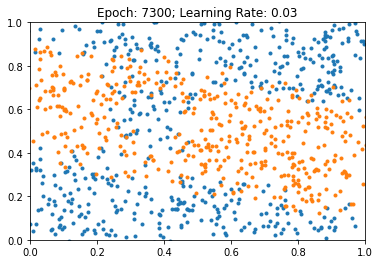

Beta-Gerade: nan
Beta-AND: nan


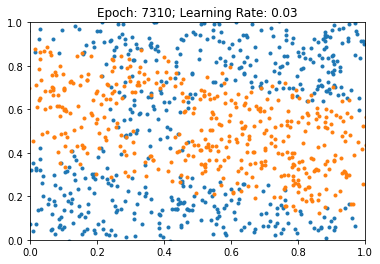

Beta-Gerade: nan
Beta-AND: nan


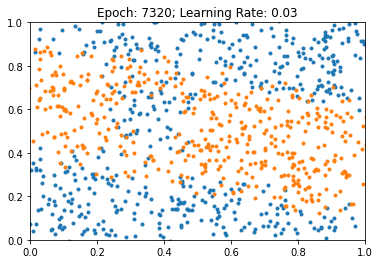

Beta-Gerade: nan
Beta-AND: nan


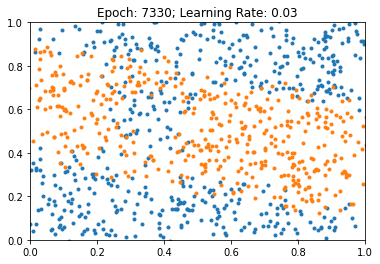

Beta-Gerade: nan
Beta-AND: nan


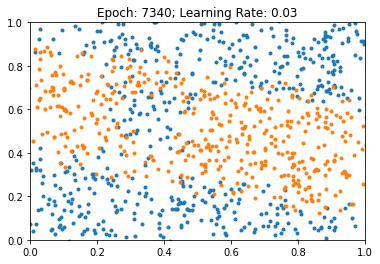

Beta-Gerade: nan
Beta-AND: nan


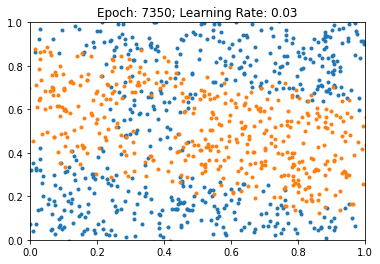

Beta-Gerade: nan
Beta-AND: nan


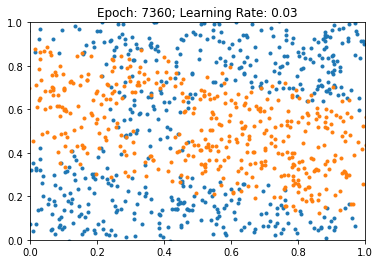

Beta-Gerade: nan
Beta-AND: nan


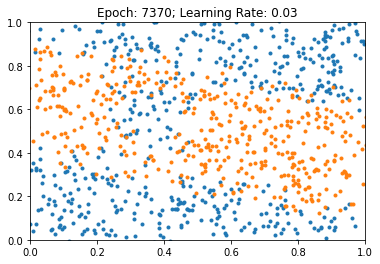

Beta-Gerade: nan
Beta-AND: nan


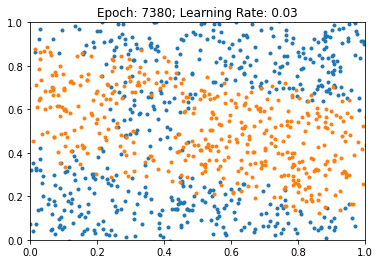

Beta-Gerade: nan
Beta-AND: nan


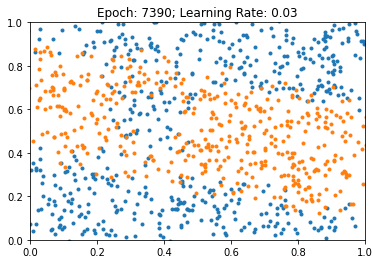

Beta-Gerade: nan
Beta-AND: nan


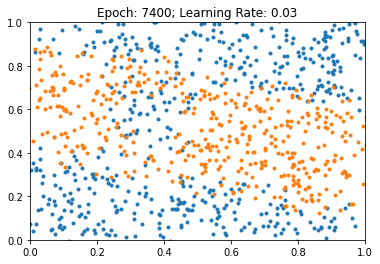

Beta-Gerade: nan
Beta-AND: nan


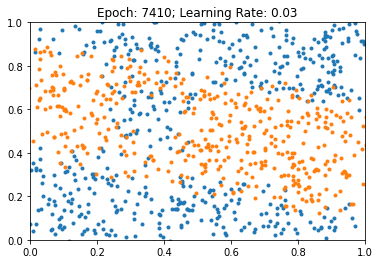

Beta-Gerade: nan
Beta-AND: nan


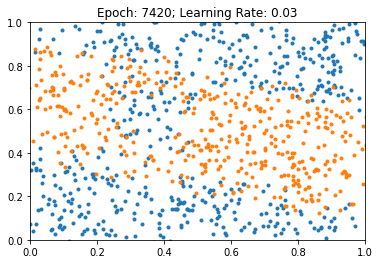

Beta-Gerade: nan
Beta-AND: nan


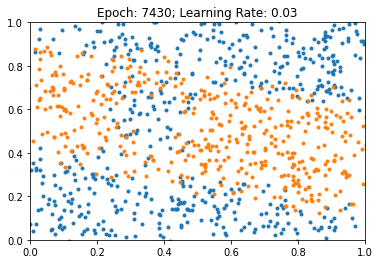

Beta-Gerade: nan
Beta-AND: nan


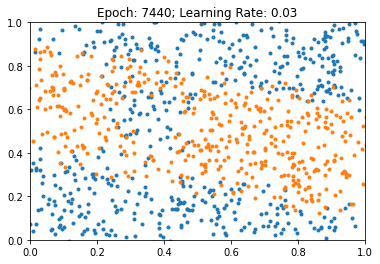

Beta-Gerade: nan
Beta-AND: nan


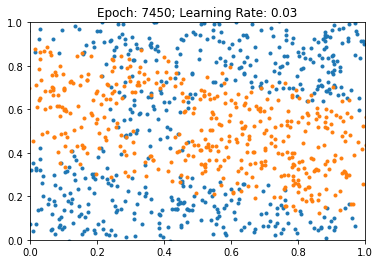

Beta-Gerade: nan
Beta-AND: nan


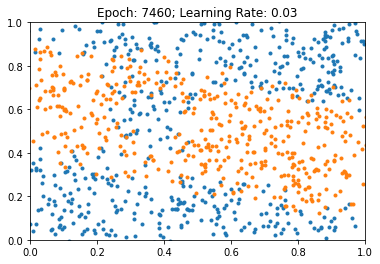

Beta-Gerade: nan
Beta-AND: nan


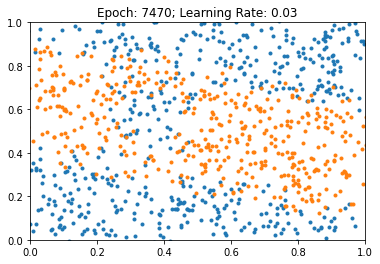

Beta-Gerade: nan
Beta-AND: nan


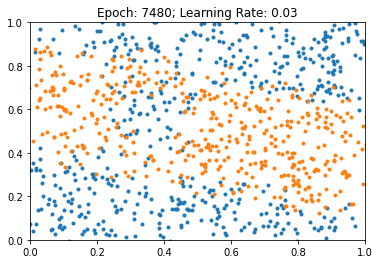

Beta-Gerade: nan
Beta-AND: nan


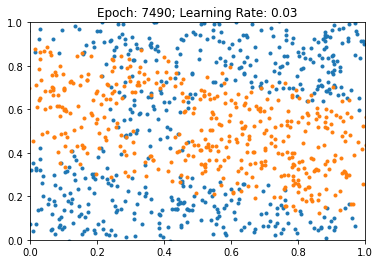

Beta-Gerade: nan
Beta-AND: nan


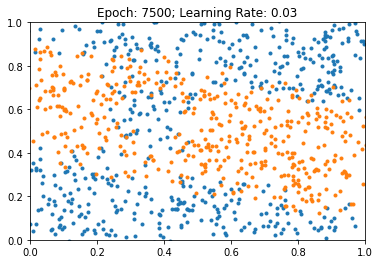

Beta-Gerade: nan
Beta-AND: nan


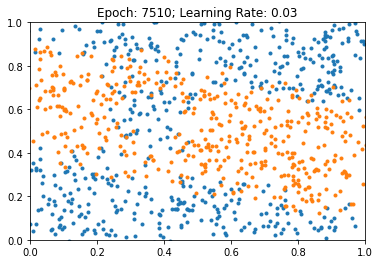

Beta-Gerade: nan
Beta-AND: nan


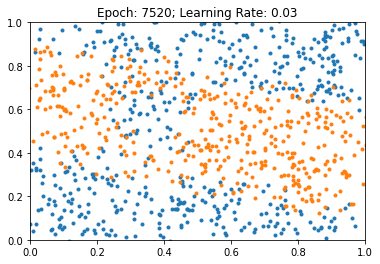

Beta-Gerade: nan
Beta-AND: nan


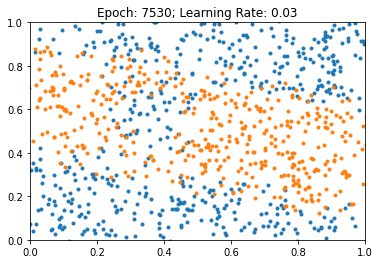

Beta-Gerade: nan
Beta-AND: nan


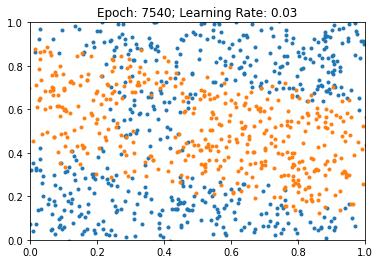

Beta-Gerade: nan
Beta-AND: nan


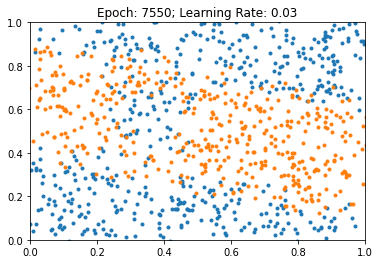

Beta-Gerade: nan
Beta-AND: nan


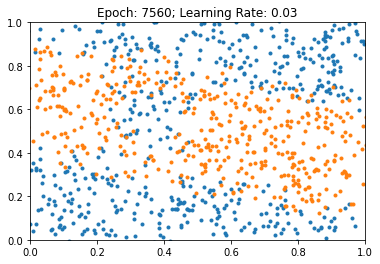

Beta-Gerade: nan
Beta-AND: nan


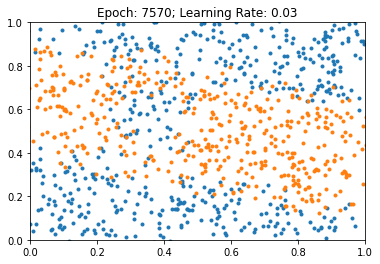

Beta-Gerade: nan
Beta-AND: nan


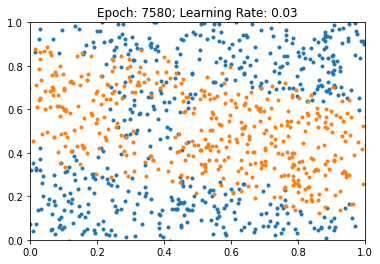

Beta-Gerade: nan
Beta-AND: nan


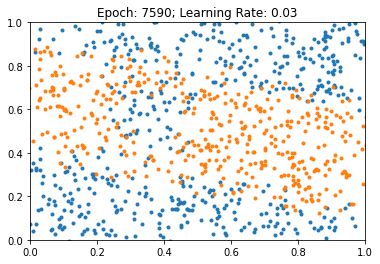

Beta-Gerade: nan
Beta-AND: nan


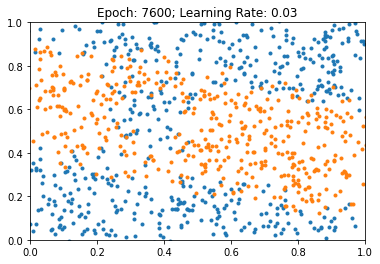

Beta-Gerade: nan
Beta-AND: nan


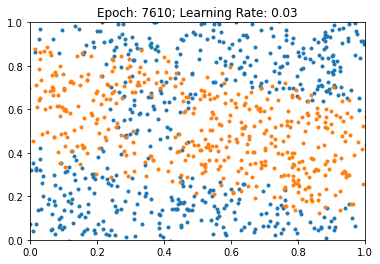

Beta-Gerade: nan
Beta-AND: nan


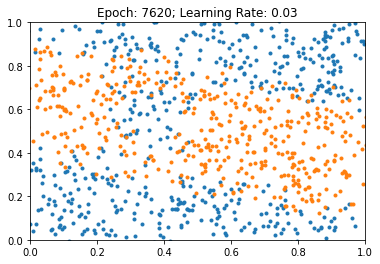

Beta-Gerade: nan
Beta-AND: nan


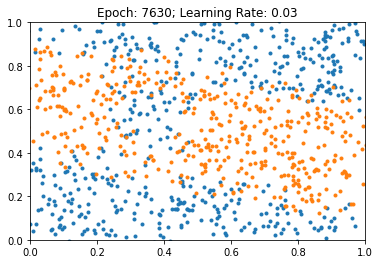

Beta-Gerade: nan
Beta-AND: nan


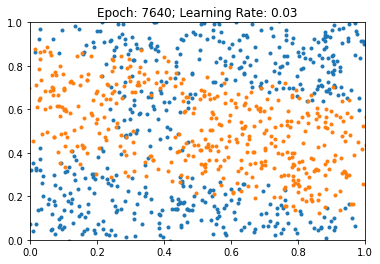

Beta-Gerade: nan
Beta-AND: nan


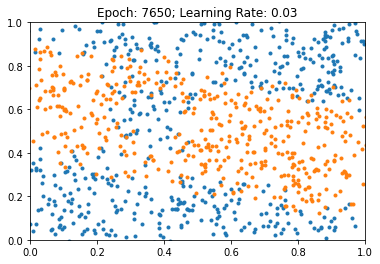

Beta-Gerade: nan
Beta-AND: nan


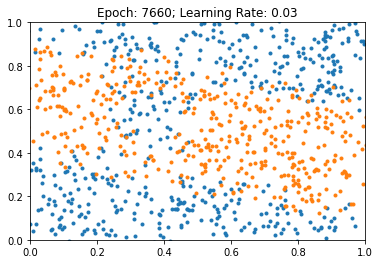

Beta-Gerade: nan
Beta-AND: nan


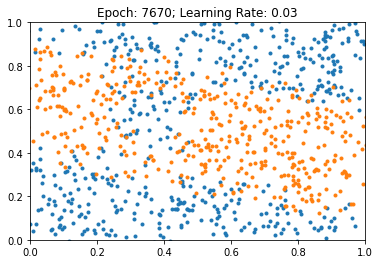

Beta-Gerade: nan
Beta-AND: nan


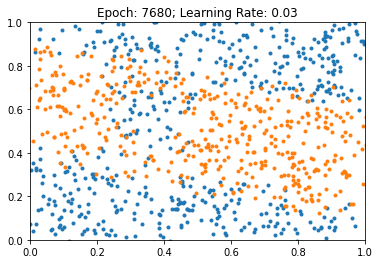

Beta-Gerade: nan
Beta-AND: nan


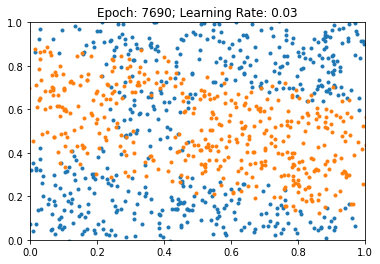

Beta-Gerade: nan
Beta-AND: nan


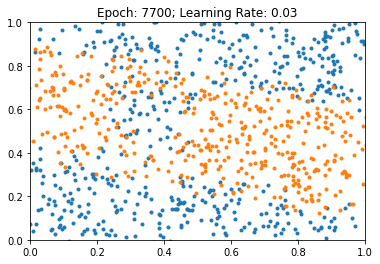

Beta-Gerade: nan
Beta-AND: nan


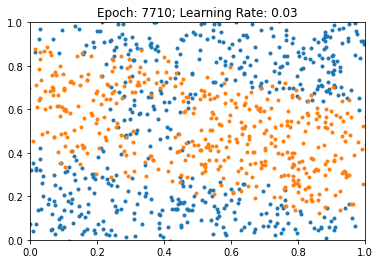

Beta-Gerade: nan
Beta-AND: nan


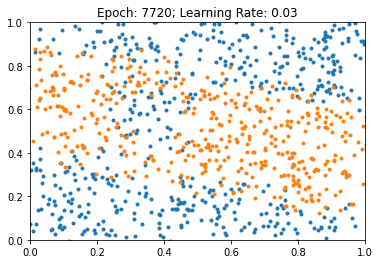

Beta-Gerade: nan
Beta-AND: nan


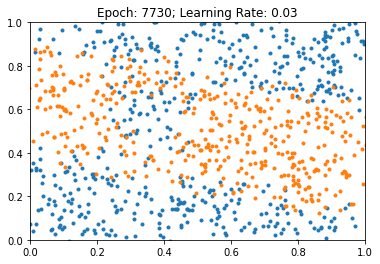

Beta-Gerade: nan
Beta-AND: nan


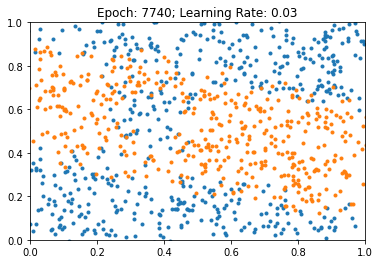

Beta-Gerade: nan
Beta-AND: nan


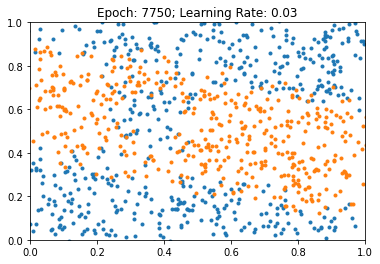

Beta-Gerade: nan
Beta-AND: nan


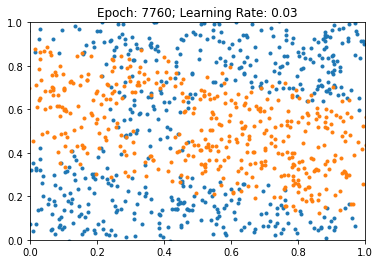

Beta-Gerade: nan
Beta-AND: nan


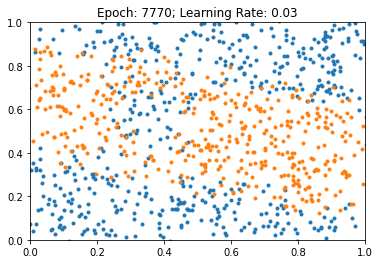

Beta-Gerade: nan
Beta-AND: nan


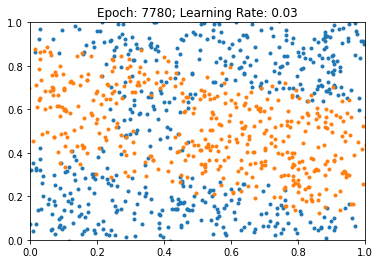

Beta-Gerade: nan
Beta-AND: nan


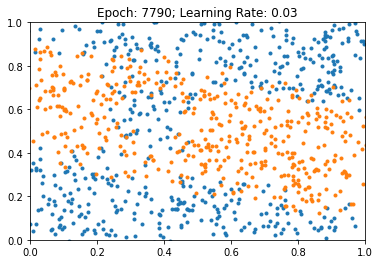

Beta-Gerade: nan
Beta-AND: nan


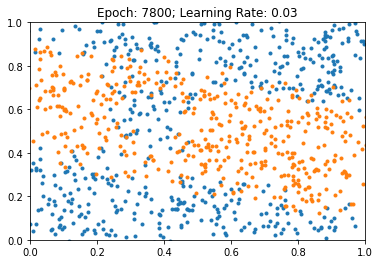

Beta-Gerade: nan
Beta-AND: nan


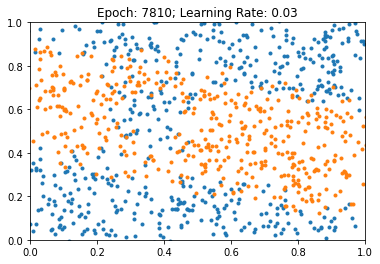

Beta-Gerade: nan
Beta-AND: nan


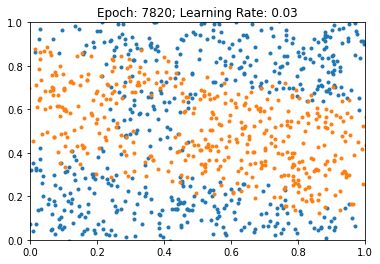

Beta-Gerade: nan
Beta-AND: nan


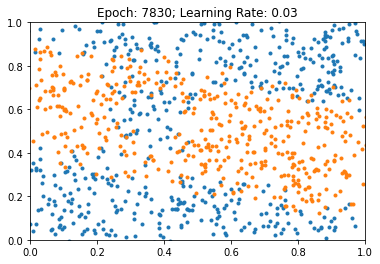

Beta-Gerade: nan
Beta-AND: nan


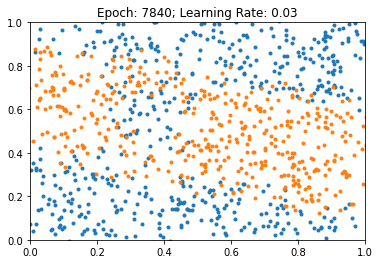

Beta-Gerade: nan
Beta-AND: nan


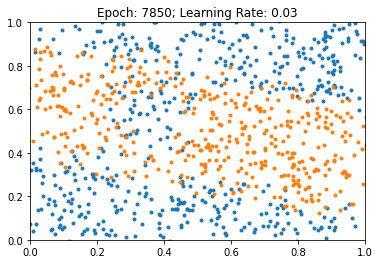

Beta-Gerade: nan
Beta-AND: nan


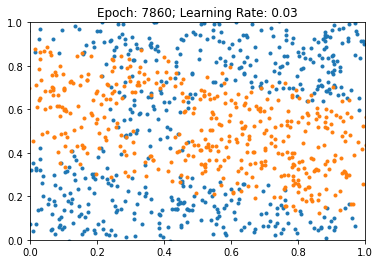

Beta-Gerade: nan
Beta-AND: nan


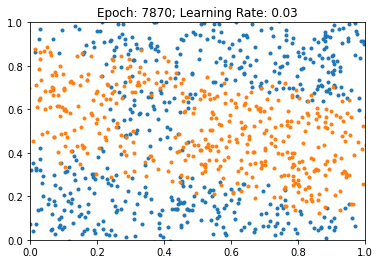

Beta-Gerade: nan
Beta-AND: nan


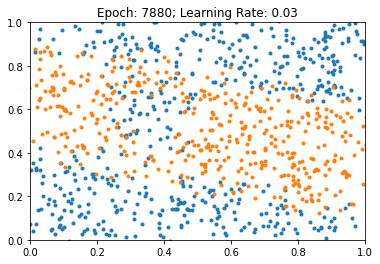

Beta-Gerade: nan
Beta-AND: nan


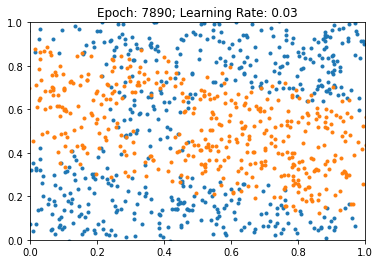

Beta-Gerade: nan
Beta-AND: nan


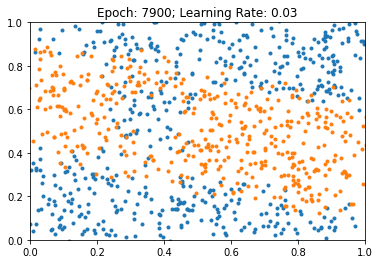

Beta-Gerade: nan
Beta-AND: nan


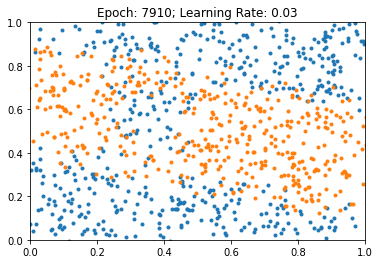

Beta-Gerade: nan
Beta-AND: nan


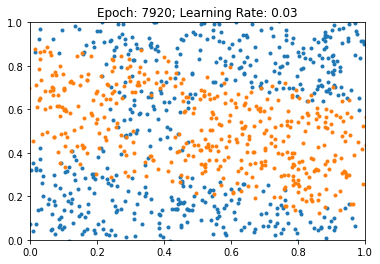

Beta-Gerade: nan
Beta-AND: nan


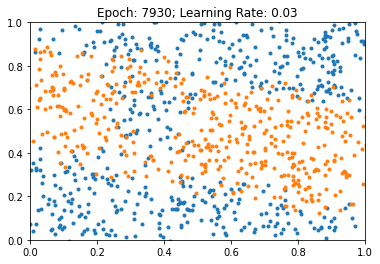

Beta-Gerade: nan
Beta-AND: nan


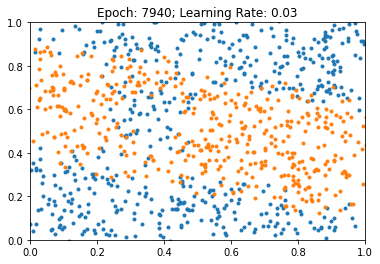

Beta-Gerade: nan
Beta-AND: nan


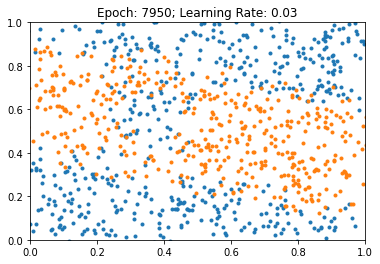

Beta-Gerade: nan
Beta-AND: nan


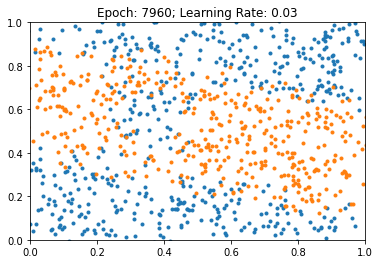

Beta-Gerade: nan
Beta-AND: nan


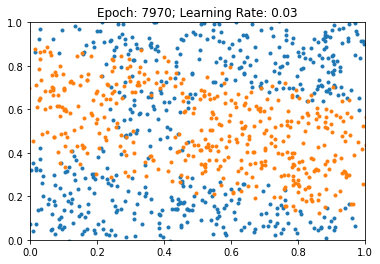

Beta-Gerade: nan
Beta-AND: nan


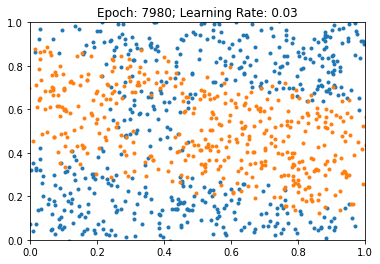

Beta-Gerade: nan
Beta-AND: nan


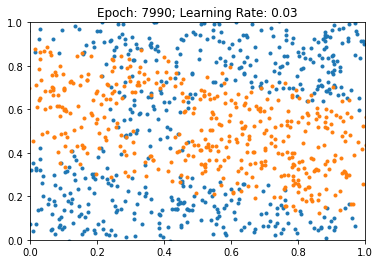

Beta-Gerade: nan
Beta-AND: nan


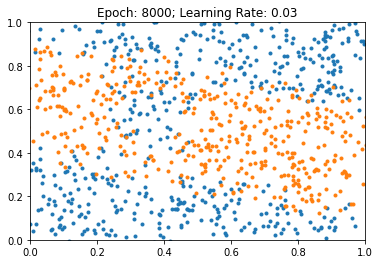

Beta-Gerade: nan
Beta-AND: nan


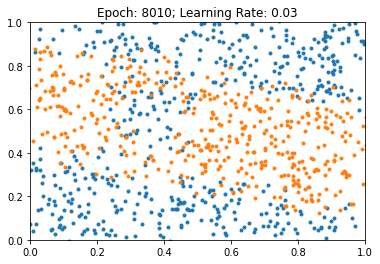

Beta-Gerade: nan
Beta-AND: nan


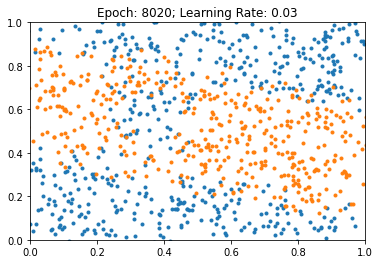

Beta-Gerade: nan
Beta-AND: nan


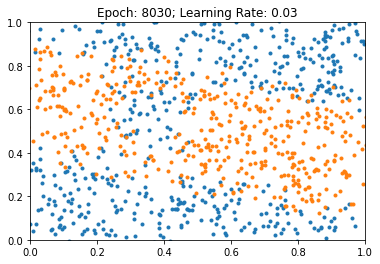

Beta-Gerade: nan
Beta-AND: nan


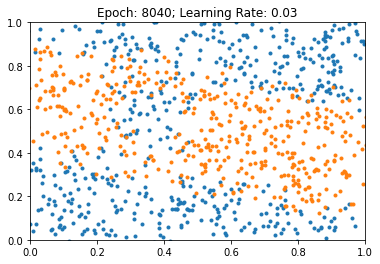

Beta-Gerade: nan
Beta-AND: nan


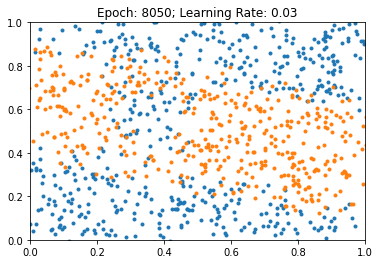

Beta-Gerade: nan
Beta-AND: nan


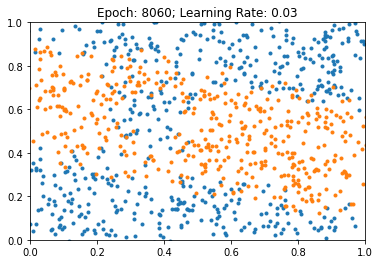

Beta-Gerade: nan
Beta-AND: nan


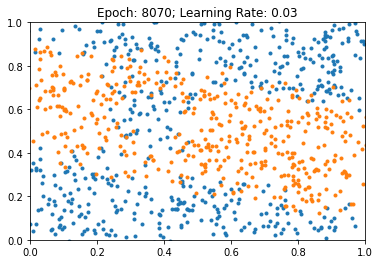

Beta-Gerade: nan
Beta-AND: nan


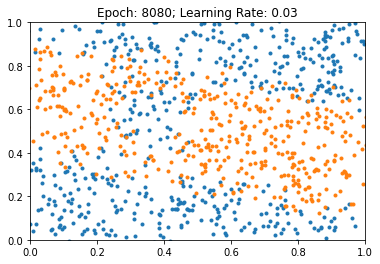

Beta-Gerade: nan
Beta-AND: nan


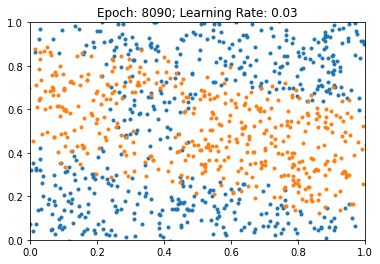

Beta-Gerade: nan
Beta-AND: nan


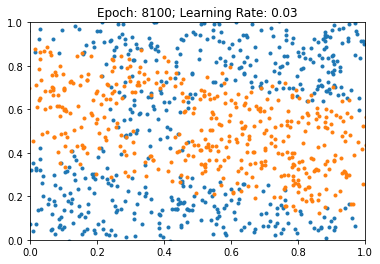

Beta-Gerade: nan
Beta-AND: nan


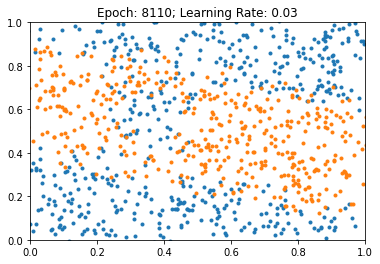

Beta-Gerade: nan
Beta-AND: nan


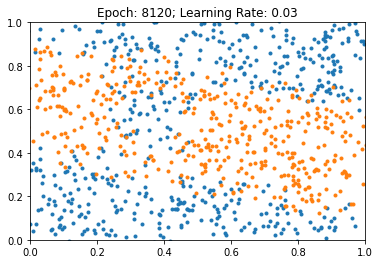

Beta-Gerade: nan
Beta-AND: nan


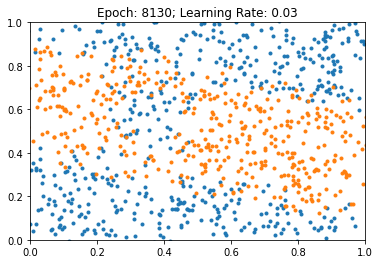

Beta-Gerade: nan
Beta-AND: nan


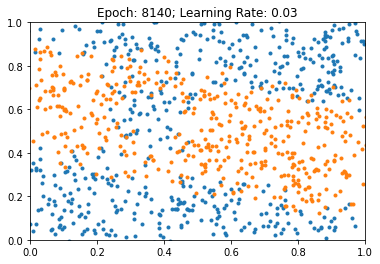

Beta-Gerade: nan
Beta-AND: nan


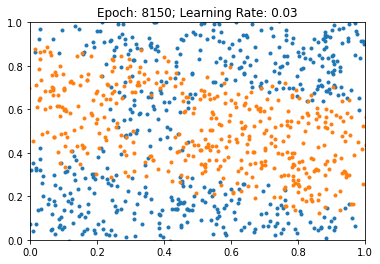

Beta-Gerade: nan
Beta-AND: nan


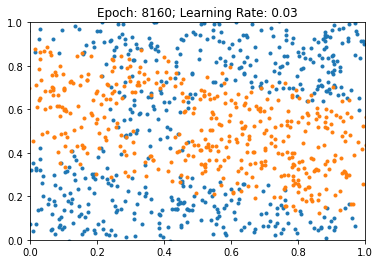

Beta-Gerade: nan
Beta-AND: nan


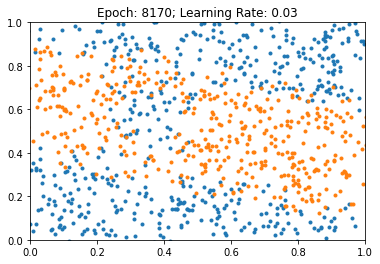

Beta-Gerade: nan
Beta-AND: nan


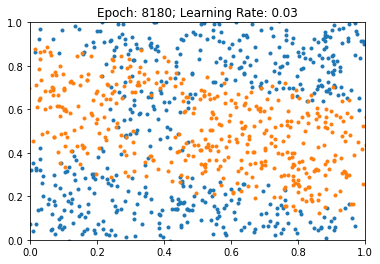

Beta-Gerade: nan
Beta-AND: nan


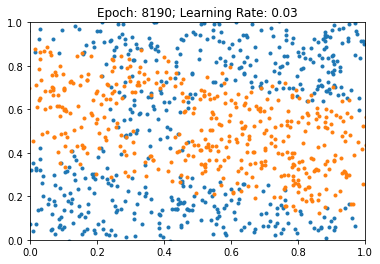

Beta-Gerade: nan
Beta-AND: nan


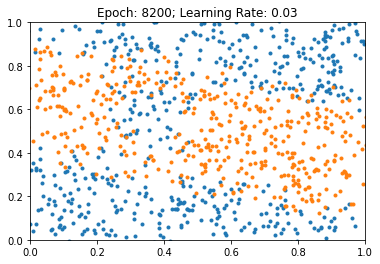

Beta-Gerade: nan
Beta-AND: nan


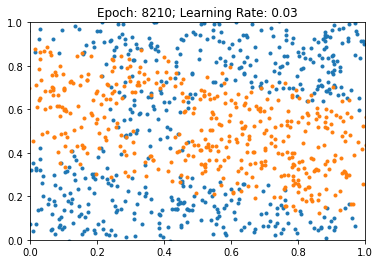

Beta-Gerade: nan
Beta-AND: nan


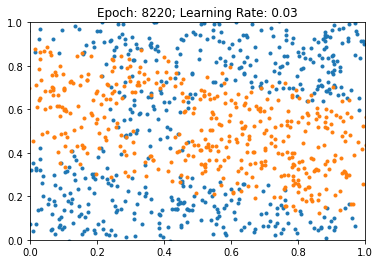

Beta-Gerade: nan
Beta-AND: nan


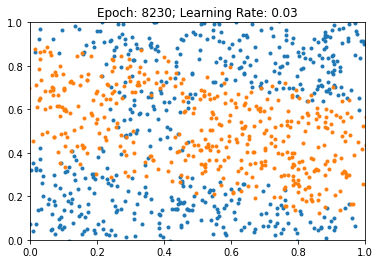

Beta-Gerade: nan
Beta-AND: nan


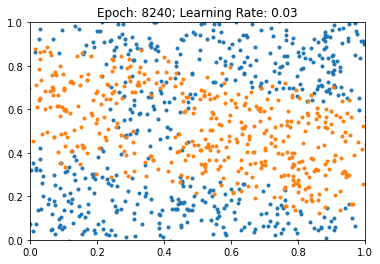

Beta-Gerade: nan
Beta-AND: nan


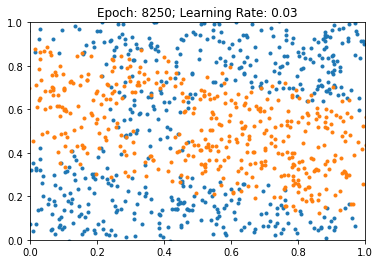

Beta-Gerade: nan
Beta-AND: nan


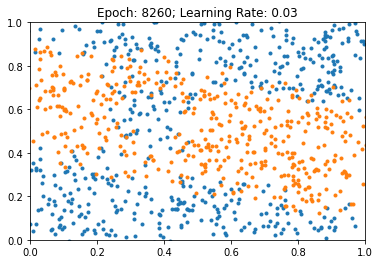

Beta-Gerade: nan
Beta-AND: nan


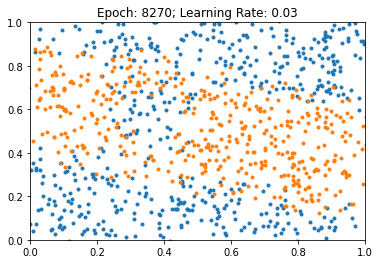

Beta-Gerade: nan
Beta-AND: nan


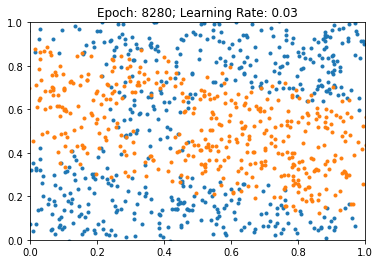

Beta-Gerade: nan
Beta-AND: nan


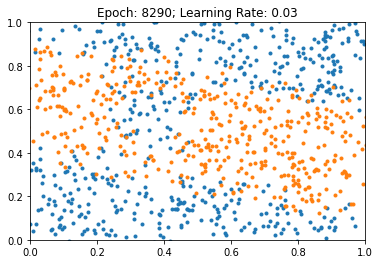

Beta-Gerade: nan
Beta-AND: nan


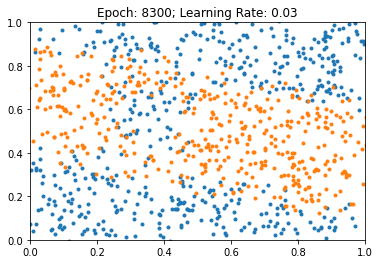

Beta-Gerade: nan
Beta-AND: nan


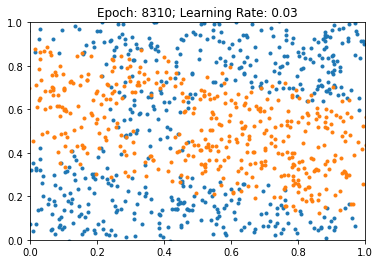

Beta-Gerade: nan
Beta-AND: nan


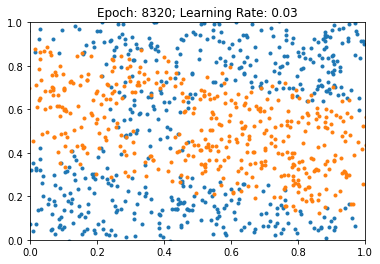

Beta-Gerade: nan
Beta-AND: nan


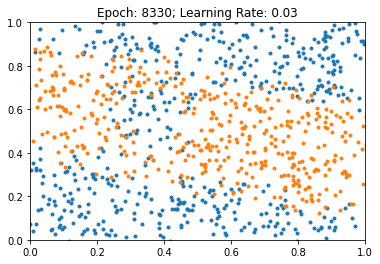

Beta-Gerade: nan
Beta-AND: nan


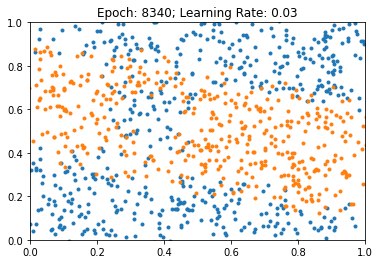

Beta-Gerade: nan
Beta-AND: nan


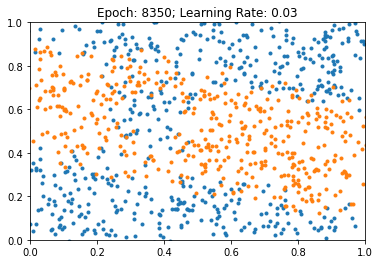

Beta-Gerade: nan
Beta-AND: nan


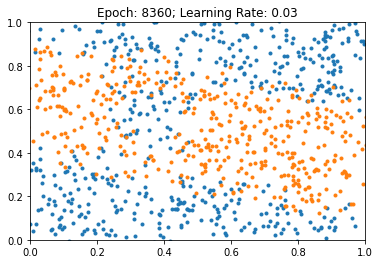

Beta-Gerade: nan
Beta-AND: nan


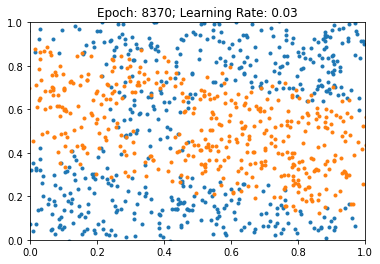

Beta-Gerade: nan
Beta-AND: nan


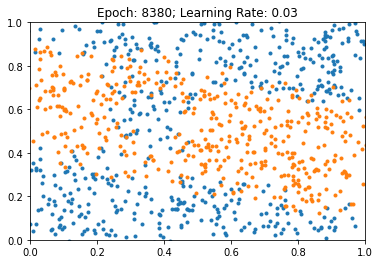

Beta-Gerade: nan
Beta-AND: nan


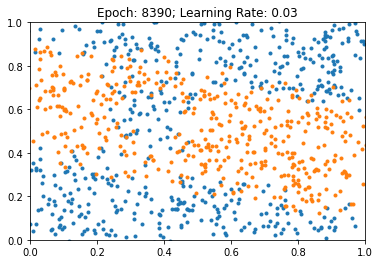

Beta-Gerade: nan
Beta-AND: nan


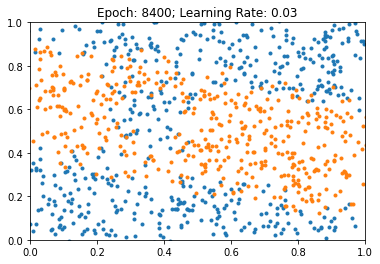

Beta-Gerade: nan
Beta-AND: nan


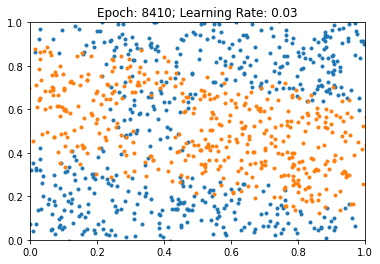

Beta-Gerade: nan
Beta-AND: nan


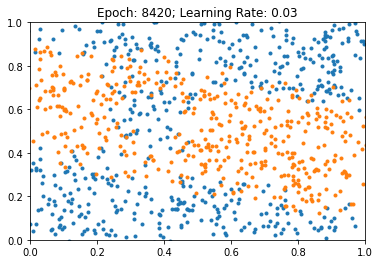

Beta-Gerade: nan
Beta-AND: nan


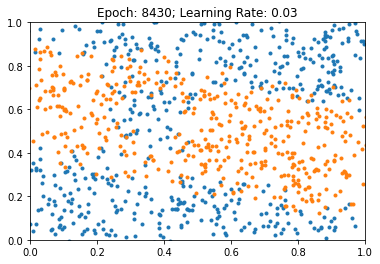

Beta-Gerade: nan
Beta-AND: nan


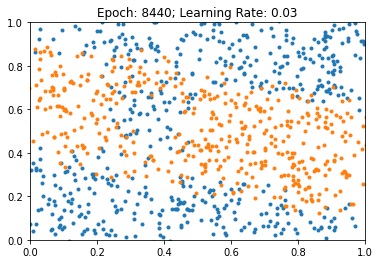

Beta-Gerade: nan
Beta-AND: nan


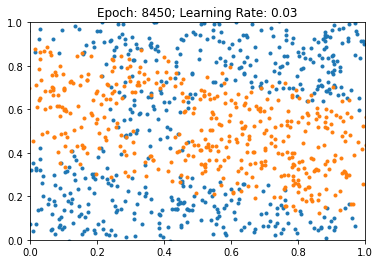

Beta-Gerade: nan
Beta-AND: nan


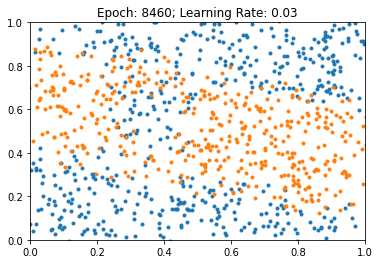

Beta-Gerade: nan
Beta-AND: nan


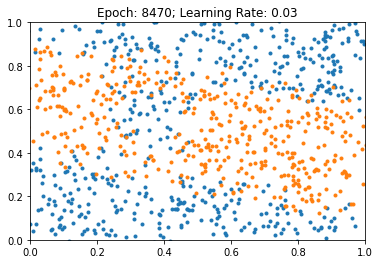

Beta-Gerade: nan
Beta-AND: nan


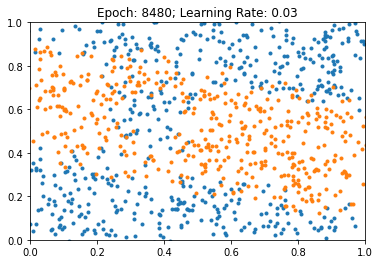

Beta-Gerade: nan
Beta-AND: nan


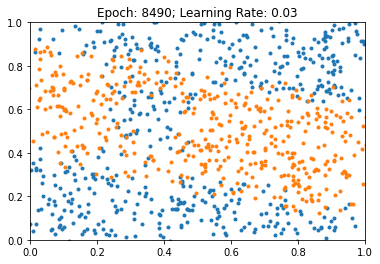

Beta-Gerade: nan
Beta-AND: nan


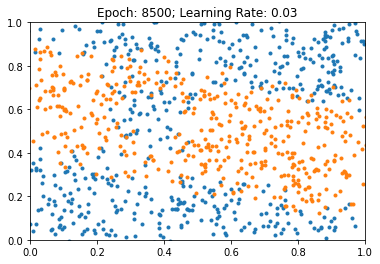

Beta-Gerade: nan
Beta-AND: nan


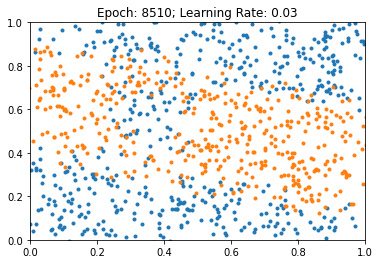

Beta-Gerade: nan
Beta-AND: nan


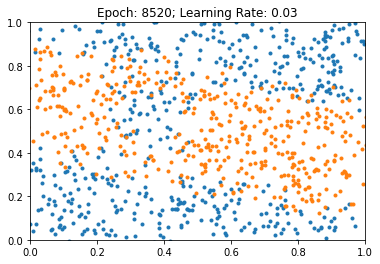

Beta-Gerade: nan
Beta-AND: nan


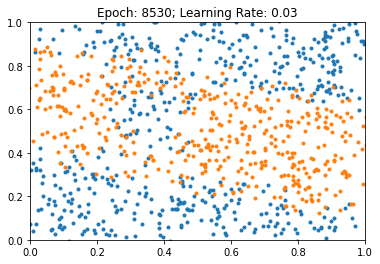

Beta-Gerade: nan
Beta-AND: nan


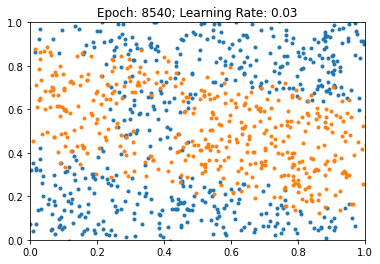

Beta-Gerade: nan
Beta-AND: nan


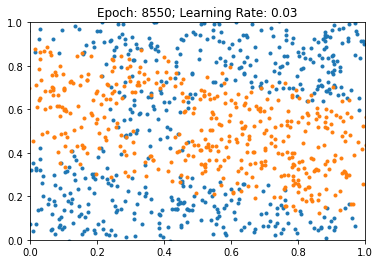

KeyboardInterrupt: ignored

In [184]:
learning_rate = 0.03
network = SimpleNetwork()
optimizer = optim.Adam(network.parameters(), lr=learning_rate)
criterion = nn.MSELoss()

x = torch.linspace(-3, 3)

for epoch in range(10001):
    preds = network(trainX)
    #print(preds)
    loss = criterion(preds, trainY) # Calculate loss
    optimizer.zero_grad()
    loss.backward() # Calculate Gradient
    optimizer.step() # Update Weights
    if epoch %10 == 0:
        
      
        y1 = -((network.linear_layer_1.weight.squeeze()[0] * x + network.linear_layer_1.bias[0]) / network.linear_layer_1.weight.squeeze()[1])
        y2 = -((network.linear_layer_2.weight.squeeze()[0] * x + network.linear_layer_2.bias[0]) / network.linear_layer_2.weight.squeeze()[1])
        y3 = -((network.linear_layer_3.weight.squeeze()[0] * x + network.linear_layer_3.bias[0]) / network.linear_layer_3.weight.squeeze()[1])
        y4 = -((network.linear_layer_4.weight.squeeze()[0] * x + network.linear_layer_4.bias[0]) / network.linear_layer_4.weight.squeeze()[1])
        
        y5 = -((network.linear_layer_5.weight.squeeze()[0] * x + network.linear_layer_5.bias[0]) / network.linear_layer_5.weight.squeeze()[1])
        y6 = -((network.linear_layer_6.weight.squeeze()[0] * x + network.linear_layer_6.bias[0]) / network.linear_layer_6.weight.squeeze()[1])
        
    
        plt.plot([i[0] for i in points if i[2] == 0], [i[1] for i in points if i[2] == 0], '.')
        plt.plot([i[0] for i in points if i[2] == 1], [i[1] for i in points if i[2] == 1], '.')

        plt.plot(x.numpy(), y1.detach().numpy(), '-')
        plt.plot(x.numpy(), y2.detach().numpy(), '-')
        plt.plot(x.numpy(), y3.detach().numpy(), '-')
        plt.plot(x.numpy(), y4.detach().numpy(), '-')
        plt.plot(x.numpy(), y5.detach().numpy(), '-')
        plt.plot(x.numpy(), y6.detach().numpy(), '-')
        #print("Beta:", betas)
        print("Beta-Gerade:", betagerade)
        print("Beta-AND:", betaand)
        plt.ylim(0,1)
        plt.xlim(0,1)
        plt.title(f'Epoch: {epoch}; Learning Rate: {learning_rate}')
        plt.show()

1*0 + 1*0 = 0
1*1 + 1*0 = 1
1*0 + 1*1 = 1
1*1 + 1*1 = 2
